## Project: Property price prediction<br>
### Project objective <br>
Need to built the model to predict property price by its features.

In [1]:
# import all packages
import pandas as pd
import numpy as np
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
import dtale
from ydata_profiling import ProfileReport
import json
import ast
import pdb
import re
import plotly.express as px
import math
import pdb
from uszipcode import SearchEngine
from geopy.geocoders import Nominatim
from geopy.distance import geodesic
from geopy.extra.rate_limiter import RateLimiter
import os
random_seed = 42
from sklearn.feature_selection import f_classif, mutual_info_classif, f_regression, RFE, SelectFromModel, RFECV
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score, median_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, ElasticNet, SGDRegressor, Ridge
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, IsolationForest, StackingRegressor, BaggingRegressor

from category_encoders.ordinal import OrdinalEncoder
from category_encoders.woe import WOEEncoder
from category_encoders.target_encoder import TargetEncoder
from category_encoders.sum_coding import SumEncoder
from category_encoders.m_estimate import MEstimateEncoder
from category_encoders.leave_one_out import LeaveOneOutEncoder
from category_encoders.helmert import HelmertEncoder
from category_encoders.cat_boost import CatBoostEncoder
from category_encoders.james_stein import JamesSteinEncoder
from category_encoders import CountEncoder, HashingEncoder, BinaryEncoder
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from sklearn.covariance import EllipticEnvelope
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from scipy.stats import spearmanr
import time
import gc


pd.options.display.float_format = "{:.3f}".format

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

In [270]:
!pip freeze > requirements.txt

### Functions

In [2]:
# prepare all needed functions
def tukey_outlier(data, col, log_scale=False, m=1):
    """
    Performs Tukey's outlier detection on a specified column of a dataframe.

    Args:
        data (DataFrame): The input dataframe.
        col (str): The column where outliers need to be detected.
        m (int): Number to add before log rescaling

    Returns:
        DataFrame: Outliers that fall outside the outlier borders, 25, 75 percentile, IQR and outlier borders
    """
    if log_scale:
        x = np.log(data[col]+m)
        print('Outliers are detected in log scale')
    else:
        x = data[col]
    Q1 = x.quantile(0.25)
    Q3 = x.quantile(0.75)
    IQR = Q3-Q1
    lb = Q1 - 1.5*IQR
    hb = Q3 + 1.5*IQR
    print(
        '25 percentile: {},'.format(Q1),
        '75 percentile: {},'.format(Q3),
        "IQR: {}, ".format(IQR),
        "Outlier borders: [{lb}, {hb}].".format(lb=lb, hb=hb))
    outliers = data[(x < lb) | (x > hb)]
    return outliers


def outliers_z_score(data, feature, log_scale=False, m=1):
    """
    Performs z-score outlier detection on a specified column of a dataframe.

    Args:
        data (DataFrame): The input dataframe.
        feature (str): The column where outliers need to be detected.
        log_scale (bool): If True, search for outliers in log scale.
        m (int): Number to add before log rescaling

    Returns:
        DataFrame: Outliers that fall outside the lower and upper outlier bounds, lower & upper outlier bound
    """
    if log_scale:
        x = np.log(data[feature]+m)
        print('Outliers are detected in log scale')
    else:
        x = data[feature]
    mu = x.mean()
    sigma = x.std()
    lower_bound = mu - 3 * sigma
    upper_bound = mu + 3 * sigma
    outliers = data[(x < lower_bound) | (x > upper_bound)]
    print (f'z score lower bound {lower_bound}')
    print(f'z score upper bound {upper_bound}')
    return outliers


def distribution(data, col, n=20, m=1):
    """
    Plots the histogram and boxplot of a specified column in a dataframe.

    Args:
        data (DataFrame): The input dataframe.
        col (str): The column to plot.
        n (int): Number of bins in the histogram.
        m (int): Number to add before log rescaling
    """
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 8))

    # Plot histogram with normal values
    histplot1 = sns.histplot(data=data, x=col, bins=n, ax=axes[0, 0])
    histplot1.set_title(f'{col} distribution')

    # Plot histogram with log-transformed values
    histplot2 = sns.histplot(data=data, x=np.log(data[col]+m), bins=n, ax=axes[1, 0])
    histplot2.set_title(f'log scale {col} distribution')

    # Plot boxplot with normal values
    boxplot1 = sns.boxplot(data=data, x=col, ax=axes[0, 1])
    boxplot1.set_title(f'{col} boxplot')

    # Plot boxplot with log-transformed values
    boxplot2 = sns.boxplot(data=data, x=np.log(data[col]+m), ax=axes[1, 1])
    boxplot2.set_title(f'log scale {col} boxplot')

    # Fix layout
    plt.tight_layout()

    # Show the plots
    plt.show()

def outlier_analysis(data, column, m=1, n=100):
    """
    Perform an outlier analysis in a specified column in a dataframe.

    Args:
        data (DataFrame): The input dataframe.
        column (str): The column where outliers need to be detected.
        n (int): Number of bins in the histogram.
        m (int): Number to add before log rescaling
    """
    outl_tukey = tukey_outlier(data, column, log_scale=False, m=m)
    print(f'Number of Tukey outliers in {column} column - {outl_tukey.shape[0]}')
    print('')

    outl_tukey_log = tukey_outlier(data, column, log_scale=True, m=m)
    print(f'Number of Tukey outliers in log {column} column - {outl_tukey_log.shape[0]}')
    print('')

    outl_z = outliers_z_score(data, column, log_scale=False, m=m)
    print(f'Number of z score outliers in {column} column - {outl_z.shape[0]}')
    print('')

    outl_z_log = outliers_z_score(data, column, log_scale=True, m=m)
    print(f'Number of z score outliers in log {column} column - {outl_z_log.shape[0]}')
    print('')

    distribution(data, column, n=n, m=m)

    return {
        'outliers_tukey': outl_tukey,
        'outliers_tukey_log': outl_tukey_log,
        'outliers_z': outl_z,
        'outliers_z_log': outl_z_log
    }


def extract_numbers_from_string(string):
    """
    Extracts a list of integers from a string.

    Args:
        string (str): The input string.

    Returns:
        List[int]: A list of integers extracted from the string.
    """
    numbers = re.findall(r'\b\d+\b', string)
    return [int(num) for num in numbers]

def is_float(x):
    """
    Checks if a value can be converted to a float.

    Args:
        x: The value to check.

    Returns:
        bool: True if the value can be converted to a float, False otherwise.
    """
    try:
        float(x)
        return True
    except ValueError:
        return False

def get_parking_number(value):
    """
    Retrieves the parking number from a given value.

    Args:
        value: The input value to extract the parking number from.

    Returns:
        int: The parking number extracted from the value. Returns 1 if value !=0 and not null, -1 for NaN values, 
             0 for value equals to 0, and -1 for other cases where the parking number cannot be determined.
    """
    if isinstance(value, str):
        # value = str(value).strip()
        # pdb.set_trace()
        if value.isdigit():
            return int(value)
        elif is_float(value):
            return math.floor(float(value))

        # Split the string by commas and search for numbers near specific words
        parts = re.split('[,.]', value)
        numbers_list = []
        for part in parts:
            if 'car' in part or 'parking' in part or 'off street' in part:
                numbers = extract_numbers_from_string(part)
                if len(numbers) > 0:
                    numbers_list.extend(numbers)
            # search for range and get mean for range
            elif '-' in part:
                if re.match(r'\d+-\d+', part):
                    range_numbers = extract_numbers_from_string(part)
                    if len(range_numbers) > 0:
                        numbers_list.append(int(np.mean(range_numbers)))


        if len(numbers_list) > 0:
            return sum(numbers_list)
       
        elif pd.notnull(value) and value!='0' and 'no ' not in value:
            return 1
    elif pd.isna(value):
        return -1  # Return -1 instead of NaN values
    elif value == 0 or value == '0' or 'no ' in value:
        return 0  # Return 0 for value equals to 0
    return -1

def find_property_height(row):
    """
    Extracts the property height information from the 'propertyType' column in a row.

    Args:
        row (pandas.Series): A row from a pandas DataFrame containing the 'propertyType' column.

    Returns:
        str or None: The extracted property height information if found, or None if not found.

    Example:
        Given a row with 'propertyType' value '2-story house', the function will return '2 story'.
    """
    if pd.notnull(row['propertyType']):  # look for the nan's
        property_type = str(row['propertyType'])
        if 'story' in property_type:
            match = re.search(r'\d story', property_type)
            if match:
                return match.group(0)
            
        elif 'level' in property_type:
            match = re.search(r'(\w+)\s+level', property_type)
            if match:
                return match.group(0)
            
        elif 'rise' in property_type:
            match = re.search(r'(\w+)\s+rise', property_type)
            if match:
                return match.group(0)
    return None

def process_story(row):
    """
    Process the row value in the 'stories' column.

    Parameters:
        row (str or numeric): The value in the 'stories' column.

    Returns:
        str or int or float or None: The processed value based on specific conditions.

    If the row value is a string:
    - If it consists only of digits, it is returned as an integer.
    - If it is a valid floating-point number, it is returned as a float.

    If the row value is a string and meet the above conditions:
    - It is split by commas and checked for the presence of specific words ('level', 'stor', 'rise').
    - If any of these words are found, the relevant part is added to the result string.
    - The result string is returned after removing the trailing comma and space.

    If the row value is not a string or doesn't meet any of the above conditions, None is returned.

    """
    if isinstance(row, str):
        # pdb.set_trace()
        if row.isdigit():
            return int(row)
        elif is_float(row):
            return float(row)
        
        # Split the string by commas and search for numbers near specific words
        parts = str(row).split(',')
        result = ''
        for part in parts:
            if any(word in part for word in ['level', 'stor', 'rise']) or any(char.isdigit() for char in part):
                result += part.strip() + ', '
        result = result.rstrip(', ')
        if result:
            return result
    return None

def extract_story(x):
    """
    Extract the number of stories from a string.

    Parameters:
        x (str or numeric): The input value to extract the story from.

    Returns:
        int or float or str or np.nan: The extracted story value based on specific conditions.

    If the input value is a string and not null:
    - If it contains 'stor' followed by a number, the first occurrence of the number is returned as an integer.
    - If it contains ', high rise' followed by a number, the first occurrence of the number is returned as an integer.
    - If it contains 'level' followed by a number, the first occurrence of the number is returned as an integer.
    - If it is '1002.0' or '1120.0', np.nan is returned.
    - If it contains any number (integer or float), the first occurrence of the number is returned as a float.
    - If it doesn't contain any digits, np.nan is returned.

    If the input value is not a string or is null, it is returned as is.

    """
    if pd.notnull(x):
        if 'stor' in str(x) and re.findall(r'\b(\d+)\s+stor', str(x)):
            val = int(re.findall(r'\b(\d+)\s+stor', str(x))[0]) 
            return val
        elif ', high rise' in str(x) and re.findall(r'\b(\d+)\,\shigh rise', str(x)):
            val = int(re.findall(r'\b(\d+)\,\shigh rise', str(x))[0]) 
            return val
        elif 'level' in str(x) and re.findall(r'\b(\d+)\s+level', str(x)):
            val = int(re.findall(r'\b(\d+)\s+level', str(x))[0]) 
            return val
        elif '1002.0' in str(x) or '1120.0' in str(x):
            return np.nan
        elif re.findall(r'\b(\d+(?:\.\d+)?)\b', str(x)):
            val = re.findall(r'\b(\d+(?:\.\d+)?)\b', str(x))[0]
            return val
        elif not any(char.isdigit() for char in x):
            return np.nan
        return x
    return x

def property_bind(row):
    """
    Bind the 'propertyType' and 'stories' columns based on the number of stories.

    Args:
        row (pd.Series): The row containing the 'propertyType' and 'stories' values.

    Returns:
        str: The updated 'propertyType' value.
    """
    prop_type = row['propertyType']
    digit_stories = {'one': '1', 'two': '2', 'three': '3', '+': ''}
    stor = row['stories'].lower()
    
    # Replace digit words with actual digits
    for digit_word, digit in digit_stories.items():
        stor = stor.replace(digit_word, digit)
    
    # Split the string by commas and search for numbers near specific words
    parts = re.split('[,]', stor)
    result = ''
    for part in parts:
        story = None
        if is_float(part):
            story = math.floor(float(part))
        elif 'stor' in str(part) and re.findall(r'\b(\d+)\s+stor', str(part)):
            story = int(re.findall(r'\b(\d+)\s+stor', str(part))[0]) 
        # if the number of stories was found, convert it to the category
        if story is not None: 
            if 0 <= story <= 3:
                part = 'low rise'
            if 4 <= story <= 7:
                part = 'mid rise'
            if story >= 8:
                part = 'high rise'
        result += part.strip() + ', '
    # bind the stories value all together   
    result = result.rstrip(', ')
    
    # bind property type and stories
    if pd.notnull(prop_type):
        return str(prop_type) + ', ' + str(result)
    else:
        return str(result)
    
def distance(x, fn):
    all_values = []
    # Iterate over values in x
    for measure in x:
        # extract numeric values
        numeric_values = re.findall(r'\d+(?:\.\d+)?', measure)

        if numeric_values:
            numeric_values = [float(value) for value in numeric_values]
            all_values.extend(numeric_values)
    if all_values:
        return fn(all_values)
    else:
        return np.nan
    
# rating calculate given function in school_rating column
# x - school_rating column
# fn - function to calculate
# frac - indicate whether rescaling needs to be done
def rating(x, fn, frac=True):
    # Initialize variables
    all_values = []
    slash_flag = True
    # Iterate over values in x
    for val in x:
        # Check for specific string values and handle them
        if isinstance(val, str) and (val == 'NR' or val == 'None' or val == 'None/10' or val == 'NA'):
            continue
        # Split values containing '/' and append the extracted part
        if '/' in val:
            extracted_value = val.split('/')[0]
            all_values.append(extracted_value)
        else:
            all_values.append(val)
            slash_flag = False

    # Convert values to integers and filter out non-digit values
    all_values = [int(val) for val in all_values if val.isdigit()]

    # Check if the list is empty
    if not all_values:
        return np.nan

    # Perform the desired operation using the provided function
    # if frac = False convert 1-5 range to 1-10
    if not frac and not slash_flag and all(val <= 5 for val in all_values):
        new_values = [(val - 1) * 2 + 1 for val in all_values]
        return fn(new_values)
    else:
        return fn(all_values)
    
def select_n_components(var_ratio, goal_var: float) -> int:
    """
    Selects the number of components for SVD or PCA based on the explained variance ratio.
    
    Parameters:
        var_ratio (array-like): Array of explained variance ratios for each component.
        goal_var (float): Desired level of explained variance.
    
    Returns:
        int: Number of components required to achieve the desired level of explained variance.
    """
    # Set initial variance explained so far
    total_variance = 0.0
    
    # Set initial number of features
    n_components = 0
    
    # For the explained variance of each feature:
    for explained_variance in var_ratio:
        
        # Add the explained variance to the total
        total_variance += explained_variance
        
        # Add one to the number of components
        n_components += 1
        
        # If we reach our goal level of explained variance
        if total_variance >= goal_var:
            # End the loop
            break
            
    # Return the number of components
    return n_components

def print_evaluation_metrics(y_test, y_pred):
    """
    Calculates and prints evaluation metrics for model predictions.

    Parameters:
        y_test (array-like): True values of the target variable.
        y_pred (array-like): Predicted values of the target variable.
    """
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    nrmse = rmse/(y_test.max() - y_test.min())
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    meae = median_absolute_error(y_test, y_pred)
    
    print(f'{round(mse, 3)} MSE')
    print(f'{round(rmse, 3)} RMSE')
    print(f'{round(nrmse, 3)} normalized RMSE')
    print(f'{round(r2, 3)} R2 score')
    print(f'{round(mae, 3)} MAE')
    print(f'{round(mape, 3)} MAPE')
    print(f'{round(meae, 3)} MeAE')

def plot_scatter_with_regression(data: pd.DataFrame, x_col: str, y_col: str):
    """
    Plots a scatter plot with a regression line between two columns in a DataFrame.
    
    Parameters:
        - data (pd.DataFrame): The input DataFrame containing the data.
        - x_col (str): The name of the column to be plotted on the x-axis.
        - y_col (str): The name of the column to be plotted on the y-axis.
    """
    plt.figure(figsize=(12, 6))
    sns.regplot(data=data, x=x_col, y=np.log(data[y_col]), scatter_kws={'alpha': 0.2})
    plt.title(f"{x_col} & log({y_col}) correlation", fontsize=12)
    plt.ylabel('log({})'.format(y_col))
    plt.show()
    
def plot_correlation_boxplot(data: pd.DataFrame, column: str, target: str):
    """
    Creates a boxplot of the correlation between a column and the logarithm of the target variable.
    
    Parameters:
        - data (pd.DataFrame): The input DataFrame containing the data.
        - column (str): The name of the column to be plotted on the x-axis.
        - target (str): The name of the target variable column.
    """
    labels = data[column].unique()

    plt.figure(figsize=(12, 6))
    ax = sns.boxplot(y=np.log(data[target]), x=data[column])
    plt.title(f"Correlation of {column} with log({target})", fontsize=12)
    plt.xlabel(column)
    plt.ylabel("log({})".format(target))

    ax.set_xticklabels(labels, rotation=45, ha='right', rotation_mode='anchor')

    plt.show()

In [3]:
# connect google drive to load the data
# from google.colab import drive
# drive.mount('/content/drive')
# %cd drive/MyDrive/realt/

In [4]:
# read and look at the data
# link_to_data = './data.csv' # colab link
link_to_data = './data.csv/data.csv' # local link
data = pd.read_csv(link_to_data)
data.head()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"
3,for sale,NaN,single-family home,4311 Livingston Ave,8 Baths,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",yes,Dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",75205,5 Beds,TX,3.0,NaN,NaN,14191809,"$2,395,000"
4,for sale,NaN,lot/land,1524 Kiscoe St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palm Bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,32908,NaN,FL,NaN,NaN,NaN,861745,"$5,000"


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103115 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226470 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(18)
memory usa

In [6]:
# generate  data report
# profile = ProfileReport(data, title="Pandas Profiling Report")
# profile


According to the reports:<br>
- there are 49 duplicated rows in the data;
- there are 16 categorical and 2 boolean columns - private pool & PrivatePool with more than 90% missed data;
- there are 27.5% of missing data, some of nan's are in target column;
- seems like columns 'private pool', 'fireplace', 'stories', 'mls-id', 'MlsId', 'PrivatePool' have more than 30% of Nan's, maybe need to remove them;
- nan's in baths and beds columns are strongly directly correlated. Nan's in mls-id and MlsId are indirectly correlated;
- according to the missing values heatmap, seems like mls-id column has not na values in places where MlsId column has nan's. MlsId and mls-id columns could be bind;
- most of the columns (excluding private pool & state) have high cardinality so have more than 150 unique values - need a lot of EDA;
- some of features are imbalanced.

# Cleaning and Prepairing the Data

In [7]:
# remove duplicated rows
display(data.shape)
data.drop_duplicates(inplace=True)
display(data.shape)

(377185, 18)

(377135, 18)

In [8]:
# remove rows with nan values in target column
display(data.shape)
data.dropna(subset = ['target'], inplace=True)
display(data.shape)

(377135, 18)

(374655, 18)

In [9]:
# create column to indicate number of not na columns per row
data['non_na_count'] = data.count(axis=1)

In [10]:
# # generate data report to look at the data
d = dtale.show(data)
d

/home/alena/.local/lib/python3.8/site-packages/dtale/views.py:755: FutureWarning:

['status', 'private pool', 'propertyType', 'street', 'baths', 'fireplace', 'city', 'sqft', 'beds', 'stories', 'mls-id', 'PrivatePool', 'MlsId'] did not aggregate successfully. If any error is raised this will raise in a future version of pandas. Drop these columns/ops to avoid this warning.



### Format columns values acording to the data profiling above

#### Target

In [11]:
data.target.value_counts()

$225,000              1462
$275,000              1355
$250,000              1312
$350,000              1296
$299,900              1276
$325,000              1244
$249,900              1241
$399,000              1239
$199,900              1199
$299,000              1176
$375,000              1163
$450,000              1141
$499,000              1099
$175,000              1096
$425,000              1075
$599,000              1012
$265,000               992
$235,000               975
$150,000               973
$399,900               963
$285,000               952
$699,000               951
$1,000                 947
$215,000               947
$185,000               937
$165,000               936
$799,000               909
$349,900               906
$149,900               900
$300,000               892
$239,900               890
$125,000               888
$650,000               885
$475,000               872
$550,000               871
$199,000               855
$179,900               855
$

In [12]:
# look at the data
data[data.target.str.contains('mo', na=False)]['target'].value_counts()

$2,200/mo             11
$1,100/mo             11
$3,500/mo             10
$2,000/mo             10
$1,200/mo             10
$2,500/mo              9
$2,800/mo              9
$2,100/mo              9
$1,800/mo              9
$2,300/mo              7
$1,400/mo              7
$1,750/mo              7
$2,400/mo              7
$4,200/mo              6
$1,300/mo              6
$1,600/mo              6
$1,700/mo              6
$1,950/mo              6
$1,500/mo              6
$3,300/mo              6
$4,500/mo              6
$750/mo                5
$3,200/mo              5
$1,350/mo              5
$1,150/mo              5
$1,450/mo              5
$1,650/mo              5
$2,250/mo              4
$1,550/mo              4
$3,250/mo              4
$1,250/mo              4
$3,100/mo              4
$1,850/mo              4
$1,695/mo              4
$3,000/mo              4
$1,900/mo              3
$1,595/mo              3
$1,895/mo              3
$4,100/mo              3
$3,900/mo              3


In [13]:
# compare target with status rent with target with 'mo' 
subset1 = data[data['target'].str.contains('mo', na=False)]
subset2 = data[data['status'].str.contains('rent', na=False)]
comparison_result = subset1['target'].equals(subset2['target'])
comparison_result

False

In [14]:
# create a column to indcate if 'mo' was in target column, as not all monthly target have status 'rent'
data['mo_target'] = data.target.apply(lambda x: 1 if 'mo' in x else 0)
data['mo_target'].value_counts()

0    374257
1       398
Name: mo_target, dtype: int64

There is only one target value which contains '-' and range of the value, will replace it manually

In [15]:
np.mean([1.437, 1.215])

1.326

In [16]:
data.loc[data.target=='$1,215 - $1,437/mo', 'target'] = '1,326'

# replace most spread symbol in target column
target_dict = {'^\$':'',\
                '\+':'',\
                '\/mo$':'',\
                '\,+':''

    }
data.target = data.target.replace(target_dict, regex=True)

# convert column to numeric
data.target = pd.to_numeric(data.target)

25 percentile: 186990.0, 75 percentile: 582000.0, IQR: 395010.0,  Outlier borders: [-405525.0, 1174515.0].
Number of Tukey outliers in target column - 38413

Outliers are detected in log scale
25 percentile: 12.138815766336272, 75 percentile: 13.274227444925158, IQR: 1.135411678588886,  Outlier borders: [10.435698248452944, 14.977344962808488].
Number of Tukey outliers in log target column - 26747

z score lower bound -4879432.139571512
z score upper bound 6168886.471044468
Number of z score outliers in target column - 3627

Outliers are detected in log scale
z score lower bound 9.021204860974613
z score upper bound 16.25987747976213
Number of z score outliers in log target column - 6232



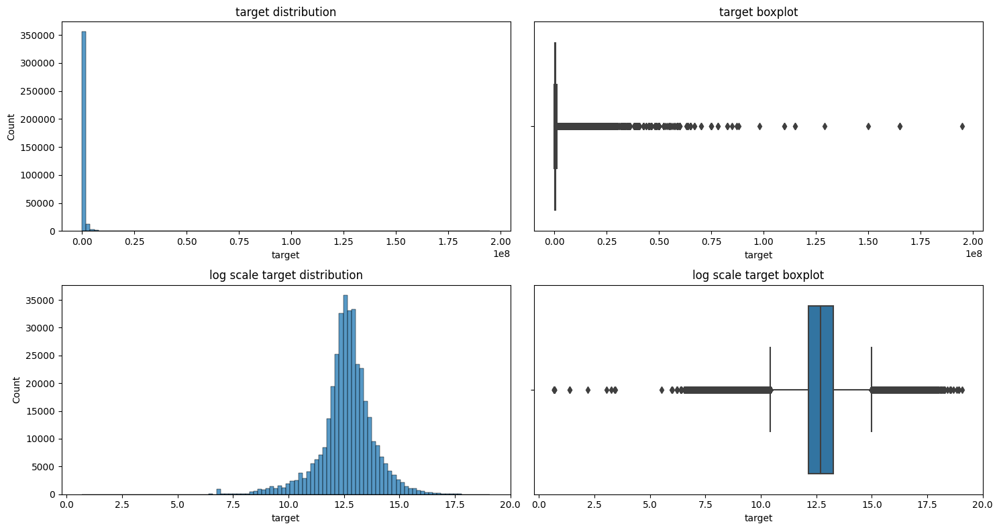

In [17]:
# look at the outliers
col = 'target'
outliers = outlier_analysis(data, col, m=1, n=100)

There are some real outliers with log(target) < 5  need to investigate and remove them.<br>
target log scale looks better and normally distributed

In [18]:
data.loc[np.log(data.target)<5]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target,non_na_count,mo_target
15533,Active,NaN,Single Family Home,1230 Old Dickerson Rd,2,"{'atAGlanceFacts': [{'factValue': '1940', 'fac...",NaN,Goodlettsville,"[{'rating': ['3', '2', '3', '3', '2', '1', 'NR...",1596,37072,3.0,TN,1.00,NaN,NaN,2108367,1,14,0
25334,NaN,NaN,Single Family,3205 N High School Rd,1.0,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",Yes,Indianapolis,"[{'rating': ['2/10', 'NA', '1/10'], 'data': {'...","1,586",46224,3,IN,0,NaN,NaN,21683478,1,14,0
84951,foreclosure,NaN,lot/land,7804 Hamilton Ave,NaN,"{'atAGlanceFacts': [{'factValue': '1865', 'fac...",yes,Cincinnati,"[{'rating': ['2/10'], 'data': {'Distance': ['0...","2,536 sqft",45231,6 Beds,OH,2.0,NaN,NaN,1623043,1,14,0
110286,Active,NaN,NaN,13460 NW 107th Ave,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Hialeah Gardens,"[{'rating': ['9', '10', 'NR', '6', '6'], 'data...",NaN,33018,NaN,FL,NaN,NaN,NaN,A10690349,20,9,0
135433,Active,NaN,NaN,945 SE 18 Ave,"2,500","{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palmetto Bay,"[{'rating': [], 'data': {'Distance': [], 'Grad...",NaN,33158,Baths,FL,NaN,NaN,NaN,A10764416,29,11,0
148240,Active,NaN,Land,Cummings St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Huntley,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,60142,NaN,IL,NaN,NaN,NaN,07629114,1,11,0
162060,Active,NaN,NaN,1451 Unit 1491 N Federal Hwy,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Fort Lauderdale,"[{'rating': ['3', '5', '7'], 'data': {'Distanc...",NaN,33304,NaN,FL,NaN,NaN,NaN,A10458107,8,9,0
177819,Active,NaN,NaN,3301 Ravenswood Rd,"1,500","{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Dania Beach,"[{'rating': ['4', '4', '3'], 'data': {'Distanc...",NaN,33312,Baths,FL,NaN,NaN,NaN,A10786268,3,11,0
205356,Active,NaN,Land,Route 47 Hwy,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Huntley,"[{'rating': ['8', '9', '8', '7', '7', 'NR'], '...",0,60142,NaN,IL,NaN,NaN,NaN,07629371,1,11,0
252299,foreclosure,NaN,lot/land,8136 Bradyville Pike,NaN,"{'atAGlanceFacts': [{'factValue': '2005', 'fac...",NaN,Murfreesboro,"[{'rating': ['5/10', '7/10', '7/10'], 'data': ...",NaN,37127,NaN,TN,NaN,NaN,NaN,2105413,1,10,0


It's too low target values especially for houses so need to remove them.

In [19]:
data.drop(data.loc[np.log(data.target)<5].index, inplace=True)

# also too high target values need to remove
data.drop(data.loc[np.log(data.target)>17.5].index, inplace=True)

#### PrivatePool & private pool

<AxesSubplot: >

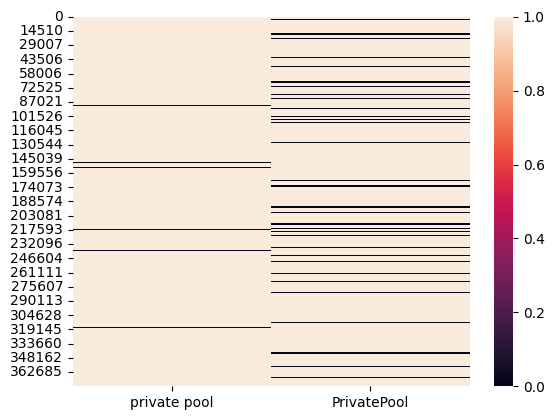

In [20]:
# look at the na in pool  columns
sns.heatmap(data[['private pool', 'PrivatePool']].isnull())

Seems like values in private pool could fill na in PrivatePool column

In [21]:
# according to the dtale private pool and PrivatePool columns has 98.9% and 89.3% of missing values
# but they have only unique 'yes' values and don't have 'no' values.
# as the pool makes the property more expensive try to leave the column
# bind columns together
data['private_pool'] = data.PrivatePool.fillna(data['private pool'])
data.drop(['private pool', 'PrivatePool'], axis=1, inplace=True)
# look at unique values
data.private_pool.unique()

array([nan, 'yes', 'Yes'], dtype=object)

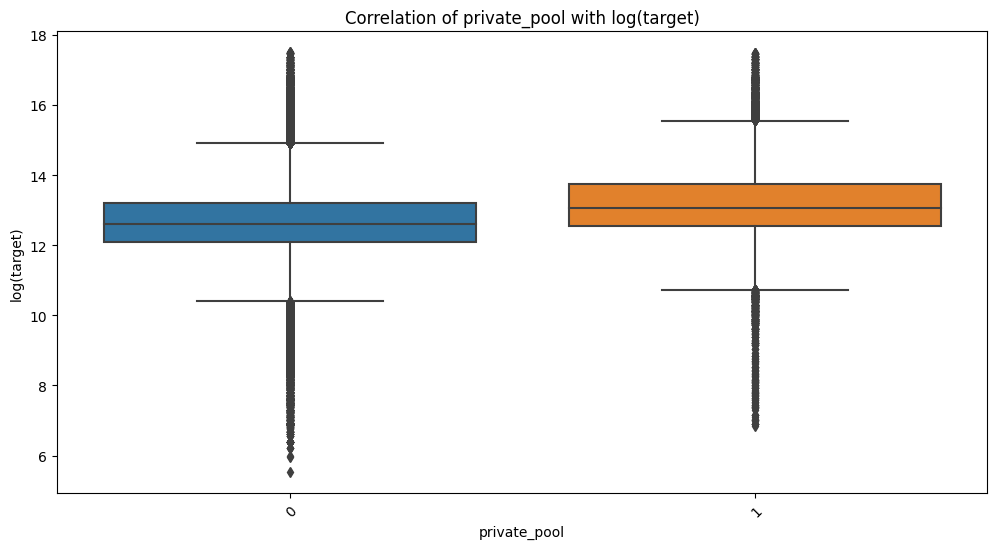

In [22]:
# format column
data.private_pool = data.private_pool.str.lower().replace({'yes': 1, np.nan: 0}).astype('int8')

# look at the correlation
plot_correlation_boxplot(data, 'private_pool', 'target')

Median price of houses with private pool is higher than without it.

#### Fireplace

In [23]:
data.fireplace.value_counts()

yes                                                                                                                                                                                                                                        49989
Yes                                                                                                                                                                                                                                        20593
1                                                                                                                                                                                                                                          14533
2                                                                                                                                                                                                                                           2432
Not Applicable                      

In [24]:
# according to the dtale fireplace column has 73% of missing values 
# need to remove it as it also have high cardinality in it 27% of nat na values
# but before can get the info about ceiling fan in the property which is also in fireplace column
data.fireplace = data.fireplace.str.lower()
data['cooling'] = data.fireplace.apply(lambda x: 1 if pd.notnull(x) and 'ceiling fan' in x  else 0)
data.cooling.value_counts()

# remove fireplace column
data.drop('fireplace', axis=1, inplace=True)

#### MlsId & mls-id

<AxesSubplot: >

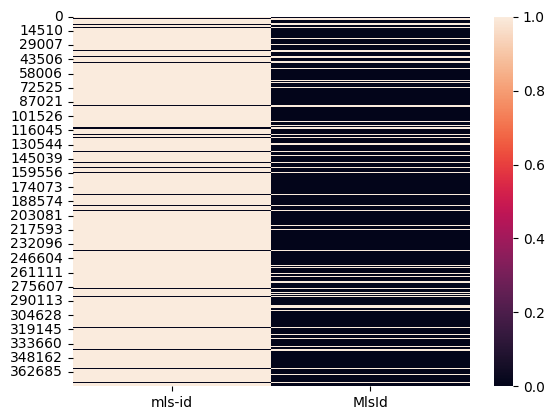

In [25]:
# look at the na in mls id columns
sns.heatmap(data[['mls-id', 'MlsId']].isnull())

Seems like mls-id not-null values can fill respectively to MlsId column

In [26]:
# create new mls_id column from both mls-id & MlsId columns
data['mls_id'] = data.MlsId.fillna(data['mls-id'])

# get the final number of nan's in mls_id column
display(data.mls_id.isna().sum())

# remove not needed MlsId and mls-id columns
data.drop(['mls-id', 'MlsId'], axis=1, inplace=True)

# look at the data
data.mls_id.value_counts()

39525

NO MLS                                                          25
No MLS #                                                        16
 A, Houston, TX 77008                                           13
No                                                              12
 12A, Orlando, FL 32833                                         11
No mls                                                           9
 1, South Boston, MA 02127                                       9
 B, Houston, TX 77008                                            9
 B, Houston, TX 77007                                            8
 11A, Orlando, FL 32833                                          8
 2, Washington, DC 20002                                         8
 2, Washington, DC 20010                                         7
 1, Washington, DC 20002                                         7
 1, Washington, DC 20010                                         6
2101941                                                       

There are a lot of duplicates in mls_id - 22% of the data. MLS-id should be unique indicator of the property.<br>
As the duplicated rows were removed it means that there were some errors while collecting data and the same mls_id property have some differences.<br>
The data had multiple mls_id columns it means that the data was concatenated from different database.<br>
Properties with the same mls_id have also different target value.<br>
Need to remove duplicated mls_id for the same properties.

In [27]:
# select the mls data to remove
mls = data.mls_id.value_counts().reset_index()
selected_mls = mls.loc[(mls.mls_id > 1) & (~mls['index'].str.contains('no', case=False)) & (~mls['index'].str.contains(' ', regex=False))]

# select data with the same mls_id, state, zipcode and remove duplicates
check_special = data.loc[data['mls_id'].isin(selected_mls['index'])]
check_special = check_special.drop_duplicates(subset=['mls_id', 'state', 'zipcode'], keep='first')

# select the rest of the data 
check_rest = data[~(data['mls_id'].isin(selected_mls['index']))]

# bined the rest of the data with data with removed mls_id duplicates
data = pd.concat([check_special, check_rest])

#### status

In [28]:
# prepare the dictionary for regex
status_reg={':.+': '',\
            '   ': ' '
}

# format the column and convert 'status' lowercase
data.status = data.status.str.lower().str.replace(' - ', ' ').replace(status_reg, regex=True)

# look at the unique values
data.status.unique()

array(['active', nan, 'for sale', 'new construction',
       'under contract showing', 'active under contract', 'pending',
       'contingent', 'price change', 'new', 'p', 'active option',
       'foreclosure', 'under contract show', 'option pending', 'auction',
       'a active', 'pending inspection', 'active option contract',
       'pending continue to show', 'c', 'auction active', 'pi',
       'back on market', 'contract p',
       'contingent finance and inspection', 'active auction',
       'contingent show', 'contingent take backup', 'under contract',
       'pending with contingencies', 'pending taking backups',
       'pending in', 'active backup', 'listing extended',
       'offer pending signature', 'under contract no show',
       'ct insp inspection contingency', 'under contract backups',
       'contingent escape', 'conditional contract', 'backup contract',
       'option contract', 'active with offer', 'conting accpt backups',
       'contingency 48 hr (+/ )', 'contingen

In [29]:
# prepare manual dictionary based on gpt which provided category desciption
gpt_manual_dict = {'for sale':'active',\
            'new construction':'active',\
            'new':'active',\
            'a active':'active',\
            'active option':'active',\
            'active with contingencies':'active',\
            'active option contract':'active',\
            'active auction':'auction',\
            'active with offer':'active',\
            'temporary active':'active',\
            'p':'pending',\
            'pending continue to show':'pending',\
            'p pending sale':'pending',\
            'pending ab':'pending',\
            'pending inspection':'pending',\
            'pending with contingencies':'pending',\
            'pending bring backup':'pending',\
            'pending taking backups':'pending',\
            'pending offer approval':'pending',\
            'pending in':'pending',\
            'pending w/insp finance':'pending',\
            'pending continue to show financing':'pending',\
            'pending w/ cont.':'pending',\
            'pending w/escape clause':'pending',\
            'pending sale':'pending',\
            'pending backup offer requested':'pending',\
            'pending sh':'pending',\
            'under contract taking back up offers':'active backup',\
            'under contract showing':'under contract',\
            'under contract backups':'active backup',\
            'active under contract':'under contract',\
            'u under contract':'under contract',\
            'contract':'under contract',\
            'contract p':'under contract',\
            'under contract no show':'under contract',\
            'contract contingent on buyer sale':'under contract',\
            'under contract w/ bckp':'active backup',\
            'uc continue to show':'under contract',\
            'active/contingent':'contingent',\
            'contingent finance and inspection':'contingent',\
            'contingent show':'contingent',\
            'contingent take backup':'contingent',\
            'contingency contract':'contingent',\
            'contingent escape':'contingent',\
            'contingent release':'contingent',\
            'contingent no show':'contingent',\
            'contingent foreclosure':'foreclosure',\
            'conting accpt backups':'contingent',\
            'contingent sale of home':'contingent',\
            'contingent financing':'contingent',\
            'recently sold':'sold',\
            'pre-foreclosure / auction':'pre-foreclosure',\
            'foreclosed':'foreclosure',\
            'apartment for rent':'for rent',\
            'condo for rent':'for rent',\
            ' / auction':'auction',\
            'back on market':'active',\
            'lease/purchase pending':'lease/purchase',\
            'backup contract':'active backup',\
            'option pending':'pending',\
            'pending, continue to show':'pending',\
            'pending (do not show)':'pending',\
            'pending w/backup wanted':'pending',\
            'pending backups wanted':'pending',\
            'pending fe':'pending',\
            'pending take backups':'pending',\
            'active contingency':'contingent',\
            'conditional contract':'contingent',\
            'auction active':'auction',\
            'under contract show':'under contract',\
            'pf': 'pending',\
            're activated': 'active',\
            'reactivated':'active',\
            'c':'sold',\
            'p':'pending',\
            'pi': 'price change',\
            'ct': 'contingent',\
            'ps': 'pending',\
            'active backup':'active',\
            'active contingent':'contingent',\
            'contingent lien holder release':'contingent',\
            'contingency 48 hr (+/ )': 'contingent',\
            'active with contract': 'active',\
            'backup': 'active backup',\
            'accepting backups': 'active backup',\
            'listing extended':'active',\
            'c continue show': 'under contract',\
            'closed':'sold',\
            'offer pending signature': 'pending',\
            'ct insp inspection contingency': 'contingent',\
            'accepted offer': 'pending',\
            'option contract': 'pending',\
            'due diligence period': 'under contract'

}

# replace status data using dictionary
data.status = data.status.replace(gpt_manual_dict)

# look at the whole converted data
data.status.value_counts()

active             239860
pending              6612
foreclosure          5913
pre-foreclosure      3281
under contract       3174
auction              1305
contingent            899
price change          418
for rent              412
active backup         259
coming soon           110
sold                   44
lease/purchase          4
Name: status, dtype: int64

In [30]:
# look at the status of targets with 'mo' value
data.loc[data.mo_target == 1, 'status'].unique()

array(['for rent'], dtype=object)

As it has only status 'for rent' could drop this column as it has the same info as status column.

In [31]:
data.drop('mo_target', axis=1, inplace=True)

# replace nan in column by 'unknown'
data.status.fillna('unknown', inplace=True)

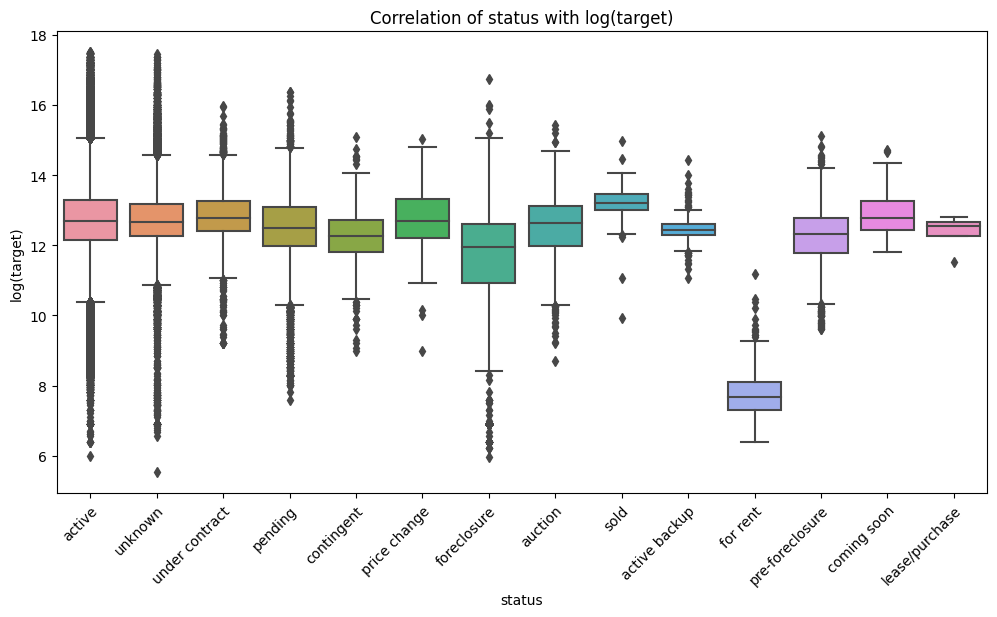

In [32]:
# look at the status and target correlation
plot_correlation_boxplot(data, 'status', 'target')

for rent status has the lowest median value and is an outlier, could be removed.<br>
There are a lot of low target values which have not rent status, ie 'active', 'unknown', 'foreclosure', need to investigate this data after data formatting

#### propertyType

In [33]:
# create new column with number of words in property type before formatting
data['type_word_1'] = data.propertyType.apply(lambda x: len(x.split()) if isinstance(x, str) else 0)

# create new column with number of property type splitted by ',' or '/' or 'or' before formatting
data['type_hc_1'] = data.propertyType.apply(lambda x: len(re.split(r'\s+or\s+|,\s+|\/(?!\d+\s)', x)) if isinstance(x, str) else 0)

In [34]:
# look at the data
data.propertyType.value_counts()

single-family home                                                                                                  74073
Single Family                                                                                                       48442
Single Family Home                                                                                                  25632
condo                                                                                                               21075
lot/land                                                                                                            17759
Condo                                                                                                               12651
townhouse                                                                                                            9291
Land                                                                                                                 9104
multi-family            

In [35]:
# prepare regex dictionary 
type_dict = {'\(4-7 stories\)': ', 4 story',\
            '\(1-3 stories\)': ', 1 story',\
            'lot\/land': 'land',\
            'one':'1',\
            'two':'2',\
            'stories':'story',\
            '-': ' ',\
            '\+':'',\
            r'(?<!\d)\/\s*(?!\d)': ', ',\
            r'(?<=,)(?=\w)': ' '
            } 

# format property type column
data['propertyType'] = data['propertyType'].str.lower().replace(type_dict, regex=True)

# look at the formatted data
# data.propertyType.value_counts()

In [36]:
# prepare the column with property height data for stories column
data['property_height'] = data.apply(find_property_height, axis=1)

PropertyType column have data about number of stories, levels and rise of the building. <br>
According to the dtale report stories column also have such data and have data where propertyType has na, so will bind both columns

In [37]:
# bind propertyType and stories columns
cond = ~data.stories.isna()
data.loc[cond, 'propertyType'] = data.loc[cond].apply(property_bind, axis=1)

# prepare new dict 
prop_dict = {'low rise (1 story)': 'low rise',\
            '1 1/2 story': 'low rise',\
            '3 or more': 'low rise',\
            'with basement': '',\
            '2 story condo': 'condo, 2 story',\
            'condominium': 'condo',\
            'mfd': 'mobile',\
            '-': ' ',\
            'tri': '3',\
            '   ': ' ',\
            'single wide mh': 'mobile',\
            'prefab': 'mobile',\
            'modular': 'mobile',\
            'double wide': 'mobile',\
            'manufactured \(certificate exchange\)': 'mobile',\
            'manufactured home   double wide': 'mobile',\
            'manufactured home': 'mobile',\
            'manufactured': 'mobile',\
            'manufactured house': 'mobile',\
            'single wide': 'mobile',\
            'manu   double wide': 'mobile',\
            'mobile with land': 'mobile, land',\
            'singlewide': 'mobile',\
            'doublewide': 'mobile',\
            'ranch house': 'ranch',\
            'farms': 'farm',\
            'ranches': 'ranch',\
            'rancher': 'ranch',\
            'raised ranch\s?': 'ranch, split level',\
            'walk out ranch': 'ranch',\
            'step ranch\s?': 'ranch, split level',\
            'expanded ranch\s?': 'ranch',\
            'farm house': 'farm',\
            'single family home': 'detached',\
            'single detached': 'detached',\
            'single family': 'detached',\
            'singlefamilyresidence': 'detached',\
            'multi family home': 'multi family',\
            '\s?cape cod\s?': 'cape',\
            '\s?other arch \(see remarks\)': 'other',\
            'other style\s?': 'other',\
            'co op\s?': 'coop',\
            'cooperative': 'coop',\
            'townhouse end unit': 'townhome, end unit',\
            'townhome style': 'townhome',\
            'townhouse interior': 'townhome',\
            'townhouse': 'townhome',\
            'other style': 'other',\
            '3 story': 'low rise',\
            '1 story': 'low rise',\
            '2 story': 'low rise',\
            'less than 4 floors': 'low rise',\
            'hi rise': 'high rise',\
            '4 floors': 'mid rise',\
            '4 story': 'mid rise',\
            '2.5 story': 'low rise',\
            'transitional': 'contemporary, traditional',\
            'urban contemporary': 'contemporary',\
            'bilevel':'split level',\
            'tri level': 'split level',\
            'capeshingle': 'cape',\
            '1/2 duplex': 'multiplex',\
            'duplex': 'multiplex',\
            'fourplex': 'multiplex',\
            'triplex': 'multiplex',\
            'residential \(\<?\d\+? acre\)': 'residental',\
            'hi ranch': 'ranch, split level',\
            'high ranch': 'ranch, split level',\
            '2 unit condo': 'condo',\
            'mid century modern\s?': 'mid century',\
            'historic vintage': 'historic',\
            'older': 'historic',\
            'designated historical home': 'historic',\
            'florida style': 'mediterranean',\
            'old spanish': 'historic, mediterranean',\
            'spanish colonial': 'mediterranean, colonial',\
            'spanish': 'mediterranean',\
            'florida': 'mediterranean',\
            'mediterraneanstyle': 'mediterranean',\
            'french provincial\s?': 'french',\
            'french province\s?': 'french',\
            'key west\s?': 'coastal',\
            'coastal beach home\s?': 'coastal',\
            'coastal ii\s?': 'coastal',\
            'custom home\s?': 'custom',\
            'country english\s?': 'english',\
            'manuf': 'mobile',\
            'condo \(\d levels\)\s?': 'condo, split level',\
            'modile\s?': 'mobile',\
            'apartment building\s?': 'apartment',\
            'apartments': 'apartment',\
            'coastal low rise ': 'coastal, low rise ',\
            'modern farm': 'modern, farm',\
            'coastal contemporary': 'coastal, contemporary',\
            'multiple occupancy': 'multi family',\
            'tuscan': 'mediterranean',\
            'rustic contemporary': 'rustic, contemporary',\
            'guest cottage': 'cottage',\
            'old style': 'historic',\
            'old world': 'historic',\
            'old': 'historic',\
            'modern architecture': 'modern',\
            'multi level': 'split level',\
            'quad level': 'split level',\
            'split \(\d level\)': 'split level',\
            'mid level': 'split level',\
            'loft with bedrooms': 'loft',\
            'mountain contemporary': 'contemporary',\
            'coastal modern': 'coastal, modern',\
            'split foyer': 'split level',\
            'row home': 'row',\
            'forest garden home': 'garden',\
            'garden apartment': 'garden',\
            'garden home': 'garden',\
            'attached multiplex': 'attached, multiplex',\
            'log home': 'log',\
            'modernist': 'modern',\
            'bi level': 'split level',\
            'patio home': 'patio',\
            'dutch colonial': 'dutch, colonial',\
            'dutch provincial': 'dutch',\
            'split leveland  loft': 'loft',\
            'mobile low rise': 'mobile, low rise',\
            'split entry \(bi level\)': 'split entry, split level'
            
}   

pt_regex = {'condo \(single level\)': 'condo',\
            'sixplex': 'multiplex',\
            'antique': 'historic',\
            'condo \(split levels\)': 'condo, split levels',\
            'high rise \(8 story\)': 'high rise',\
            '2 or more stories': 'low rise',\
            'land, lot': 'land',\
            'stories/levels': '',\
            '1 and 1 half': 'low rise',\
            'mobile home': 'mobile',\
            'mobile mo2le with land': 'mobile, land',\
            'mobile mobile': 'mobile',\
            '\d\s?plex': 'multiplex',\
            'bi level': 'split level',\
            'attached multiplex': 'attached, multiplex',\
            'mobile house': 'mobile',\
            'historical': 'historic',\
            'mobile manu mobile': 'mobile',\
            'low rise traditional': 'low rise, traditional',\
            '\d level': 'split level',\
            '\s?other \(?see remarks\)?': 'other',\
            'farmhouse': 'farm',\
            'other multi unit': 'other, multi unit',\
            'low rise levels': 'low rise',\
            'split levels': 'split level',\
            'multi/split':''
}

# format property type column
data['propertyType'] = data['propertyType'].str.lower().replace(prop_dict, regex=True).replace(pt_regex, regex=True)#.str.lstrip(',')
data['propertyType'] = data['propertyType'].apply(lambda x: ', '.join(set(part.strip() for part in x.split(','))) if isinstance(x, str) else x)   
data.loc[data['propertyType'] == '', 'propertyType'] = np.nan

# look at the formatted data
# data.propertyType.value_counts()

In [38]:
# look at the apartment type, as it was told that it's for rent only
display(data.loc[(data['propertyType'].str.contains('apartment', na=False)), 'target'].describe())
display(data.loc[(data['propertyType'].str.contains('apartment', na=False)), 'status'].describe(include='object'))

# look at the outliers
display(data.loc[(data['propertyType'].str.contains('apartment', na=False)) & (data.target < 20000), ['target', 'propertyType', 'status']])

count        670.000
mean      965297.161
std      1663655.078
min          800.000
25%       309000.000
50%       550000.000
75%       865750.000
max     17550000.000
Name: target, dtype: float64

count        670
unique         7
top       active
freq         604
Name: status, dtype: object

,target,propertyType,status
5873,1250,apartment,for rent
21101,3250,apartment,for rent
26348,2300,apartment,unknown
32787,2850,apartment,unknown
67076,2200,apartment,unknown
74946,1950,apartment,unknown
75605,2995,apartment,unknown
94444,1695,apartment,unknown
95272,2995,apartment,unknown
101424,2200,apartment,for rent


According to the target all this data, with target < 20000, is apartment for rent, need to update the status 

In [39]:
data.loc[(data['propertyType'].str.contains('apartment', na=False)) & (data.target < 20000), 'status'] = 'for rent'

# prepare column to indicate data for rent which has lower price
data['rent'] = data.status.apply(lambda x: 1 if x == 'for rent' else 0)
         
# replace na with unknown category
data.propertyType = data.propertyType.apply(lambda x: ['unknown'] if pd.isna(x) else [part.lstrip(' ') for part in re.split(r'\s+or\s+|,\s+|\/(?!\d+\s)', x)])

In [40]:
# flatten the list of property types and remove empty strings
types_list = [item for sublist in data['propertyType'].tolist() for item in sublist if item != '']

# get the top 21 property types
top_types = sorted(set(types_list), key=types_list.count, reverse=True)[:21]
top_types

['low rise',
 'detached',
 'condo',
 'land',
 'townhome',
 'unknown',
 'multi family',
 'coop',
 'high rise',
 'traditional',
 'row',
 'mid rise',
 'mobile',
 'contemporary',
 'ranch',
 'split level',
 'modern',
 'mediterranean',
 'colonial',
 'apartment',
 'other']

In [41]:
# Replace property types not in the top 21 with 'other'
data['propertyType'] = data['propertyType'].apply(lambda x: ['other' if t not in top_types else t for t in x])

# Remove duplicates within each propertyType list
data['propertyType'] = data['propertyType'].apply(lambda x: list(set(x)))

In [42]:
# create new column with number of formatted property type 
data['type_hc_2'] = data.propertyType.apply(lambda x: len(x))
data.type_hc_2.value_counts()

2    168382
1    114451
5      3783
4      2270
3      1920
6        33
7         4
8         1
Name: type_hc_2, dtype: int64

In [43]:
split_property_format = data.propertyType.explode().value_counts()
split_property_format

low rise         167273
detached         151584
condo             39983
land              26867
townhome          20772
unknown           19373
multi family      10340
coop               9129
high rise          6110
traditional        5855
row                5545
other              5104
mid rise           4392
mobile             3001
contemporary       2910
ranch              2152
split level        1139
modern             1138
mediterranean      1064
colonial            803
apartment           670
Name: propertyType, dtype: int64

In [44]:
# select top 10 from property type and create dummy columns with them
top = split_property_format[:10].index.tolist()
for col in top:
    col_name = 'prop_' + col
    data[col_name] = data.propertyType.apply(lambda x: 1 if col in x else 0).astype('int8')

# creat a column that indicates whether the property was not in the top
data['not_top_property'] = data.propertyType.apply(lambda x: 1 if all([prop not in x for prop in top]) else 0)

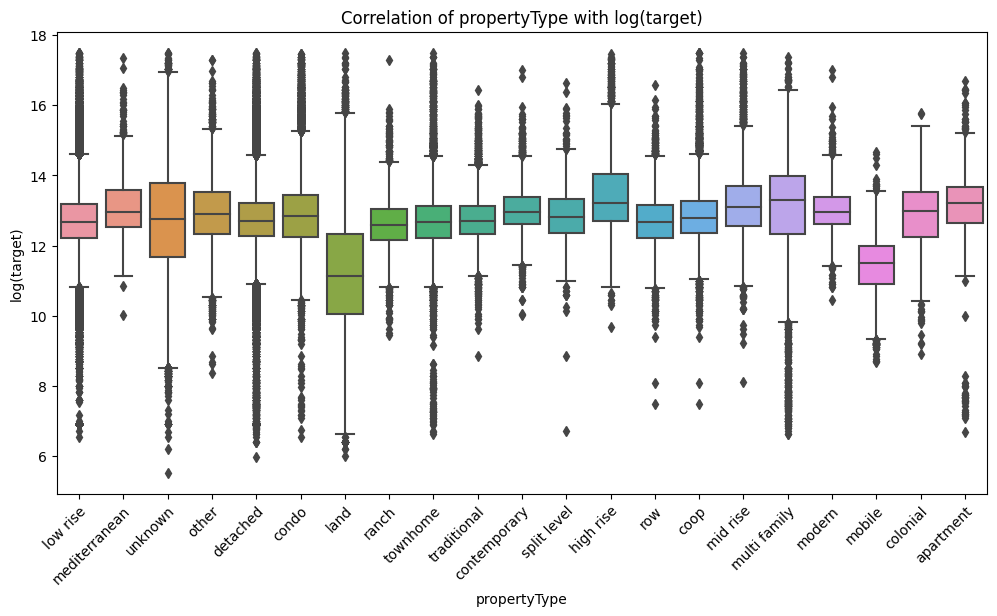

In [45]:
# Explode the propertyType column into individual rows
data_exploded = data[['propertyType', 'target']].explode('propertyType')

# look at the correlation
plot_correlation_boxplot(data_exploded, 'propertyType', 'target')

The data has real outliers in apartment propertyType, it's rent data.<br>
Also it has a lot of target low values in another propertyType like 'detached', 'low rise', 'land', 'unknown', 'townhome', 'condo', 'multi family', need to investigate this data.

In [46]:
# convert propertyType back to string
data['propertyType'] = data['propertyType'].apply(lambda x: ', '.join(x))

In [47]:
# look at low target values
display(data.loc[np.log(data.target) < 8, ['propertyType', 'status', 'baths', 'beds', 'sqft', 'private_pool', 'city', 'target']].describe())
display(data.loc[np.log(data.target) < 8, ['propertyType', 'status', 'baths', 'beds', 'sqft', 'private_pool', 'city', 'target']].describe(include='object'))

,private_pool,target
count,1436.000,1436.000
mean,0.037,1256.964
std,0.189,526.158
min,0.000,250.000
25%,0.000,1000.000
50%,0.000,1000.000
75%,0.000,1296.000
max,1.000,2950.000


,propertyType,status,baths,beds,sqft,city
count,1436,1436,555,1233,1287,1436
unique,15,5,22,33,741,143
top,"low rise, detached",foreclosure,2 Baths,3 Beds,0,Detroit
freq,697,923,349,571,37,912


Target value is too low for this data, the most frequent status is 'foreclosure' while the most frequent type is 'low rise, detached',<br>
but the city is detroit and there are a lot of very cheap houses there, so will leave this data.

#### Stories

In [48]:
# look at the number of stories rows which intersects with property_height
display(data.loc[(~data.stories.isna()) & (~data.property_height.isna()), ['stories', 'property_height']].shape)

# look at the number of Na stories rows which intersects with property_height
display(data.loc[(data.stories.isna()) & (~data.property_height.isna()), ['stories', 'property_height']].shape)

(370, 2)

(5985, 2)

Seems like most of the values in property_height don't have corresponding values in stories column, could bind 2 columns together

In [49]:
# bind stories and property_height column
cond = (~data['property_height'].isnull())
data.loc[cond, 'stories'] = data.loc[cond, ['stories', 'property_height']].apply(lambda x:
                                    x['property_height'] if pd.isna(x['stories']) else
                                    str(x['stories']) + ', ' + str(x['property_height']), axis=1)

# drop the property_height column
data.drop('property_height', axis=1, inplace=True)

In [50]:
# prepare story dictionary
stories_dict = {'Three Or More': '3 stories',\
            'One': '1 story',\
            'One, Two': '1 story',\
            'Two': '2 story',\
            'Two Story or More': '2 story',\
            '2 Story/Basement': '2 story',\
            '1 Story Basement': '1 story',\
            '2 Or More Stories': '2 story',\
            '3-4 Stories': '3 stories',\
            '3 - 5 Stories': '3 stories',\
            '1-2 Stories': '1 story',\
            '1-2 Stories, 3-4 Stories': '1 story',\
            '1.5, 2': '2 story',\
            'Total Floors in Bldg': np.nan,\
            'Stories/Levels': np.nan,\
            'None': np.nan
    }


# prepare regex dict
stories_regex = {'\+': '',\
                '^\,\s?': '',\
                'hi\s': 'high ',\
                'high\-': 'high ',\
                'one': '1',\
                'two': '2',\
                'three': '3',\
                '-': ' ',\
                'tri': '3',\
                'bi': '2',\
                '1 1/2 levels': '1.5 level',\
                '1 1/2 story': '1.5 story',\
                '1 and 1 half': '1.5',\
                'ranch/1 story': 'ranch, 1 story',\
                '1 story/ranch': '1 story, ranch'  
    }

# format the data
data['stories'] = data.stories.replace(stories_dict).str.lower().replace(stories_regex, regex=True)

In [51]:
# create column with data connected only to story
data['story'] = data.stories.apply(process_story)

# create dict for certain cases in story column
story_dict = {'single level': '1',\
                'mo2le': np.nan,\
                '3plex': np.nan,\
                'ca2n/cottage': np.nan,\
                '3 or more, 3 level': '3',\
                '2, 2 level': '2',\
                '1, lower level': '1',\
                '5, 2 level': '5',\
                '1 leveland  loft': '1',\
                'ground level': '1',\
                '7, 2 level': '7',\
                '1, 2': '1',\
                '4, 2 level': '4',\
                '1, 3 or more': '1',\
                '2, 3 or more': '2',\
                '1.5, 3 or more': '1.5',\
                '3, 2 level': '3',\
                '11, 2 level': '11',\
                '9, 2 level': '9',\
}
story_regex = {'\, split level': '',\
                '\, single level': '',\
                '\s?story\/basement':'',\
                'ground level, ': ''
}

# format story column, for the rest cases use function extract_story and convert to numeric format
data['story'] = data.story.replace(story_dict).replace(story_regex, regex=True).apply(extract_story)
data['story'] = np.floor(pd.to_numeric(data['story']))

25 percentile: 1.0, 75 percentile: 2.0, IQR: 1.0,  Outlier borders: [-0.5, 3.5].


Number of Tukey outliers in story column - 9113

Outliers are detected in log scale
25 percentile: 0.6931471805599453, 75 percentile: 1.0986122886681098, IQR: 0.4054651081081645,  Outlier borders: [0.0849495183976986, 1.7068099508303565].
Number of Tukey outliers in log story column - 15634

z score lower bound -6.907552232189026
z score upper bound 10.749669676038266
Number of z score outliers in story column - 1600

Outliers are detected in log scale
z score lower bound -0.37458639366461743
z score upper bound 2.247306991772258
Number of z score outliers in log story column - 4470



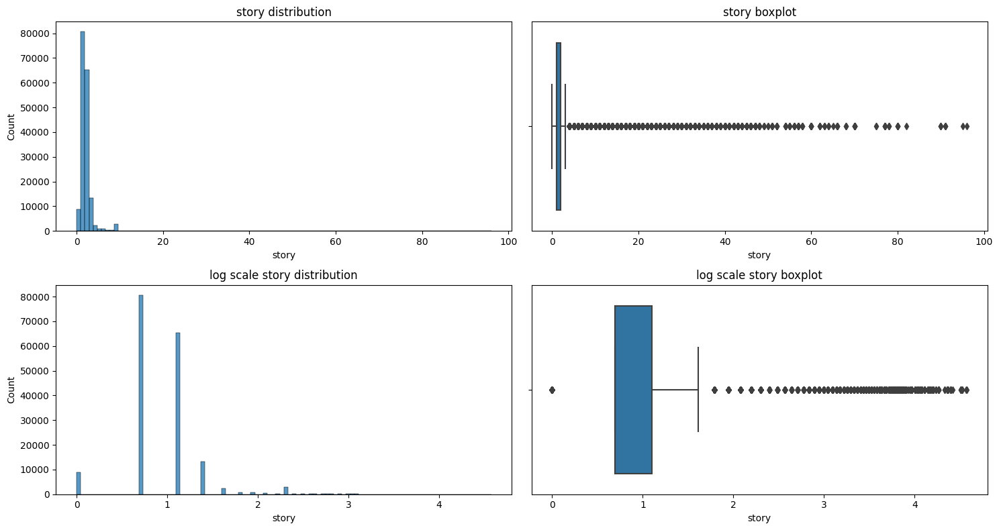

In [52]:
# look at the outliers
col = 'story'
outliers = outlier_analysis(data, col, m=1, n=100)

There are 0 story - should be replaced if it's not land property type.

In [53]:
# look at the highest story
cols = data.columns.tolist()[:14]
data.loc[data.story > 50, cols+['story']].sort_values('story', ascending=False)[:10]

,status,propertyType,street,baths,homeFacts,city,schools,sqft,zipcode,beds,state,stories,target,non_na_count,story
323546,active,"condo, high rise",432 Park Ave #50C,4 Baths,"{'atAGlanceFacts': [{'factValue': '2012', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","3,576 sqft",10022,3 Beds,NY,96.0,22500000,15,96.000
210310,active,"condo, high rise",217 W 57th St #46C,4 Baths,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","3,401 sqft",10019,3 Beds,NY,95,18000000,14,95.000
361915,active,"condo, high rise",125 Greenwich Ave #50D,4 Baths,"{'atAGlanceFacts': [{'factValue': '2017', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","1,933 sqft",10014,3 Beds,NY,91,4759900,15,91.000
184714,active,"condo, high rise",125 Greenwich Ave #22D,4 Baths,"{'atAGlanceFacts': [{'factValue': '2017', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","1,932 sqft",10014,3 Beds,NY,91,3750000,15,91.000
14988,active,"condo, high rise",125 Greenwich Ave #79D,4 Baths,"{'atAGlanceFacts': [{'factValue': '2017', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","1,932 sqft",10014,3 Beds,NY,91,6975000,15,91.000
289244,active,"condo, high rise",125 Greenwich Ave #20A,NaN,"{'atAGlanceFacts': [{'factValue': '2017', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...",878 sqft,10014,NaN,NY,91,1450000,13,91.000
325878,active,"condo, high rise",157 W 57th St #41B,3 Baths,"{'atAGlanceFacts': [{'factValue': '2009', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","1,988 sqft",10019,2 Beds,NY,90.0,6995000,15,90.000
14519,active,"condo, high rise",157 W 57th St #50C,5 Baths,"{'atAGlanceFacts': [{'factValue': '2009', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","3,466 sqft",10019,4 Beds,NY,90.0,16500000,15,90.000
113091,active,"condo, high rise",432 Park Ave #50A,2 Baths,"{'atAGlanceFacts': [{'factValue': '2012', 'fac...",New York,"[{'rating': ['9/10', '8/10', '3/10', '8/10', '...","1,789 sqft",10022,2 Beds,NY,90.0,10995000,15,90.000
223904,active,"condo, high rise",432 Park Ave # 66B,5,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",New York,"[{'rating': ['10/10', '3/10', '8/10'], 'data':...","4,019",10022,4,NY,90.0,32500000,15,90.000


All outliers are real data values.

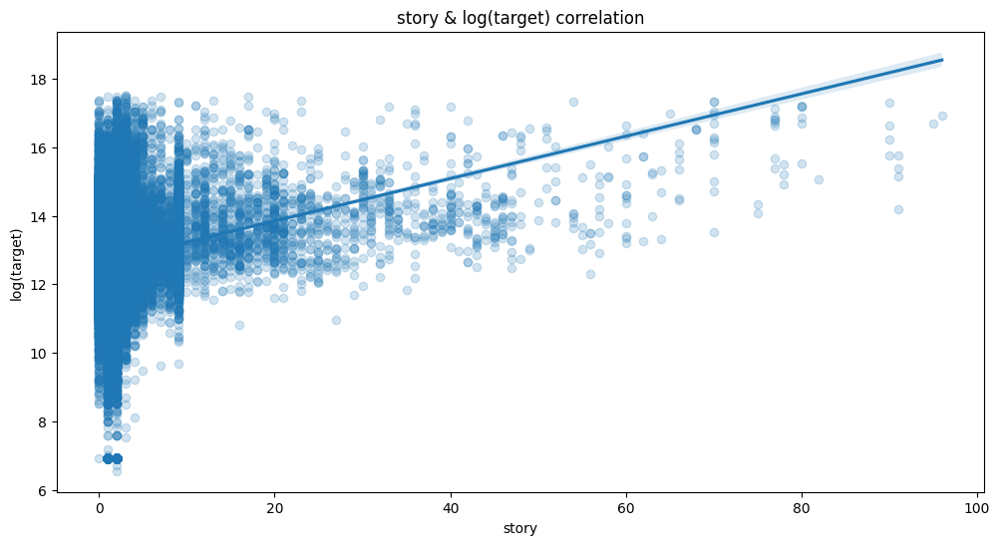

In [54]:
# look at the story and target correlation
plot_scatter_with_regression(data, 'story', 'target')

The higher story the higher the target.<br>

In [55]:
# replace story higher than 70 by 70
data.loc[data.story > 70, 'story'] = 70

# add column to indicate na in story column
data['story_na'] = data.story.apply(lambda x: 1 if pd.isnull(x) else 0)

# fill missing values with median
story_med = data.story.median()
data.story.fillna(story_med, inplace=True)

# replace 0 story by median for not land properties
cond = ((data.propertyType != 'land, other') & (data.propertyType != 'land')) & (data.story == 0)
data.loc[cond, 'story'] = story_med

# try log story value
data['story_log'] = np.log(data.story+1)

#### Beds and Baths

Beds

In [56]:
# according to the dtale we have sqft size in beds column - need to create one more column with such data
data['bed_area'] = data.beds.apply(lambda x: x if pd.notnull(x) and ('sq' in x or 'acre' in x) else np.nan)

# look at the unique beds values
data.beds.value_counts()

3 Beds                                                                                                                        43379
4 Beds                                                                                                                        28945
3                                                                                                                             24393
2 Beds                                                                                                                        21206
4                                                                                                                             15107
2                                                                                                                             12289
3 bd                                                                                                                          10933
5 Beds                                                                      

In [57]:
# prepare regex beds dictionary
beds_dict_regex = {'\s?beds':'',\
                   '\s?bd':'',\
                    '[0-9]*\.?\,?[0-9]* acres?': '-1',\
                    '[0-9]*\,?\.?[0-9]* sqft':'-1',\
                    '1-2':'1'
}
# prepare non regex beds dictionary
beds_dict = {'-- bd':'-1',\
            ' ':'-1',\
            '-- sqft': '-1',\
            '# bedrooms 1st floor': '-1',\
            "based on redfin's st johns data, we estimate the home's value is $360,731, which is 2.2% less than its current list price.":'-1',\
            "based on redfin's raleigh data, we estimate the home's value is $708,248, which is 1.2% more than its current list price.": '-1',\
            '3 or more bedrooms': '3',\
            '3 or more bedrooms, dining room, living room, range/oven, refrigerator':'3',\
            'baths': 'bath',\
            '0.0':'0'
}
# replace all data
data.beds = data.beds.str.lower().replace(beds_dict).replace(beds_dict_regex, regex=True)
# data.beds.value_counts()

In [58]:
# look at the data which has number of bath in beds column
data[data.beds.str.contains('\d baths?,', na=False)]

,status,propertyType,street,baths,homeFacts,city,schools,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,cooling,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_area
124819,active,"low rise, multi family",2333 N 1st St,NaN,"{'atAGlanceFacts': [{'factValue': '1966', 'fac...",Milwaukee,"[{'rating': ['3', '3', '1', '1', '2', '7', 'NR...",0,53212,"1 bath, 2 bedrooms",WI,1 story,1100000,13,0,0,1670863,2,1,0,2,1,0,0,0,0,0,1,0,0,0,0,1.000,0,0.693,NaN
18787,active,"low rise, multi family, mid rise",2670 N Holton St Unit 2678,NaN,"{'atAGlanceFacts': [{'factValue': '1905', 'fac...",Milwaukee,"[{'rating': ['1', '3', '3', '2', '1', '1', 'NR...",0,53212,"1 bath, 2 bedrooms, living room, range/oven, r...",WI,1 story,465000,13,0,0,1659104,2,1,0,3,1,0,0,0,0,0,1,0,0,0,0,1.000,0,0.693,NaN
172605,active,"low rise, multi family",3266 N 3rd St,NaN,"{'atAGlanceFacts': [{'factValue': '1920', 'fac...",Milwaukee,"[{'rating': ['2', '3', '1', '2', '1', 'NR', 'N...",0,53212,"1 bath, 2 bedrooms, eat-in kitchen, living roo...",WI,1 story,139900,13,0,0,1667960,2,1,0,2,1,0,0,0,0,0,1,0,0,0,0,1.000,0,0.693,NaN
238222,active,"multi family, mid rise",5956 N 40th St Unit 5960,NaN,"{'atAGlanceFacts': [{'factValue': '1926', 'fac...",Milwaukee,"[{'rating': ['2', '1', '3', '1', 'NR', 'NR', '...",0,53209,"1 bath, 3 or more bedrooms, cable tv available...",WI,3 stories,179900,13,0,0,1669146,2,1,0,2,0,0,0,0,0,0,1,0,0,0,0,3.000,0,1.386,NaN
279149,active,"low rise, multi family",7233 N 38th St Unit 7247,NaN,"{'atAGlanceFacts': [{'factValue': '1974', 'fac...",Milwaukee,"[{'rating': ['1', '1', '3', '3', 'NR', '1', 'N...",0,53209,"2 baths, 3 or more bedrooms",WI,1 story,925000,13,0,0,1654628,2,1,0,2,1,0,0,0,0,0,1,0,0,0,0,1.000,0,0.693,NaN
325249,active,"multi family, mid rise",4252 N Teutonia Ave,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",Milwaukee,"[{'rating': ['2', '1', '3', '1', 'NR', '1', 'N...",0,53209,"1 bath, 2 bedrooms, cable tv available, dining...",WI,3 stories,679900,13,0,0,1646112,2,1,0,2,0,0,0,0,0,0,1,0,0,0,0,3.000,0,1.386,NaN


In [59]:
# seems like in baths column it has na so will replace na with data from beds column
bath_data = data['beds'].str.contains(r'\d baths?,', na=False)
data.loc[bath_data, 'baths'].fillna(data[bath_data]['beds'].str.extract(r'(\d+)\s*bath')[0], inplace=True)

# check if the data was replaced correctly
data.loc[bath_data, ['beds', 'baths']][:10]

,beds,baths
124819,"1 bath, 2 bedrooms",NaN
18787,"1 bath, 2 bedrooms, living room, range/oven, r...",NaN
172605,"1 bath, 2 bedrooms, eat-in kitchen, living roo...",NaN
238222,"1 bath, 3 or more bedrooms, cable tv available...",NaN
279149,"2 baths, 3 or more bedrooms",NaN
325249,"1 bath, 2 bedrooms, cable tv available, dining...",NaN


In [60]:
# extract number of bedrooms in beds column
bed_index = data[data.beds.str.contains('\s?bedrooms', na=False)].index
data.loc[bed_index, 'beds'] = data.loc[bed_index, 'beds'].str.extract(r'(\d+)(?:\s+or\s+more)?\s*bedrooms')[0]

# There is value 'bath' in beds column will format it after baths column formatting
# add column which indicate that beds column was filled with 'bath'
data['bed_bath_ind'] = data.beds.apply(lambda x: 1 if pd.notnull(x) and x =='bath' else 0)

# replace 'bath' with na in beds column
nan_bed ={'bath': np.nan,\
         '-1': np.nan
}
data['beds'] = data.beds.replace(nan_bed)

# add column which indicate na in bath column
data['beds_na'] = data.beds.apply(lambda x: 1 if pd.isna(x) else 0)

# convert data to numeric format
data.beds = pd.to_numeric(data.beds)

25 percentile: 3.0, 75 percentile: 4.0, IQR: 1.0,  Outlier borders: [1.5, 5.5].
Number of Tukey outliers in beds column - 14451

Outliers are detected in log scale
25 percentile: 1.3862943611198906, 75 percentile: 1.6094379124341003, IQR: 0.2231435513142097,  Outlier borders: [1.051579034148576, 1.9441532394054148].
Number of Tukey outliers in log beds column - 14451

z score lower bound -1.8261129514814973
z score upper bound 8.569118270378276
Number of z score outliers in beds column - 1280

Outliers are detected in log scale
z score lower bound 0.5586389968711774
z score upper bound 2.30302892239285
Number of z score outliers in log beds column - 1984



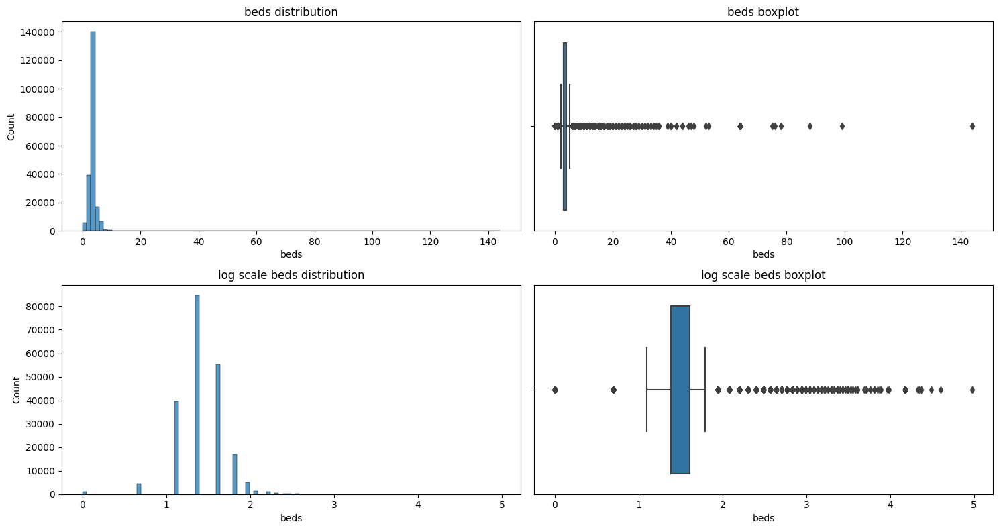

In [61]:
# look at the outliers
col = 'beds'
outliers = outlier_analysis(data, col, m=1, n=100)

The data looks more or less normally distributed.<br>
Log scale beds column is more closely to the normal distribution but it has more outliers.<br>
There are 0 beds - need to replace by median for not land property type

In [62]:
# look at the outliers
outliers['outliers_z']['beds'].describe()

count   1280.000
mean      14.743
std       12.549
min        9.000
25%        9.000
50%       10.000
75%       13.000
max      144.000
Name: beds, dtype: float64

In [63]:
# look deeper at the outliers
# it seems there are some data with number of beds > 64 and there are a lot of data with number of beds = 64
# look at the data with beds > 64
data.loc[data.beds > 64, ['beds', 'baths', 'propertyType', 'status', 'sqft','target']]

,beds,baths,propertyType,status,sqft,target
7324,144.000,2,multi family,active,62376,1590000
110423,99.000,55.0,multi family,active,"30,500",30000000
122038,78.000,44 Baths,multi family,active,"21,210 sqft",20000000
206661,75.000,64.0,"low rise, multi family",active,"39,514 sqft",15350000
340365,76.000,68 Baths,"low rise, multi family",active,"37,394 sqft",12800000
360980,78.000,44.0,multi family,active,"21,210",20000000
363608,88.000,44 Baths,multi family,active,"28,824 sqft",10700000


According to the data above all properties with beds values > 64 are like hotels or hostels as they have high number of baths, sqft and target value.<br>
The only one property with number of beds = 144, big sqft, but with 2 baths and relatively low target is outlier - need to remove this

In [64]:
# remove outlier
data.drop(data.loc[data.beds == 144].index, inplace=True)

# look at the data with number of beds = 64
data.loc[data.beds == 64, ['beds', 'baths', 'propertyType', 'status', 'sqft','target']]

,beds,baths,propertyType,status,sqft,target
104666,64.000,NaN,land,active,NaN,15900
6317,64.000,NaN,land,active,NaN,250000
28785,64.000,NaN,land,active,NaN,39900
34168,64.000,NaN,land,active,NaN,23500
34379,64.000,NaN,land,active,NaN,25000
57736,64.000,NaN,land,active,NaN,62600
65444,64.000,NaN,land,active,NaN,270000
66530,64.000,NaN,land,active,NaN,16500
66983,64.000,NaN,land,active,NaN,99000
68201,64.000,NaN,land,active,NaN,265000


In [65]:
data.loc[data.beds == 64, ['beds', 'baths', 'propertyType', 'status', 'sqft','target']].describe(include='all')

,beds,baths,propertyType,status,sqft,target
count,44.000,0,44,44,0,44.000
unique,NaN,0,1,1,0,NaN
top,NaN,NaN,land,active,NaN,NaN
freq,NaN,NaN,44,44,NaN,NaN
mean,64.000,NaN,NaN,NaN,NaN,64669.318
std,0.000,NaN,NaN,NaN,NaN,75315.808
min,64.000,NaN,NaN,NaN,NaN,4000.000
25%,64.000,NaN,NaN,NaN,NaN,17250.000
50%,64.000,NaN,NaN,NaN,NaN,37450.000
75%,64.000,NaN,NaN,NaN,NaN,75250.000


These data have land property type, don't have baths and sqft values and have relatively low target value.<br>
Need to replace it.

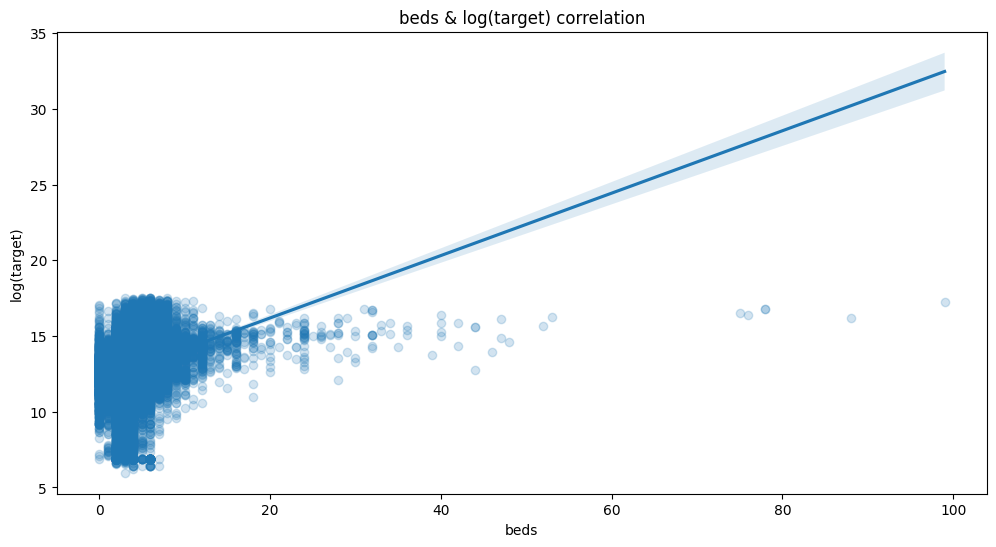

In [66]:
# replace 64 beds with 0 for 'land' property type
data.loc[data.beds == 64, 'beds'] = 0

# look at the correlation
plot_scatter_with_regression(data, 'beds', 'target')

The data have moderate positive correlation

In [67]:
# fill missing values in beds column with median and 0 for land propertyType
bed_median = data.beds.median()
display(bed_median)
data.beds.fillna(bed_median, inplace=True)

# replace by median 0 beds values for not 'land' propertyType
cond = ((data.propertyType != 'land') & (data.propertyType != 'land, other'))
data.loc[cond & (data.beds==0), 'beds'] = bed_median

# add log beds column
data['beds_log'] = np.log(data.beds+1)

3.0

Baths

In [68]:
# look at the unique baths values
data.baths.value_counts()

2 Baths               42628
3 Baths               28484
2                     15869
2.0                   12758
4 Baths               11468
3.0                    8443
Bathrooms: 2           8068
3                      7638
2.5                    6527
Bathrooms: 3           5645
1                      4845
1.0                    4556
2.5 Baths              4358
5 Baths                4210
4.0                    3366
0                      3006
Bathrooms: 1           2659
3.5                    2606
4                      2522
2 ba                   2248
6 Baths                2025
Bathrooms: 4           1939
3.5 Baths              1800
3 ba                   1594
1.5                    1371
1,500                  1224
5.0                    1107
2,000                  1067
1,750                   962
3,000                   952
7 Baths                 880
2,250                   850
5                       841
1,000                   807
4.5                     769
1,250               

In [69]:
# prepare regex dictionary to format bath column
bath_dict = {' Baths$': '',\
            '^Bathrooms: ': '',\
            '\.0$': '',\
            ' ba$': '',\
            ' baths$': '',\
            ',000': '',\
            ',500': '.5',\
            ',750': '.75',\
            ',250': '.25',\
            '\+$': '',\
            '\s?Sq\. Ft\.\s?': 'unknown'

}
# prepare another dict
bath_d = {#'+$': '',\
        '0 / 0': '0',\
        '0.00': '0',\
        '--': 'unknown',\
        '~': 'unknown',\
        '—': 'unknown',\
        '1 / 1-0 / 1-0 / 1-0': 'unknown',\
        '3-1 / 2-2': 'unknown',\
        '2-1 / 2-1 / 1-1 / 1-1':'unknown',\
        '1-0 / 1-0 / 1':'unknown',\
        '116 / 116 / 116': 'unknown',\
        '1 / 1 / 1 / 1': 'unknown',\
        'SemiMod': 'unknown',\
        '1.1': '1.5',\
        '2.1': '2.5',\
        '3.1': '3.5',\
        '4.1': '4.5',\
        '750': 'unknown',\
        '1.8': '1',\
        '2.8': '2',\
        '1-2': '1',\
        '3.2':'3.5',\
        '2.2': '2.5',\
        '5.2': '5.5',\
        '3.3': '3.5'
}

# format baths column using dictionaries and convert to numeric type
data.baths = data.baths.replace(bath_dict, regex=True)

# replace unknown with nan
data.baths = data.baths.replace(bath_d).replace('unknown', np.nan)
data.baths = pd.to_numeric(data.baths)

Before further EDA of baths column will finish with beds column in order to not to fill baths na values to the beds column

In [70]:
# add column where 'bath' in beds column will be filled from baths column
# as outliers and missing values have been already processed in bath column - will duplicate it
data['bed_bath'] = data.beds

# replace data in bed_bath column which contained value 'bath' before (according to the bed_bath_ind column) using formatted baths column
data['bed_bath'].mask((data['bed_bath_ind'] == 1) & data['baths'].notna(), data['baths'], inplace=True)

# floor bed values as there is floats in baths column
data['bed_bath'] = np.floor(data['bed_bath'])

# add log bed_bath column
data['bed_bath_log'] = np.log(data['bed_bath']+1)

# look if everything was replaced correctly
data.loc[data.bed_bath_ind == 1, ['bed_bath', 'beds','baths', 'bed_bath_ind']][:10]

,bed_bath,beds,baths,bed_bath_ind
115,2.000,3.000,2.500,1
182,4.000,3.000,4.000,1
210,3.000,3.000,3.000,1
328,2.000,3.000,2.000,1
332,1.000,3.000,1.500,1
341,1.000,3.000,1.250,1
367,1.000,3.000,1.000,1
574,1.000,3.000,1.750,1
602,1.000,3.000,1.500,1
624,3.000,3.000,NaN,1


Back to Baths column formatting

In [71]:
# let's look at the data with high number of baths
data.query('baths > 30')[['baths', 'propertyType','status', 'beds', 'sqft','target']]

,baths,propertyType,status,beds,sqft,target
21468,40.000,"low rise, multi family",active,32.000,"1,100 sqft",1704000
100708,34.000,multi family,active,34.000,"17,672 sqft",7900000
11118,241.000,"low rise, detached",active,4.000,"Total interior livable area: 3,770 sqft",449000
33504,32.000,multi family,active,28.000,19384,7580000
51615,35.000,multi family,pending,40.000,24307,13000000
69429,40.000,"other, multi family",under contract,30.000,16506,4500000
80120,76.000,multi family,active,32.000,"31,000 sqft",18500000
86760,32.000,"low rise, multi family",active,28.000,"19,384 sqft",7580000
98160,43.000,"low rise, multi family",active,32.000,"22,600 sqft",18500000
110423,55.000,multi family,active,99.000,"30,500",30000000


seems like most of them are like motels or hotels as the are expensive, have a lot of beds and have high area<br>
241 baths - is real outlier will replace it<br>
41 baths in condo with 4 beds also looks like outlier

In [72]:
# replace baths outliers with nan
data.loc[(data.baths==41) & (data.beds== 4), 'baths'] = np.nan
data.loc[(data.baths==241) & (data.beds == 4), 'baths'] = np.nan

25 percentile: 2.0, 75 percentile: 3.0, IQR: 1.0,  Outlier borders: [0.5, 4.5].
Number of Tukey outliers in baths column - 17495

Outliers are detected in log scale
25 percentile: 1.0986122886681098, 75 percentile: 1.3862943611198906, IQR: 0.2876820724517808,  Outlier borders: [0.6670891799904386, 1.8178174697975618].
Number of Tukey outliers in log baths column - 10338

z score lower bound -1.5696409336831505
z score upper bound 6.982422734930109
Number of z score outliers in baths column - 3492

Outliers are detected in log scale
z score lower bound 0.25765218752136476
z score upper bound 2.2502060769795795
Number of z score outliers in log baths column - 4235



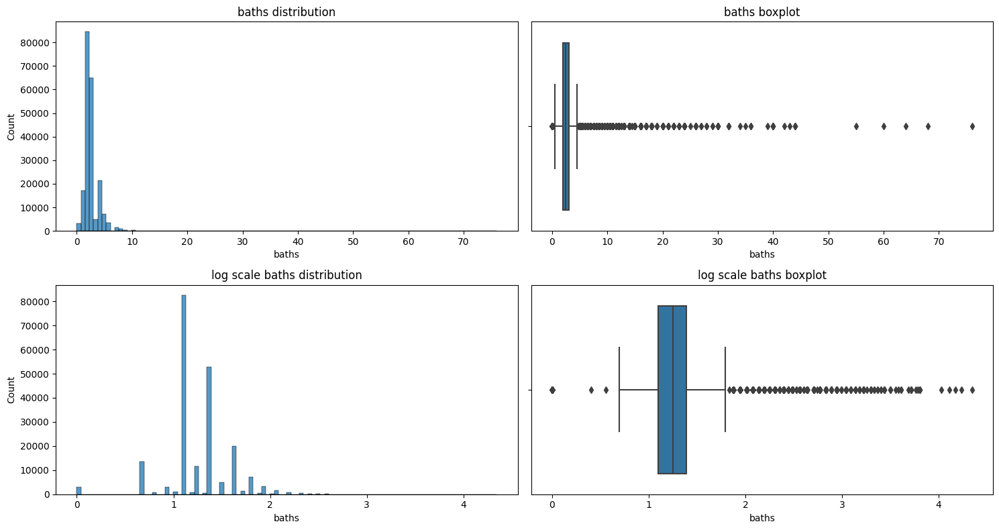

In [73]:
# look at the outliers
col = 'baths'
outliers = outlier_analysis(data, col, m=1, n=100)

0 in baths column is supposed to be 'land' propertyType 

In [74]:
# look at the outlier data description
baths_outl = outliers['outliers_z']
baths_outl[['beds', 'baths', 'target']].describe(include = 'all')

,beds,baths,target
count,3492.000,3492.000,3492.000
mean,7.333,8.916,5014122.700
std,5.606,4.130,5980130.733
min,1.000,7.000,6995.000
25%,5.000,7.000,1599000.000
50%,6.000,8.000,2898500.000
75%,7.000,9.000,5700000.000
max,99.000,76.000,39000000.000


In [75]:
# replace by mode 0 baths value for not 'land' propertyType
cond = ((data.propertyType != 'land') & (data.propertyType != 'land, other'))
data.loc[cond & (data.baths == 0), 'baths'] = data.baths.mode()

# replace by 0 'beds', 'baths', 'story' for land propertyType
data.loc[(data.propertyType == 'land') | (data.propertyType == 'land, other'), ['baths', 'beds', 'story']] = 0

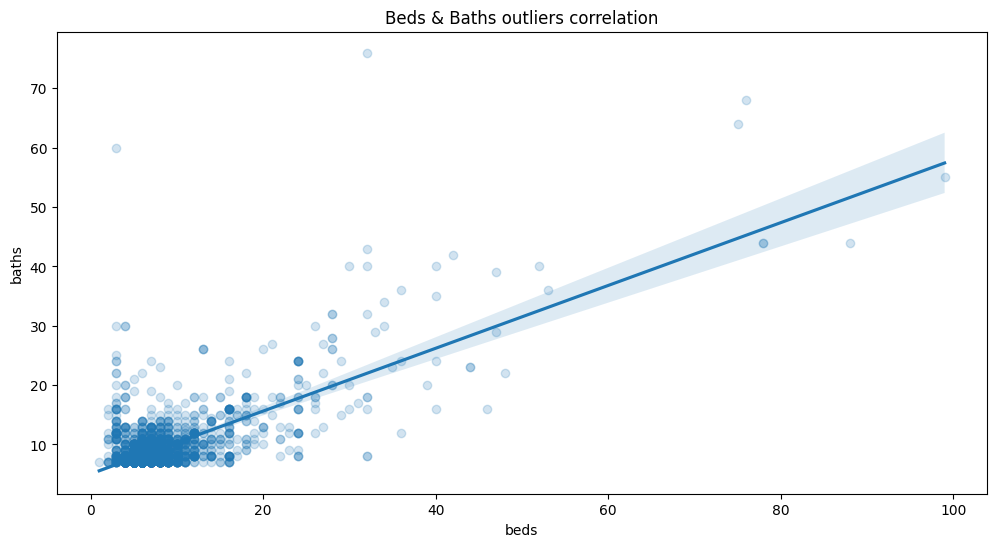

In [76]:
# look at the beds & baths outlier correlation
plt.figure(figsize=(12, 6))
sns.regplot(data=baths_outl, x='beds', y='baths', scatter_kws={'alpha': 0.2})
plt.title(f"Beds & Baths outliers correlation", fontsize=12)
plt.show()

Baths outliers have high target and also high beds number, seems that outliers are hotels with high baths number<br>
There are some outliers with high baths number but low beds number, need to investigate.

In [77]:
data.loc[(data.baths > 20) & (data.beds < 10),['status', 'state', 'propertyType', 'beds', 'baths', 'story', 'target', 'sqft', 'street']]

,status,state,propertyType,beds,baths,story,target,sqft,street
116818,active,TX,"low rise, detached",3.000,25.000,1.000,441888,"2,527 sqft",4406 Avery Way
29189,active,MI,"low rise, multi family",3.000,22.000,2.000,66000,"18,473",2749 Elmhurst St
33459,active,NY,multi family,7.000,24.000,1.000,1199000,"3,240 sqft",11153 44th Ave
55890,active,NY,multi family,6.000,22.000,1.000,999900,"2,700 sqft",13942 86th Rd
133996,active,NY,"low rise, multi family",8.000,23.000,2.000,2199999,"2,560 sqft",919 Avenue T
148218,active,MI,"low rise, multi family",3.000,22.000,2.000,595000,"9,500 sqft",7575 Chrysler Dr #7579
157376,active,NY,"low rise, multi family",5.000,21.000,2.000,1500000,"Total interior livable area: 2,448 sqft",220 Patchen Ave
205029,active,CA,multi family,3.000,24.000,1.000,4752000,11303,5607 Virginia Ave
212285,active,CA,"low rise, multi family",3.000,24.000,2.000,4752000,"11,303 sqft",5607 Virginia Ave
231100,active,MI,"low rise, multi family",4.000,30.000,2.000,138000,2100,209 E Spruce St


It's incorrect outlier data, remove it

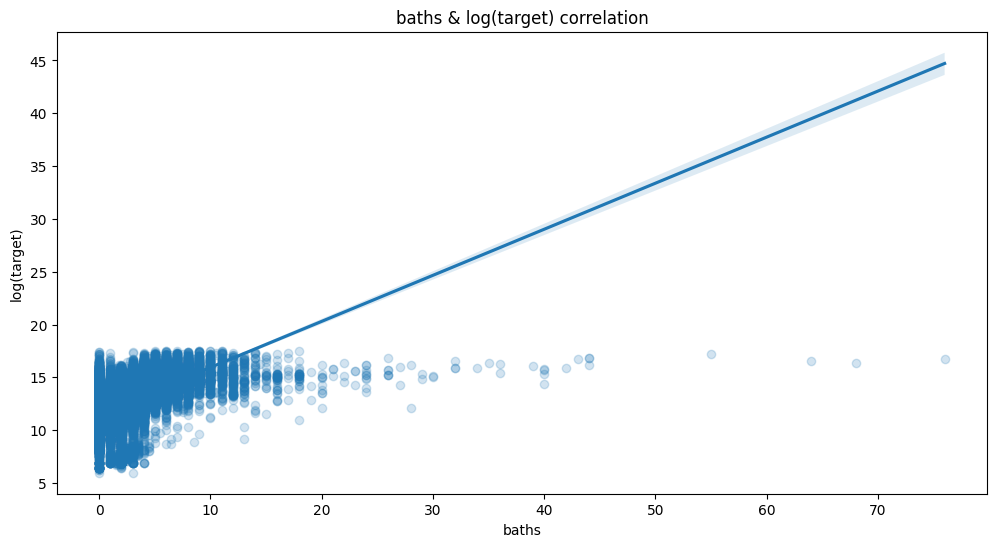

In [78]:
data.drop(data.loc[(data.baths > 20) & (data.beds < 10)].index, inplace=True)

# look at the correlation with target
plot_scatter_with_regression(data, 'baths', 'target')

Seems like the baths column has striong positive correlation with log target

In [79]:
# prepare column which indicates that baths is na
data['baths_na'] = data.baths.apply(lambda x: 1 if pd.isnull(x) else 0)

# fillna with mode value as we have non discrete number of baths but they are rare
bath_mode = data.baths.mode()[0]
display(bath_mode)
data.baths.fillna(bath_mode, inplace=True)

# create log bath column
data['bath_log'] = np.log(data.baths+1)

2.0

#### homeFacts

In [80]:
# encode homefact & schools column
jcols = ['homeFacts', 'schools']
data[jcols] = data[jcols].applymap(ast.literal_eval)

In [81]:
# extract all features from homeFacts column to separate columns
data['year_built'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][0]['factValue'])
data['remodeled'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][1]['factValue'])
data['heating'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][2]['factValue'])
data['cooling_fact'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][3]['factValue'])
data['parking'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][4]['factValue'])
data['lotsize'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][5]['factValue'])
data['price_sqft'] = data.homeFacts.apply(lambda x: x['atAGlanceFacts'][6]['factValue'])

# remove homeFacts column after extracting everything
data.drop('homeFacts', axis=1, inplace=True)

#### schools

In [82]:
# extract all features from schools column to separate columns
data['school_rating'] = data.schools.apply(lambda x: x[0]['rating'])
data['school_distance'] = data.schools.apply(lambda x: x[0]['data']['Distance'])
data['school_grades'] = data.schools.apply(lambda x: x[0]['data']['Grades'])
data['school_name'] = data.schools.apply(lambda x: x[0]['name'])

# remove schools column after extracting everything
data.drop('schools', axis=1, inplace=True)

### Format all new columns

#### lotsize

In [83]:
data.lotsize.value_counts()

                       28517
—                      17817
No Data                 4973
-- sqft lot             3192
0.26 acres              1979
0.25 acres              1915
0.28 acres              1620
0.29 acres              1519
0.27 acres              1497
0.34 acres              1249
6,098 sqft              1239
0.3 acres               1165
4,356 sqft              1129
10,000 sqft             1121
7,405 sqft              1071
6,534 sqft              1049
0.31 acres              1036
5,227 sqft              1020
0.32 acres               990
3,920 sqft               898
0.33 acres               867
0.35 acres               864
0.46 acres               850
8,712 sqft               812
5,000 sqft               812
8,276 sqft               788
10,019 sqft              785
0.36 acres               754
0.37 acres               750
10019                    746
0.5 acres                724
4,792 sqft               697
10000                    672
0.39 acres               628
1 acre        

In [84]:
# prepare column which indicates metrics
data['lotsize_metric'] = data.lotsize.str.lower().apply(lambda x: 'acre' if pd.notnull(x) and 'acre' in x else 'sqft' if pd.notnull(x) and 'sq' in x else 0)

# prepare dict
lot_dict = {'-- sqft lot':np.nan,\
            'no data':np.nan,\
            ' ':np.nan,\
            '—':np.nan}

# prepare regex dict
lot_regex = {'\s?sqft lot$':'',\
            '\s?acre lot':'',\
            '\s? acres': '',\
            '\s?sq\. ft\.':'',\
            '\s?sqft':'',\
            '\s?acre$':'',\
            '\s?lot':'',\
            ',':'',\
            '-':''
}

# format the column
data.lotsize = data.lotsize.str.lower().replace(lot_dict).replace(lot_regex, regex=True)
data.loc[data['lotsize'].str.len() == 0, 'lotsize'] = np.nan

# convert to numeric
data.lotsize = pd.to_numeric(data.lotsize)

# convert acre to sqft
conversion_acre = 43560
data.loc[(data.lotsize_metric == 'acre'), 'lotsize'] = data.loc[(data.lotsize_metric == 'acre'), 'lotsize'] * conversion_acre

# look at the data
# data.lotsize.value_counts().sort_index()

#### price_sqft

In [85]:
# look at the data
data.price_sqft.value_counts()

                      4500
$1/sqft                962
No Data                878
No Info                741
$125/sqft              679
$120/sqft              646
$119/sqft              646
$115/sqft              641
$121/sqft              637
$132/sqft              634
$122/sqft              631
$128/sqft              622
$139/sqft              617
$117/sqft              612
$127/sqft              611
$130/sqft              608
$123/sqft              607
$141/sqft              602
$140/sqft              601
$136/sqft              600
$131/sqft              600
$118/sqft              599
$126/sqft              598
$124/sqft              596
$114/sqft              596
$113/sqft              594
$135/sqft              590
$133/sqft              586
$129/sqft              586
$116/sqft              585
$111/sqft              584
$134/sqft              583
$110/sqft              576
$123                   564
$112/sqft              564
$108/sqft              562
$127                   562
$

In [86]:
# prepare dict
price_dict = {'No Data':np.nan,\
            'No Info':np.nan,\
            ' ':np.nan,\
            'Contact manager':np.nan
}

# prepare regex dict
price_regex = {'\s?\/sqft':'',\
                '^\$':'',\
                ',':'',\
                '\s?\/ Sq\. Ft\.':''
}

# format price_sqft column
data.price_sqft = data.price_sqft.replace(price_dict).replace(price_regex, regex=True)
data.loc[data['price_sqft'].str.len() == 0, 'price_sqft'] = np.nan

# convert to numeric
data.price_sqft = pd.to_numeric(data.price_sqft)

# look at the formatted data
# data.price_sqft.value_counts()

#### bed_area

In [87]:
# look at the data
data.bed_area.value_counts()

-- sqft         66
5,000 sqft      50
1.03 acres      25
1 acre          25
0.26 acres      23
0.34 acres      22
0.28 acres      21
0.27 acres      19
0.29 acres      17
0.3 acres       15
0.5 acres       15
0.46 acres      14
10,018 sqft     13
10,001 sqft     13
0.33 acres      12
6,098 sqft      12
0.43 acres      11
7,840 sqft      11
0.31 acres      11
6,250 sqft      11
2,874 sqft      10
0.4 acres       10
1.24 acres      10
0.32 acres      10
8,712 sqft      10
0.41 acres      10
0.47 acres      10
1.08 acres      10
0.25 acres      10
7,200 sqft       9
0.73 acres       9
0.39 acres       9
0.36 acres       9
6,969 sqft       9
7,501 sqft       8
3,998 sqft       8
5,248 sqft       8
5,227 sqft       8
0.59 acres       8
7,405 sqft       8
8,999 sqft       8
0.35 acres       8
0.52 acres       8
5,662 sqft       8
0.55 acres       8
5 acres          8
0.62 acres       7
0.78 acres       7
5,501 sqft       7
1.01 acres       7
1.5 acres        7
0.37 acres       7
0.38 acres  

In [88]:
# add column to indicate what metric was in bed_area column
data['bed_area_metric'] = data.bed_area.apply(lambda x: 'acre' if pd.notnull(x) and 'acre' in x else 'sqft' if pd.notnull(x) and 'sq' in x else 0)

# prepare dict
bed_area_dict = {'-- sqft':np.nan
}

# prepare regex dict
bed_area_regex = {'\s?sqft':'',\
                '\s?acres':'',\
                ',':'',\
                '\s?acre':''
}

# format data
data.bed_area = data.bed_area.replace(bed_area_dict).replace(bed_area_regex, regex=True)

#convert to numeric
data.bed_area = pd.to_numeric(data.bed_area)

#convert acre to sqft
data.loc[(data.bed_area_metric == 'acre'), 'bed_area'] = data.loc[(data.bed_area_metric == 'acre'), 'bed_area'] * conversion_acre

# look at the formatted data
# data.bed_area.value_counts()

#### SQFT

In [89]:
data.sqft.value_counts()

0                                            9823
1,200 sqft                                    724
1,000 sqft                                    589
1,100 sqft                                    504
1,800 sqft                                    493
1,500 sqft                                    464
2,000 sqft                                    463
1,400 sqft                                    458
800 sqft                                      399
--                                            395
1,600 sqft                                    382
900 sqft                                      376
1,300 sqft                                    362
2,400 sqft                                    326
1,440 sqft                                    320
960 sqft                                      319
2,200 sqft                                    314
3,000 sqft                                    297
2,100 sqft                                    287
750 sqft                                      262


In [90]:
# prepare dicts to format the data
sqft_dict = {'--': np.nan,\
            '-- sqft': np.nan
}
sqft_regex_dict = {'\s?sqft':'',\
                    '\s?Total interior livable area:\s?':'',\
                    ',':''
}

# format the data
data.sqft = data.sqft.replace(sqft_dict).replace(sqft_regex_dict, regex=True)

# there is a range in 1 row replace it manually
sqft_mean = np.mean([610,840])
data.sqft = data.sqft.replace('610-840', sqft_mean)

# convert to numeric
data.sqft = pd.to_numeric(data.sqft)
# look at the data
# data.sqft.value_counts()

#### Work with all columns which are connected with property size

In [91]:
# add column which will calculate difference between sqft and lotsize
data['sqft_lotsize_dif'] = data.sqft - data.lotsize

/tmp/ipykernel_67259/389398074.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<AxesSubplot: >

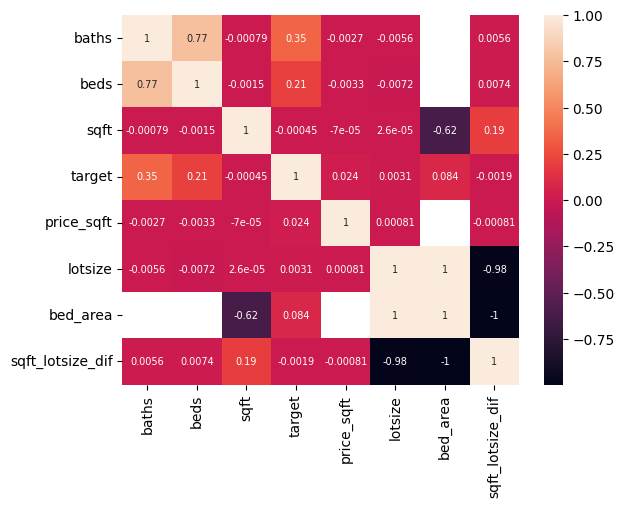

In [92]:
# look at the correlation between columns which are connected with property size
sns.heatmap(data[['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target','price_sqft', 'lotsize'\
                , 'lotsize_metric', 'bed_area', 'bed_area_metric', 'sqft_lotsize_dif']].corr(), annot=True,  annot_kws={"size": 7})

Lotsize does not correlate with sqft, will leave 2 separate columns. But sqft_lotsize_dif correlates with lotsize and bed_area, need to remove it.

<AxesSubplot: >

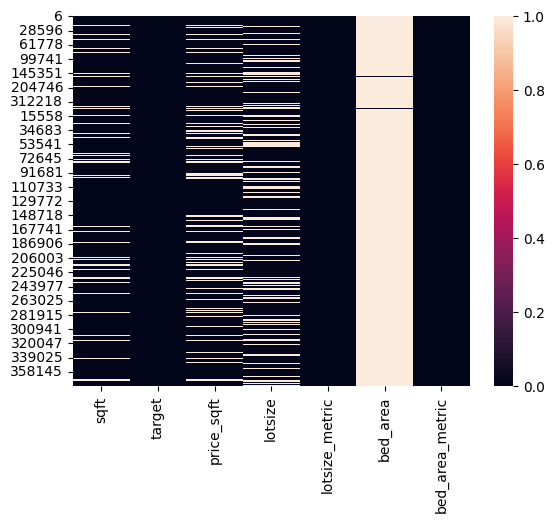

In [93]:
data.drop('sqft_lotsize_dif', axis=1, inplace=True)

# look at the Na correlation in these columns
sns.heatmap(data[['sqft','target','price_sqft', 'lotsize', 'lotsize_metric', 'bed_area', 'bed_area_metric']].isna())

Seems like bed_area has values in place where both lotsize and sqft columns has Nan's, need to look deeper

Bed area

In [94]:
# look at the not na bed area data
data.loc[~data.bed_area.isna(), ['sqft','target','price_sqft', 'lotsize', 'lotsize_metric', 'bed_area', 'bed_area_metric']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1670 entries, 279 to 377183
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   sqft             4 non-null      float64
 1   target           1670 non-null   int64  
 2   price_sqft       1 non-null      float64
 3   lotsize          25 non-null     float64
 4   lotsize_metric   1670 non-null   object 
 5   bed_area         1670 non-null   float64
 6   bed_area_metric  1670 non-null   object 
dtypes: float64(4), int64(1), object(2)
memory usage: 104.4+ KB


In [95]:
# look at the not na bed area data
data.loc[(~data.bed_area.isna()) & (~data.lotsize.isna()) & (data.lotsize_metric == data.bed_area_metric)\
        , ['sqft','target','price_sqft', 'lotsize', 'lotsize_metric', 'bed_area', 'bed_area_metric']]

,sqft,target,price_sqft,lotsize,lotsize_metric,bed_area,bed_area_metric
3434,1076.000,20500,NaN,6351.000,sqft,6351.000,sqft
6694,NaN,24900,NaN,5662.000,sqft,5662.000,sqft
13622,NaN,75000,NaN,30927.600,acre,30927.600,acre
17990,NaN,18500,NaN,78408.000,acre,78408.000,acre
22755,NaN,70000,NaN,13939.200,acre,13939.200,acre
41833,NaN,39900,NaN,27442.800,acre,27442.800,acre
122730,NaN,70000,NaN,12632.400,acre,12632.400,acre
214474,NaN,24900,NaN,8276.000,sqft,8276.000,sqft
219072,NaN,1000,NaN,640.000,sqft,640.000,sqft
248383,NaN,24900,NaN,5227.000,sqft,5227.000,sqft


Seems like bed_area column has the same data as lotsize column, will fillna in lotsize column using bed_area column

In [96]:
# fill na in lotsize column using bed area column
data.loc[(data.lotsize.isna()) & (~data.bed_area.isna()), 'lotsize'] = data.loc[(data.lotsize.isna()) & (~data.bed_area.isna()), 'bed_area']

# remove bed area columns
data.drop(['bed_area', 'bed_area_metric'], axis=1, inplace=True)

Sqft

25 percentile: 1236.0, 75 percentile: 2556.0, IQR: 1320.0,  Outlier borders: [-744.0, 4536.0].
Number of Tukey outliers in sqft column - 13462

Outliers are detected in log scale
25 percentile: 7.1204443723924875, 75 percentile: 7.846589975291186, IQR: 0.7261456028986988,  Outlier borders: [6.031225968044439, 8.935808379639234].
Number of Tukey outliers in log sqft column - 14423

z score lower bound -5419311.314710881
z score upper bound 5435077.822279927
Number of z score outliers in sqft column - 4

Outliers are detected in log scale
z score lower bound 2.5439879451538143
z score upper bound 11.970941763485614
Number of z score outliers in log sqft column - 10346



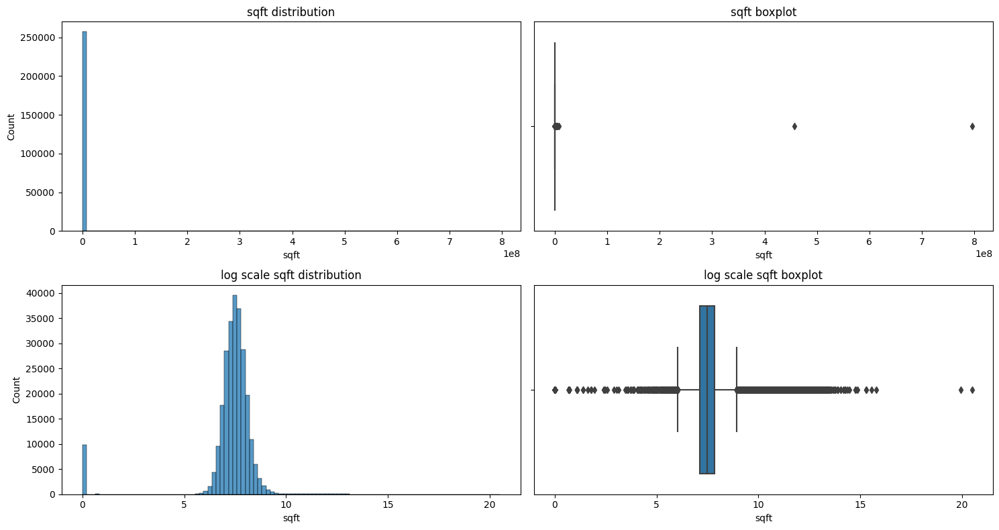

In [97]:
# look at the outliers
col = 'sqft'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scale sqft data looks better & normally distributed, will use log values<br>
There is a 0+1 sqft peak in log histogram as there is a lot of 0 values in sqft column<br>
Seems there are some high outliers in non log data need to replace it <br>

In [98]:
# look at some sqft low border outliers
sqft_outl_z_log = outliers['outliers_z_log']
sqft_outl_z_log.loc[(sqft_outl_z_log.sqft>=1) & (sqft_outl_z_log.sqft<100), ['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target'\
                                                                            ,'price_sqft', 'lotsize', 'lotsize_metric']][:15]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,lotsize_metric
5961,foreclosure,land,0.000,0.000,1.000,NaN,1499000,1499000.000,NaN,0
93500,active,"low rise, multi family",2.000,4.000,1.000,1.0,579000,579000.000,5440.000,sqft
100150,active,townhome,2.000,3.000,1.000,NaN,5000000,5000000.000,3920.000,sqft
101146,active,land,0.000,0.000,1.000,NaN,1950000,1950000.000,17424.000,acre
120342,active,land,0.000,0.000,1.000,NaN,5950000,5950000.000,548420.400,acre
148964,active,unknown,2.000,3.000,1.000,NaN,649900,649900.000,28749.600,acre
154962,active,detached,3.000,4.000,2.000,NaN,4650000,2325000.000,NaN,0
187952,active,"low rise, detached",2.000,3.000,1.000,1.0,129900,129900.000,17859.600,acre
188168,active,land,0.000,0.000,1.000,NaN,639900,639900.000,63162.000,acre
214211,active,"low rise, land",2.000,3.000,1.000,1.0,250000,250000.000,192970.800,acre


In [99]:
# look at some sqft high border outliers
sqft_outl_z_log.loc[(sqft_outl_z_log.sqft>100), ['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target','price_sqft', 'lotsize'\
                                                , 'lotsize_metric']][:15]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,lotsize_metric
4604,active,land,0.000,0.000,1043741.000,NaN,1200000,1.000,1043697.600,acre
19999,active,land,0.000,0.000,220850.000,NaN,140000,1.000,220849.200,acre
26247,active,unknown,2.000,3.000,407334.000,NaN,175000,NaN,407286.000,acre
37394,active,land,0.000,0.000,2585006.000,NaN,138000,0.000,25700.400,acre
46380,active,coop,4.000,3.000,273583.000,NaN,32500000,NaN,22651.200,acre
56001,active,land,0.000,0.000,288588.000,NaN,1200000,4.000,287496.000,acre
65574,active,coop,2.000,2.000,191476.000,NaN,928000,NaN,27007.200,acre
70119,active,land,0.000,0.000,268766.000,NaN,1999999,7.000,NaN,0
112552,active,"high rise, coop",2.000,2.000,651914.000,14.0,695000,1.000,82328.400,acre
119064,active,"low rise, coop",2.000,2.000,158600.000,1,269999,2.000,106286.400,acre



Need to fill sqft outliers with median per property or just median.

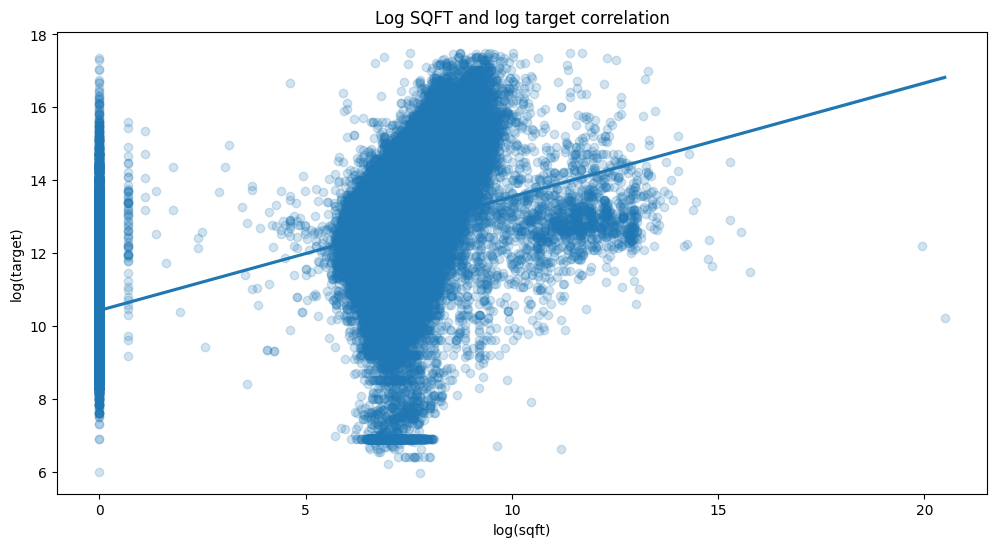

In [100]:
# look at log sqft & log target correlation
plt.figure(figsize=(12, 6))
sns.regplot(data=data, x=np.log(data['sqft']+1), y=np.log(data['target']), scatter_kws={'alpha': 0.2})
plt.title(f"Log SQFT and log target correlation", fontsize=12)
plt.ylabel('log(target)')
plt.xlabel('log(sqft)')
plt.show()

There are sqft outliers with 0 value<br>
According to the regplot line there is a positive correlation between sqft column and target

SQFT NA & outliers filling

In [101]:
# create column which will indicate na and outlier in sqft column
data['sqft_na_outl'] = 0
data.loc[(data.sqft.isna()) | (data.index.isin(sqft_outl_z_log.index)), 'sqft_na_outl'] = 1

# create sqft median column where all na will be replaced with sqft median
sqft_median = data.sqft.median()
data['sqft_med_na'] = data.sqft
data.loc[(data.sqft.isna()), 'sqft_med_na'] = sqft_median

# create sqft median column where all na and outliers will be replaced with sqft median
data['sqft_med'] = data.sqft
data.loc[(data.sqft.isna()) | (data.index.isin(sqft_outl_z_log.index)), 'sqft_med'] = sqft_median

# create sqft column with -1 replacement na and outliers
data['sqft_value_na_out'] = data.sqft
data.loc[(data.sqft.isna()) | (data.index.isin(sqft_outl_z_log.index)), 'sqft_value_na_out'] = -1

# create sqft column with -1 replacement na 
data['sqft_value_na'] = data.sqft
data.loc[(data.sqft.isna()), 'sqft_value_na'] = -1

# create sqft column where all na and outliers will be replaced according to target and price_sqft column, could lead to data leakage
data['sqft_cor'] = data.sqft
data.loc[(data.sqft.isna()) | (data.index.isin(sqft_outl_z_log.index)), 'sqft_cor'] = data.apply\
        (lambda x: sqft_median if pd.isna(x.price_sqft) or x.price_sqft==0 else x.target/x.price_sqft, axis = 1)

# try log value
data['sqft_value_na_log'] = np.log(data.sqft_value_na+2)
data['sqft_med_na_log'] = np.log(data.sqft_med_na+2)

# create sqft median log column where all na, low and high sqft values will be replaced with sqft median
data['sqft_med_na_log_1'] = data.sqft_med_na
data.loc[(data.sqft < 100) | (data.sqft > 400000000), 'sqft_med_na_log_1'] = sqft_median
data['sqft_med_na_log_1'] = np.log(data['sqft_med_na_log_1'])

Price_sqft

25 percentile: 121.0, 75 percentile: 300.0, IQR: 179.0,  Outlier borders: [-147.5, 568.5].
Number of Tukey outliers in price_sqft column - 21596

Outliers are detected in log scale
25 percentile: 4.804021044733257, 75 percentile: 5.707110264748875, IQR: 0.9030892200156186,  Outlier borders: [3.449387214709829, 7.061744094772303].
Number of Tukey outliers in log price_sqft column - 10562

z score lower bound -63477.62579821284
z score upper bound 64450.22391086148
Number of z score outliers in price_sqft column - 67

Outliers are detected in log scale


z score lower bound 2.591680267583015
z score upper bound 7.891278831813915
Number of z score outliers in log price_sqft column - 3500



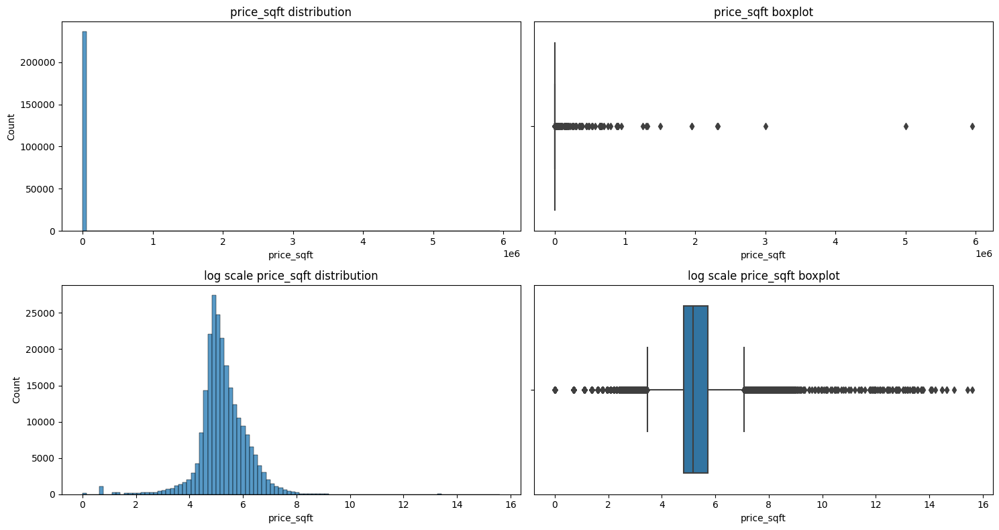

In [102]:
# look at the outliers
col = 'price_sqft'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scale price_sqft data looks better with normal distribution with right tail.

In [103]:
# look for price_sqft outliers
outl_z_log = outliers['outliers_z_log']
outl_z_log[['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target','price_sqft', 'lotsize'\
                                , 'lotsize_metric']][:40]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,lotsize_metric
2261,active,"low rise, multi family",3.000,4.000,2261.000,2.0,28000,12.000,3811.000,sqft
2299,active,"low rise, land",2.000,3.000,68868.000,1.0,785000,11.000,68824.800,acre
2534,active,unknown,2.250,3.000,23781.000,NaN,99900,4.000,NaN,0
2535,active,"low rise, traditional",1.500,3.000,2200.000,1,8000000,3636.000,NaN,0
2672,price change,unknown,2.000,3.000,30000.000,NaN,74900,2.000,30056.400,acre
2823,active,land,0.000,0.000,51400.000,NaN,230000,4.000,51400.800,acre
3596,foreclosure,"low rise, detached",1.000,2.000,1064.000,0.0,8000,8.000,2548.000,sqft
3747,active,"coop, mid rise",2.000,2.000,46500.000,6,249000,5.000,13068.000,acre
3834,active,land,0.000,0.000,1050.000,NaN,1000,1.000,4791.000,sqft
3879,active,unknown,2.000,3.000,2125.000,NaN,10001,5.000,2125.000,sqft


Need to replace price_sqft outliers

Price_sqft na & outliers filling

In [104]:
# create column to indicate price_sqft na
data['price_sqft_na'] = data.price_sqft.apply(lambda x: 1 if pd.isna(x) else 0)

# create column to indicate price_sqft na and outliers
data['price_sqft_na_outl'] = 0
data.loc[(data.price_sqft.isna()) | (data.index.isin(outl_z_log.index)), 'price_sqft_na_outl'] = 1

# create column where all price_sqft na, outliers and price_sqft == target replaced by median 
price_median = data.price_sqft.median()
data['price_sqft_na_out_med'] = data.price_sqft
data.loc[(data.price_sqft.isna()) | (data.index.isin(outl_z_log.index)), 'price_sqft_na_out_med'] = price_median
data.loc[(data.target == data.price_sqft), 'price_sqft_na_out_med'] = price_median

Lotsize

25 percentile: 5227.0, 75 percentile: 15245.999999999998, IQR: 10018.999999999998,  Outlier borders: [-9801.499999999996, 30274.499999999993].
Number of Tukey outliers in lotsize column - 31221

Outliers are detected in log scale
25 percentile: 8.561784074744113, 75 percentile: 9.632138041371906, IQR: 1.0703539666277937,  Outlier borders: [6.956253124802422, 11.237668991313598].
Number of Tukey outliers in log lotsize column - 21860

z score lower bound -30727191.77562062
z score upper bound 31028259.615522217
Number of z score outliers in lotsize column - 67

Outliers are detected in log scale
z score lower bound 5.060561242929895
z score upper bound 13.325706647021642
Number of z score outliers in log lotsize column - 3679



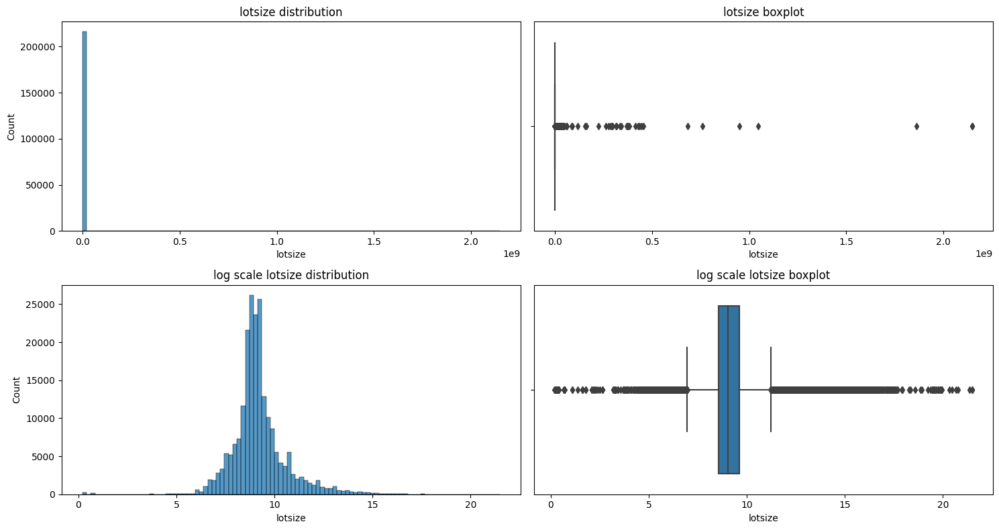

In [105]:
# look at the outliers
col = 'lotsize'
outliers = outlier_analysis(data, col, m=1, n=100)

log scale lotsize data looks normally distributed with right tail

In [106]:
# look at log z score outliers
outl_z_log = outliers['outliers_z_log']
outl_z_log[['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target','price_sqft', 'lotsize', 'lotsize_metric']][:20]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,lotsize_metric
73,active,"low rise, detached",4.000,4.000,3928.000,1.0,1785000,454.000,1106859.600,acre
629,active,land,0.000,0.000,0.000,NaN,851850,NaN,2473772.000,0
678,active,land,0.000,0.000,0.000,NaN,32000,NaN,0.230,0
755,unknown,"low rise, detached",2.000,4.000,1679.000,2,119900,71.000,3267000.000,acre
2139,active,"condo, low rise",1.000,1.000,573.000,1.0,69500,121.000,25.000,sqft
2251,active,land,0.000,0.000,NaN,NaN,150000,NaN,1785088.800,acre
2529,active,detached,4.000,3.000,3846.000,NaN,525000,137.000,744004.800,acre
2622,active,land,0.000,0.000,0.000,NaN,220000,NaN,853776.000,0
2655,active,land,0.000,0.000,NaN,NaN,749000,NaN,1666605.600,acre
2658,active,other,2.000,3.000,NaN,NaN,535000,NaN,2983860.000,acre


Lotsize NA & outliers filling

In [107]:
# create column to indicate na and outliers in lotsize column
data['lotsize_na_out'] = 0
data.loc[(data.lotsize.isna()) | (data.index.isin(outl_z_log.index)), 'lotsize_na_out'] = 1

# create column to indicate na in lotsize column
data['lotsize_na'] = data.lotsize.apply(lambda x: 1 if pd.isna(x) else 0)

# calculate lotsize median
lotsize_median = data.lotsize.median()

# create column where all lotsize na replaced by median
data['lotsize_med_na'] = data['lotsize']
data.loc[(data.lotsize.isna()), 'lotsize_med_na'] = lotsize_median

# create column where all lotsize na and outliers replaced by median
data['lotsize_med'] = data['lotsize']
data.loc[(data.lotsize.isna()) | (data.index.isin(outl_z_log.index)), 'lotsize_med'] = lotsize_median

# create column where all lotsize na and outliers replaced by median per property type - as str
data['lotsize_med_prop_1'] = data['lotsize']
# Calculate the median lotsize per propertyType as str
data_for_dict = data[['propertyType', 'lotsize']]
data_for_dict.propertyType = data_for_dict.propertyType.astype(str)
median_lotsize_per_type = data_for_dict.groupby('propertyType')['lotsize'].median()
median_lotsize_per_type.fillna(lotsize_median, inplace=True)
# create mask to select the row
missing_lotsize_rows = data['lotsize'].isna() | data.index.isin(outl_z_log.index)
# fill the data
data.loc[missing_lotsize_rows, 'lotsize_med_prop_1'] = data.loc[missing_lotsize_rows, 'propertyType'].apply(
        lambda x: median_lotsize_per_type.get(str(x), lotsize_median))

/tmp/ipykernel_67259/477205186.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



#### Parking

In [108]:
# look at the data description
data.parking.describe()

count     288579
unique      2721
top             
freq      131978
Name: parking, dtype: object

In [109]:
# as there are a lot of unique categories, will look only for most common ones, but need to format a little before
# prepare dict to format the column
parking_dict = {'No Data': np.nan,\
                '888': np.nan,\
                'No Garage': '0',\
                'No Parking': '0',\
                'No':'0',\
                'None':'0',\
                # 'Deed Restrictions, No Truck/RV/Motorcycle Parking'
                'No Signs, Parking Restrictions, Pet Restrictions':'0',\
                'No Signs, Parking Restrictions, Pets Allowed':'0',\
                'No Signs, Parking Restrictions':'0',\
                'No Leasing, No Signs, Parking Restrictions, Pet Restrictions, Pets Allowed, Prior Apprvl- Sale':'0',\
                'PARKING DESCRIPTION': 'parking desc',\
                'Gar-Dble-Att': 'double attached garage'
    }

# prepare regex dict
parking_reg={'\s?spaces':'',\
            '\s?space': '',\
            "attch'd": 'attached',\
            'dtach':'detached',\
            'adtch':'attached',\
            'gravl':'gravel',\
            'aspht':'asphalt',\
            'drvwy':'driveway',\
            'drv':'driveway',\
            'attchd':'attached',\
            '\sgar\s':' garage ',\
            'bsmt': 'basement parking space'
}

# format the data
data.loc[data['parking'].str.len() == 0, 'parking'] = np.nan
data.parking = data.parking.replace(parking_dict).str.lower().replace(parking_reg, regex= True)

# look at the formatted data
# data.parking.value_counts()

In [110]:
# split the parking type by ', '
split_parking = data.parking.apply(lambda x: re.split(r',\s?', x) if isinstance(x, str) else None)

# count number of all unique values in parking type before deeper formatting
# split_parking.explode().value_counts()

In [111]:
# create column which indicate if there any parking place
# 1 if anything was in parking column except '0' or 'no truck\rv...'
data['parking_any'] = data.parking.apply(lambda x: 1 if pd.notna(x) and x!='0' and 'no ' not in x else 0)
# exception for 'no covered parking'
data.loc[data.parking == 'drive-circular, drive-concrete, drive-private, no covered parking, parking pad', 'parking_any'] = 1

# create column to indicate attached
data['parking_attach'] = data.parking.apply(lambda x: 1 if  isinstance(x, str) and 'attach' in x else 0)

# create column to indicate detached
data['parking_det'] = data.parking.apply(lambda x: 1 if isinstance(x, str) and 'detach' in x else 0)

# create column to indicate garage
data['parking_gar'] = data.parking.apply(lambda x: 1 if isinstance(x, str) and 'gar' in x else 0)

# create column to indicate number of parking spaces
data['parking_number'] = data.parking.apply(get_parking_number)

25 percentile: -1.0, 75 percentile: 1.0, IQR: 2.0,  Outlier borders: [-4.0, 4.0].
Number of Tukey outliers in parking_number column - 2377

Outliers are detected in log scale
25 percentile: 0.0, 75 percentile: 1.0986122886681098, IQR: 1.0986122886681098,  Outlier borders: [-1.6479184330021646, 2.7465307216702746].
Number of Tukey outliers in log parking_number column - 219

z score lower bound -30.452688237591865
z score upper bound 30.944556339232
Number of z score outliers in parking_number column - 85

Outliers are detected in log scale
z score lower bound -1.253654313239243
z score upper bound 2.4483235940356924
Number of z score outliers in log parking_number column - 432



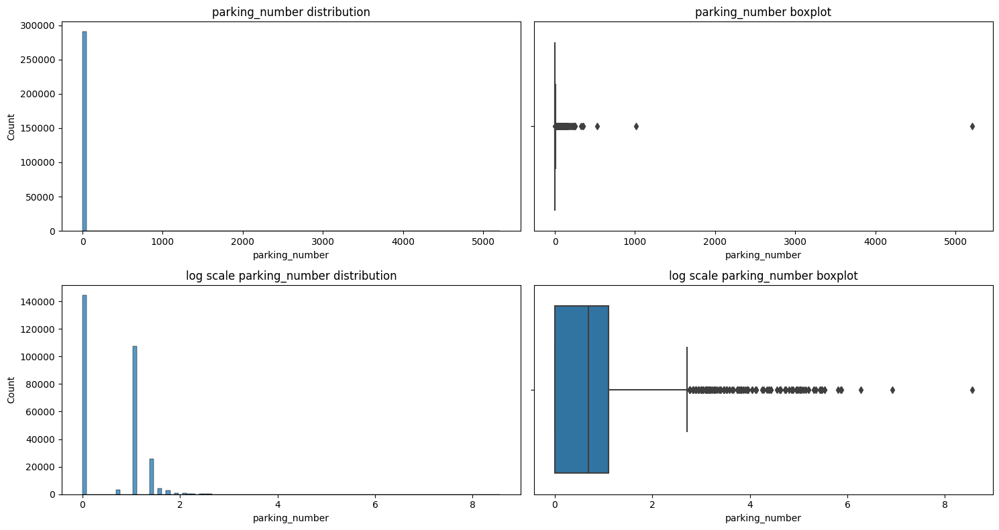

In [112]:
# look at the outliers
col = 'parking_number'
outliers = outlier_analysis(data, col, m=2, n=100)

Seems like log scale doesn't help in case of parking_number column, it doesn't have normal distribution<br>
There are not so much outliers here

In [113]:
# look at the data with high parking_number values (between 10 and 20)
data.loc[ (data.parking_number>10) & (data.parking_number<20), ['parking_number','parking_gar','parking_det', 'parking_attach', \
    'parking_any','parking', 'target','status','propertyType','baths', 'beds']][:20]

,parking_number,parking_gar,parking_det,parking_attach,parking_any,parking,target,status,propertyType,baths,beds
10309,12,0,0,0,1,12,32000000,active,"low rise, detached",17.000,11.000
16436,14,0,0,0,1,14,4495000,active,"low rise, detached",7.000,7.000
17254,11,0,0,0,1,11,2545900,active,detached,10.000,6.000
25886,12,0,0,0,1,12,2180000,active,"low rise, detached",6.000,5.000
26283,12,0,0,0,1,12,5795000,unknown,"low rise, detached",10.000,6.000
32235,12,0,0,0,1,12,800000,active,"low rise, multi family",10.000,10.000
36378,11,0,0,0,1,11,6000000,active,"low rise, detached",8.000,5.000
44774,12,0,0,0,1,12,850000,unknown,"low rise, detached",4.000,5.000
46548,11,0,0,0,1,11,2450000,active,"low rise, detached",5.000,4.000
47939,12,0,0,0,1,12,499000,unknown,"low rise, detached",4.000,4.000


In [114]:
# look at the data with high parking_number values > 30
data.loc[ (data.parking_number>30), ['parking_number','parking_gar','parking_det', 'parking_attach', \
    'parking_any','parking', 'target','status','propertyType','baths', 'beds']][:20]

,parking_number,parking_gar,parking_det,parking_attach,parking_any,parking,target,status,propertyType,baths,beds
20794,55,0,0,0,1,55,15000000,active,"low rise, multi family",2.000,3.000
34246,120,0,0,0,1,120,15000,unknown,detached,2.000,3.000
41656,93,0,0,0,1,93,450000,unknown,condo,2.000,2.000
62209,140,0,0,0,1,140,239000,active,"condo, high rise",2.000,3.000
66428,210,0,0,0,1,210,250000,active,"low rise, detached",2.000,3.000
73099,82,0,0,0,1,82,285000,unknown,"condo, low rise",2.000,2.000
99771,99,0,0,0,1,99,1050000,active,"low rise, detached",1.000,1.000
100402,131,0,0,0,1,131,349900,active,"condo, low rise",1.000,1.000
105424,36,0,0,0,1,36,85000,unknown,"low rise, townhome",2.000,1.000
110174,50,0,0,0,1,50,210000,active,"condo, low rise",3.000,2.000


In [115]:
# replace outlier (parking_number > 10) by median parking number where beds or baths < 10
median_parking = data.parking_number.median()
conditions = (data['parking_number'] > 10) & ((~data['baths'].gt(10)) | (~data['beds'].gt(10)))
data.loc[conditions, 'parking_number'] = median_parking

# remove parking column
data.drop('parking', axis=1, inplace=True)

#### Year_built

In [116]:
# look at the data
data.year_built.value_counts()

                51246
2019            25325
2006             5973
2005             5577
2007             5291
2018             5044
2004             4165
2017             3958
2016             3810
2008             3641
1920             3556
2003             3445
1950             3397
1925             3387
2002             3223
2001             3121
2015             2832
1960             2711
2000             2705
1955             2671
1999             2528
1974             2523
1979             2487
1973             2484
1980             2469
1972             2460
1930             2423
1940             2343
1998             2309
1984             2308
2014             2306
1981             2291
1985             2285
1970             2247
1978             2234
1989             2190
1997             2186
1986             2163
1900             2162
1983             2114
1987             2082
1990             2067
1965             2035
1988             2035
1996             1998
1956      

In [117]:
# prepare dictionary
year_dict = {'559990649990': np.nan,\
            '1': np.nan,\
            'No Data':np.nan
}

# format the column
data.loc[data['year_built'].str.len() == 0, 'year_built'] = np.nan
data.year_built = data.year_built.replace(year_dict)
data.year_built = pd.to_numeric(data.year_built)

# look at the data
# data.year_built.value_counts().sort_index()

25 percentile: 1956.0, 75 percentile: 2007.0, IQR: 51.0,  Outlier borders: [1879.5, 2083.5].


Number of Tukey outliers in year_built column - 676

Outliers are detected in log scale
25 percentile: 7.579167967396076, 75 percentile: 7.60489448081162, IQR: 0.02572651341554355,  Outlier borders: [7.540578197272761, 7.643484250934935].
Number of Tukey outliers in log year_built column - 953

z score lower bound 1876.2949503513933
z score upper bound 2081.672724261155
Number of z score outliers in year_built column - 643

Outliers are detected in log scale
z score lower bound 7.538378228757383
z score upper bound 7.643007430735377
Number of z score outliers in log year_built column - 657



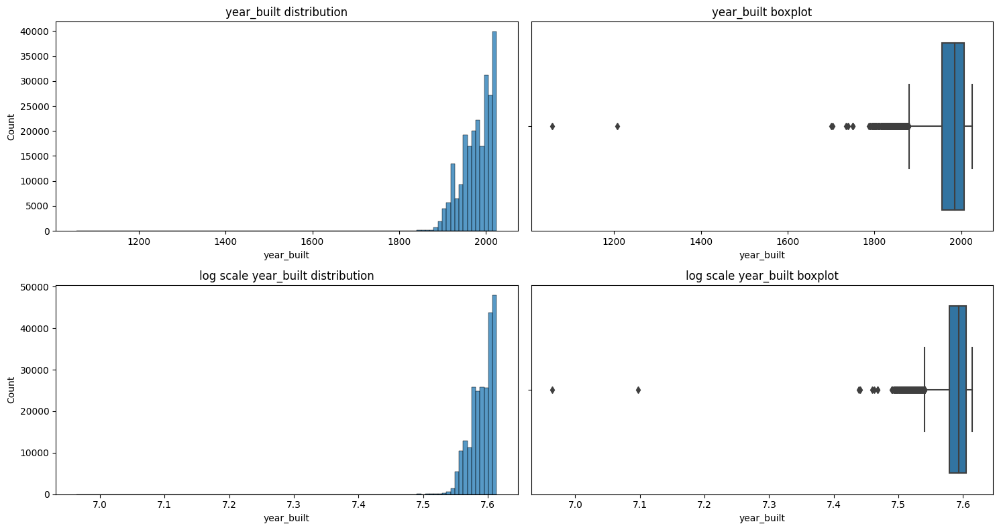

In [118]:
# look at the outliers
col = 'year_built'
outliers = outlier_analysis(data, col, m=1, n=100)

Both nonlog and log data don't have normal distribution. Will use Tukey outlier detection and look deeper into outlier data.<br>
There is a values starting from 1060 in year_built which is really old - outlier

In [119]:
# look at outliers
cols = ['status', 'propertyType', 'baths', 'beds', 'sqft', 'stories', 'target', 'price_sqft', 'lotsize', 'year_built', 'remodeled']
outliers['outliers_tukey'].loc[outliers['outliers_tukey'].year_built < 1800, cols][:30]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,year_built,remodeled
50661,under contract,"condo, townhome, row, low rise, coop",3.000,2.000,2145.000,3,1695000,790.000,4299.000,1794.000,
81327,active,townhome,6.000,4.000,4900.000,NaN,2095000,428.000,2613.000,1796.000,None
174111,active,"low rise, townhome",1.000,2.000,912.000,2.0,2800000,3070.000,435.000,1703.000,None
2064,active,"low rise, detached",10.000,13.000,7366.000,1.0,1425000,193.000,141570.000,1740.000,2016
2410,active,"low rise, land",2.000,3.000,3380.000,2.0,249000,74.000,40075.200,1700.000,
23118,foreclosure,"low rise, detached",2.000,3.000,2348.000,1.0,89714,38.000,6172.000,1799.000,
54270,active,"low rise, detached",3.500,3.000,3867.000,2,568000,147.000,13068.000,1795.000,
66331,active,land,0.000,0.000,0.000,NaN,290000,NaN,435600.000,1799.000,
90721,pending,"low rise, detached",2.000,4.000,2378.000,2.0000,149900,63.000,217800.000,1795.000,
149924,pending,detached,2.000,3.000,1208.000,NaN,79000,65.000,NaN,1208.000,


In [120]:
# create column to indicate na in year_built column
data['year_built_na'] = data.year_built.apply(lambda x: 1 if pd.isna(x) else 0)

# replace na with median
med_year_built = data.year_built.median()
data.loc[ data.year_built.isna(), 'year_built'] = med_year_built
display(med_year_built)

# replace year_built outliers
data.loc[data.year_built < 1600, 'year_built'] = med_year_built
data.loc[data.year_built < 1800, 'year_built'] = 1800

1985.0

#### Remodeled

In [121]:
# look at the data
data.remodeled.value_counts()

        163484
2006      3995
2005      3515
2007      3145
2008      2619
2004      2442
1980      2369
2000      2186
1985      2055
1970      2053
2003      2043
2002      1953
1990      1915
1975      1848
1965      1807
2001      1782
1995      1740
1988      1655
1983      1615
1998      1512
1978      1509
1981      1494
1999      1485
1960      1444
1996      1404
2014      1398
1982      1382
1984      1365
1972      1355
1989      1325
1979      1317
1986      1311
1962      1310
1974      1308
1950      1304
1997      1277
1987      1266
1993      1253
1973      1236
1994      1211
2010      1169
2009      1168
1955      1124
2013      1114
2019      1113
1992      1090
1977      1058
1991      1051
2012      1044
2015      1032
1920      1032
1968      1012
2018      1000
1971       968
1930       947
1925       944
2011       942
2016       923
1976       895
1969       868
1940       843
2017       841
1963       841
1966       771
1952       746
1956       722
1958      

In [122]:
data.remodeled.info()

<class 'pandas.core.series.Series'>
Int64Index: 290830 entries, 6 to 377183
Series name: remodeled
Non-Null Count   Dtype 
--------------   ----- 
270606 non-null  object
dtypes: object(1)
memory usage: 12.5+ MB


25 percentile: 1968.0, 75 percentile: 2004.0, IQR: 36.0,  Outlier borders: [1914.0, 2058.0].
Number of Tukey outliers in remodeled column - 1793

Outliers are detected in log scale
25 percentile: 7.585281078639126, 75 percentile: 7.60339933974067, IQR: 0.018118261101544242,  Outlier borders: [7.55810368698681, 7.630576731392987].
Number of Tukey outliers in log remodeled column - 2065

z score lower bound 1905.4754293558283
z score upper bound 2059.5581004411592
Number of z score outliers in remodeled column - 981

Outliers are detected in log scale
z score lower bound 7.553305493036339
z score upper bound 7.631778073060881
Number of z score outliers in log remodeled column - 1010



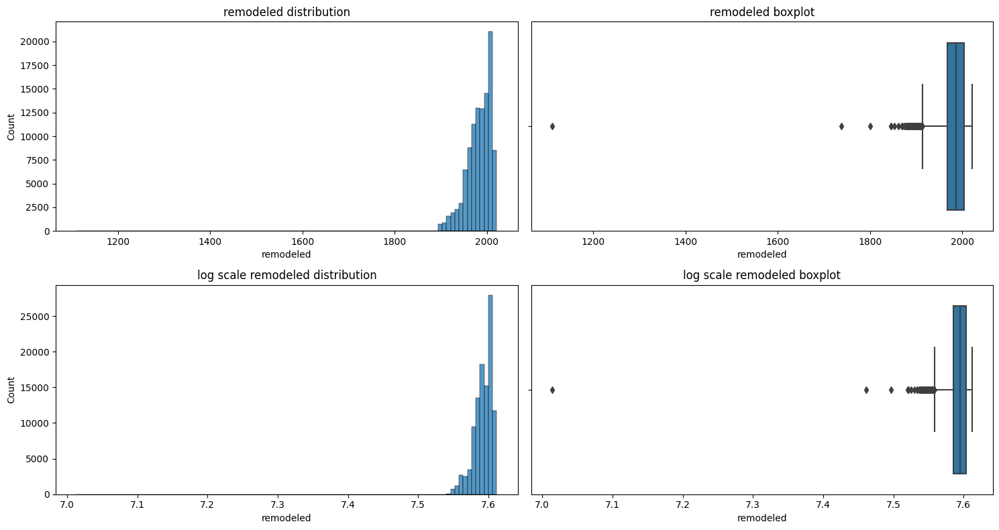

In [123]:
# format the data
data.remodeled = data.remodeled.replace('0', np.nan)
data.loc[data['remodeled'].str.len() == 0, 'remodeled'] = np.nan
data.remodeled = pd.to_numeric(data.remodeled)

# look at the outliers
col = 'remodeled'
outliers = outlier_analysis(data, col, m=1, n=100)

As it was in year_built column, remodeled column both nonlog and log data don't have normal distribution. Will use Tukey outlier detection and look deeper into outlier data.<br>
There is a values starting from 1111 in remodeled which is really old

In [124]:
# look at the outliers
cols = ['status', 'propertyType', 'baths', 'beds', 'sqft','stories','target','price_sqft', 'lotsize', 'year_built', 'year_built_na', 'remodeled']
outliers['outliers_tukey'].loc[outliers['outliers_tukey'].remodeled < 1850, cols][:50]


,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,year_built,year_built_na,remodeled
120342,active,land,0.000,0.000,1.000,NaN,5950000,5950000.000,548420.400,1985.000,1,1111.000
146261,active,land,0.000,0.000,2607.000,NaN,59900,23.000,81892.800,1846.000,0,1846.000
154619,active,unknown,2.000,3.000,NaN,NaN,6250000,NaN,3085.000,1985.000,1,1845.000
295277,active,"low rise, land",2.000,3.000,3217.000,1,190000,59.000,2500.000,1800.000,0,1800.000
306520,unknown,"low rise, detached",13.000,7.000,19970.000,0.0,12990000,650.000,30056.400,2004.000,0,1738.000


There is cases where year_built > remodeled, seems like it's human mistake, will swap such cases <br>
There is also cases when remodeled year = building year

In [125]:
# swap year built and remodeled in cases when remodeled < year built if the year_built was not na
mask = (data['remodeled'] < data['year_built']) & (data['year_built_na'] == 0)
data.loc[mask, ['year_built', 'remodeled']] = data.loc[mask, ['remodeled', 'year_built']].values

# replace remodeled year 1111.0 in case of Na in year_built
data.loc[data.remodeled==1111.0, 'remodeled'] = np.nan

In [126]:
# look at the other outliers
outliers['outliers_tukey'].loc[outliers['outliers_tukey'].remodeled < 1900, cols][:50]

,status,propertyType,baths,beds,sqft,stories,target,price_sqft,lotsize,year_built,year_built_na,remodeled
2024,price change,low rise,2.000,3.000,1660.000,2 story,995000,599.000,2000.000,1899.000,0,1899.000
4750,active,low rise,2.000,3.000,NaN,2 story,525000,NaN,2112.000,1899.000,0,1899.000
6548,active,"low rise, detached",5.000,9.000,1405.000,0,506000,360.000,3750.000,1895.000,0,1895.000
13659,active,"low rise, multi family",2.000,3.000,2256.000,2,315000,140.000,NaN,1892.000,0,1892.000
18517,active,unknown,2.000,3.000,NaN,NaN,1900000,NaN,2000.000,1985.000,1,1899.000
24597,active,"townhome, mid rise",3.000,4.000,4040.000,4.0,6195000,1533.000,2000.000,1899.000,0,1899.000
25806,active,"low rise, townhome",5.000,6.000,3900.000,1.0,3000000,769.000,1667.000,1899.000,0,1899.000
26503,active,"low rise, detached",3.000,3.000,3442.000,2.0,1000000,291.000,13939.200,1877.000,0,1877.000
31291,active,unknown,2.000,3.000,3456.000,NaN,2499999,723.000,6560.000,1862.000,0,1899.000
44388,active,"split level, low rise, ranch",2.000,3.000,993.000,1,999999,1007.000,1800.000,1899.000,0,1899.000


Outliers in remodeled column looks like real values, leave them untouched

In [127]:
# create column to indicate na in remodeled column
data['remodeled_na'] = data.remodeled.apply(lambda x: 1 if pd.isna(x) else 0)

# fill missing values with median
med_remodeled = data.remodeled.median()
data.loc[ data.remodeled.isna(), 'remodeled'] = med_remodeled
display(med_remodeled)

# convert remodeled year to int
data.remodeled = data.remodeled.astype(int)

# convert year_built year to int
data.year_built = data.year_built.astype(int)

1988.0

#### Heating

In [128]:
# look at the data
data.heating.value_counts()

                                                                                                                                                                      87101
Forced Air                                                                                                                                                            63976
Forced air                                                                                                                                                            38895
Other                                                                                                                                                                 21868
Electric                                                                                                                                                               7930
No Data                                                                                                                                     

In [129]:
# prepare dict
heating_dict = {'No Data':np.nan,\
                'None':'0',\
                'No Heating':'0',\
                'No Heat':'0',\
                'No Heat System':'0'
}

# prepare regex dict
reg_heating = {'ceiling fan:1 master/1 lr':'ceiling fan',\
               'ceiling fan\(s\)':'ceiling fan',\
                'cool-ceiling fan':'ceiling fan',\
                'forcedair': 'forced air',\
                'paddle fans':'ceiling fan',\
                'ac (central)': 'cental a/c',\
                'no heat fuel':'0',\
                '^, ':''
}

# format the data
data.heating = data.heating.replace(heating_dict).str.lower().replace(reg_heating, regex=True)
data.loc[data['heating'].str.len() == 0, 'heating'] = np.nan

# split the heating type by ', '
split_heating = data.heating.apply(lambda x: re.split(r',\s?', x) if isinstance(x, str) else None)

# count number of all unique values in heating type
split_heating_list = split_heating.explode().value_counts()
split_heating_list

forced air                                   106566
other                                         22265
electric                                      12102
heat pump                                      9759
gas                                            9123
central                                        8131
central air                                    6085
central electric                               5472
baseboard                                      3770
wall                                           2620
electric heat                                  2336
heating system                                 1907
radiant                                        1529
ceiling fan                                    1223
natural gas                                    1149
central furnace                                1017
gas hot air/furnace                            1014
natural gas heat                                901
zoned                                           785
gas heat    

In [130]:
# extract fireplace data from heating column
data['fireplace_heating'] = data.heating.apply(lambda x: x if isinstance(x, str) and 'fireplace' in x else np.nan)

# extract phrases which connected to cooling fact from heating column
# define the values to search for
values_to_search = ['fan', 'cool', 'a/c', 'cond', 'central air', 'refrigerat', 'zone', 'forced air']

# extract the phrases containing the values
data['heating_cooling'] = data['heating'].apply(lambda x: [phrase.strip() for phrase in str(x).split(',') if any(value in phrase for value in values_to_search)])

# filter out empty lists and convert to string
data['heating_cooling'] = data['heating_cooling'].apply(lambda x: ', '.join(x) if x else np.nan)

# look at the extracted values
display(data['heating_cooling'].value_counts())
display(data.loc[(~data.heating_cooling.isna()), ['heating', 'heating_cooling']][:25])

forced air                                                                                   106538
central air                                                                                    5081
central air, ceiling fan                                                                        830
zoned                                                                                           712
forced air heating                                                                              682
multizone heat                                                                                  361
central air conditioning                                                                        305
refrigeration, ceiling fan                                                                      190
refrigeration                                                                                   184
forced air - gas                                                                                112


,heating,heating_cooling
31,forced air,forced air
33,forced air,forced air
34,forced air,forced air
37,forced air,forced air
39,forced air,forced air
43,forced air,forced air
52,forced air,forced air
73,forced air,forced air
76,forced air,forced air
77,forced air,forced air


Other feature extraction will be done after cooling_fact formatting as there is a heating data there

#### Cooling_fact

In [131]:
# look at the data
data.cooling_fact.value_counts()

Central                                                                                                                                                                                                     119919
                                                                                                                                                                                                            102694
Central Air                                                                                                                                                                                                   9356
No Data                                                                                                                                                                                                       9165
Has Cooling                                                                                                                                                 

As it could be seen there is a lot of heating and cooling information mixed in both heating and cooling_fact column,<br>
but it's not always the same data. Due to the lack of information why those columns were filled differently,<br>
will take only necessary info from each column considering only that particular column (heating and cooling_fact)

In [132]:
# check if ceiling fan data from fireplace column also was in cooling_fact column
display(data.loc[((data.cooling_fact.isnull()) | (data.cooling_fact=='')) & (data.cooling==1), ['cooling_fact', 'cooling']])
display(data.loc[(data.cooling==1), 'cooling_fact'].value_counts())

,cooling_fact,cooling
2271,,1
63208,,1
66835,,1
137150,,1
265329,,1
306476,,1
317698,,1
349948,,1
357931,,1
363323,,1


Cooling System                                                  944
                                                                 10
Central-Elec                                                      6
Central A/C, Ceiling Fan(s)                                       2
Central A/C                                                       2
Ceiling Fan(s), Central A/C, Programmable Thermostat Cooling      1
Ceiling Fan(s), Central A/C, Zoned Cooling                        1
Ceiling Fan(s), Central A/C                                       1
Name: cooling_fact, dtype: int64

Seems like ceiling fan from fireplace column not presented in cooling_fact column, need to be added.<br>
In general ceiling fan in fireplace column refers to cooling system in cooling_fact.

In [133]:
# add 'ceiling fan' data from fireplace column to cooling column
data.loc[data.cooling==1, 'cooling_fact'] = data.loc[data.cooling==1, 'cooling_fact'] + ', ' + 'ceiling fan'

# remove cooling column
data.drop('cooling', axis=1, inplace=True)

# check cooling data from heating column
cond = (~data.heating_cooling.isnull()) & ((data.cooling_fact.isnull()) | (data.cooling_fact==''))
display(data.loc[cond, ['cooling_fact', 'heating_cooling']][:10])
display(data.loc[cond, ['cooling_fact', 'heating_cooling']].shape)
display(data.loc[(~data.heating_cooling.isnull()), 'cooling_fact'].value_counts())

,cooling_fact,heating_cooling
39,,forced air
105,,forced air
303,,forced air
484,,forced air
948,,forced air
1040,,forced air
1203,,forced air
1427,,forced air
1481,,forced air
1724,,forced air


(11450, 2)

Central                                                                                                                                              85373
                                                                                                                                                     11450
Has Cooling                                                                                                                                           5765
None                                                                                                                                                  2522
Central Air                                                                                                                                           1612
No Data                                                                                                                                               1591
Wall                                                                  

Seems like cooling information in heating column was not presented in cooling column or in some cases there was only heating information in cooling column,<br>
need to add cooling info.

In [134]:
# add cooling information which was presented in heating column
cond = (~data['heating_cooling'].isnull())
data.loc[cond, 'cooling_fact'] = data.loc[cond, ['cooling_fact', 'heating_cooling']].apply(lambda x:\
                                        x['heating_cooling'] if str(x['cooling_fact']).strip() == '' else \
                                        str(x['cooling_fact']) + ', ' + str(x['heating_cooling']), axis=1)

# remove heating_cooling column
data.drop('heating_cooling', axis=1, inplace=True)

In [135]:
# prepare dict
cool_dict ={'No Data':np.nan,\
            'None': '0',\
            'No A/C': '0',\
            'Other, None':'0',\
            'No A/C, Other (See Remarks)':'0'
}

# prepare regex dict
cool_reg = {'ceiling fan\(s\)':'ceiling fan',\
            'central a\/c \(electric\)': 'central a/c, central electric',\
            'fans \- ceiling':'ceiling fan',\
            'fans ceiling paddle':'ceiling fan',\
            'paddle fans':'ceiling fan',\
            'central air': 'central a/c',\
            'air conditioning\-central': 'central a/c',\
            'zoned cooling': 'zoned',\
            'multi\-zone cooling': 'multizone',\
            'multi\-zone': 'multizone',\
            'multi\-zone a\/c': 'multizone a/c',\
            'multi zone': 'multizone',\
            'multi\/zone cooling': 'multizone',\
            'zoned air cond': 'zoned a/c',\
            'multizoned': 'multizone',\
            'none': '0',\
            'no cooling/vent': '0',\
            'no a/c':'0',\
            'no air conditioning': '0',\
            'central ac': 'central a/c',\
            'cenrtal ac': 'central a/c',\
            'central cooling':'central a/c',\
            'ceiling fans': 'ceiling fan',\
            'whole house fan': 'ceiling fan',\
            'whole house \/ attic fan': 'ceiling fan',\
            'attic fan': 'ceiling fan',\
            'attic fan\(s\)': 'ceiling fan',\
            'fans \- attic': 'ceiling fan',\
            'attic ventilator': 'ceiling fan',\
            'fan attic': 'ceiling fan',\
            'zoned': 'zone',\
            'no data, forced air':'forced air'
}

# format the data
data.cooling_fact = data.cooling_fact.replace(cool_dict).str.lower().replace(cool_reg, regex=True)
data.loc[data['cooling_fact'].str.len() == 0, 'cooling_fact'] = np.nan

# remove duplicated values in cooling_fact str
data['cooling_fact'] = data['cooling_fact'].apply(lambda x: ','.join(set(part.strip() for part in x.split(','))) if isinstance(x, str) else x)

# look at the formatted data
split_cooling_fact = data.cooling_fact.apply(lambda x: re.split(r',\s?', x) if isinstance(x, str) else None)
# count number of all unique values in cooling_fact type
split_cooling_list = split_cooling_fact.explode().value_counts()
split_cooling_list

central                                     122390
forced air                                  106612
central a/c                                  23401
central electric                              7708
0                                             5900
has cooling                                   5890
ceiling fan                                   4539
wall                                          3724
refrigeration                                 2892
central gas                                   2372
central heating                               2051
cooling system                                1900
other                                         1777
electric                                      1700
zone                                          1501
central heat (gas)                            1251
forced air heating                            1134
evaporative                                   1017
gas hot air/furnace                           1013
heat pump                      

In [136]:
# create column which indicate if anything was in cooling_fact column except '0' - 0, else -1
data['cooling_indication'] = data['cooling_fact'].apply(lambda x: 1 if isinstance(x, str) and x != '0' else 0 if x == '0' else -1)

# create top 11 cooling_fact columns
# remove every value connected to heating from the top
top = [col for col in split_cooling_list[:11].index.tolist() if 'heat' not in col and 'gas' not in col]
for col in top:
    new_col = 'cool_' + col
    data[new_col] = data.cooling_fact.apply(lambda x: 1 if isinstance(x, str) and col in x else 0)

Back to heating column formatting

In [137]:
# select rows from cooling_fact data which has values connected to heating
# define the values to search for
values_to_search = ['heat', 'zone', 'gas']

# extract the phrases containing the values
data['cooling_heating'] = data['cooling_fact'].apply(lambda x: [phrase.strip() for phrase in str(x).split(',') if \
                                                    any(value in phrase for value in values_to_search) and 'central a/c (gas)' not in phrase])

# filter out empty lists and convert to string
data['cooling_heating'] = data['cooling_heating'].apply(lambda x: ', '.join(x) if x else np.nan)

# look at the extracted values
display(data['cooling_heating'].value_counts())
display(data.loc[(~data.cooling_heating.isna()), ['heating', 'cooling_heating']][:10])
display(data.loc[(~data.cooling_heating.isna()), ['heating']].value_counts())

central gas                                                                                                                                   1978
central heating                                                                                                                               1837
central heat (gas)                                                                                                                            1017
heat pump                                                                                                                                      808
central heat (electric)                                                                                                                        797
forced air heating                                                                                                                             786
zone                                                                                                                  

,heating,cooling_heating
11,central electric,central gas
115,natural gas heat,central heating
126,NaN,"multizone a/c, multizone heat, gas (hot air), ..."
167,NaN,"multizone a/c, multizone heat, heat pump for a..."
177,NaN,central heat (gas)
182,electric heat,central heating
191,NaN,gas (hot air)
287,central electric,central gas
330,forced air heating,forced air heating
341,central electric,central gas


heating                                                                                                                                                           
central electric                                                                                                                                                      1844
electric heat                                                                                                                                                         1127
natural gas heat                                                                                                                                                       851
gas hot air/furnace                                                                                                                                                    618
forced air heating                                                                                                                                       

Some of heating information in cooling_fact column was not presented in heating column or in some cases there was only cooling information in heating column,<br>
need to add heating info.

In [138]:
# add heating data from cooling column
cond = (~data['cooling_heating'].isnull())
data.loc[cond, 'heating'] = data.loc[cond, ['heating', 'cooling_heating']] \
                                .apply(lambda x: x['cooling_heating'] if pd.isna(x['heating']) else \
                                str(x['heating']) + ', ' + str(x['cooling_heating']), axis=1)

# replace zoned by zone and remove duplicates in heating column string
data['heating'] = data['heating'].replace('zoned', 'zone', regex=True).apply(lambda x:\
                    ', '.join(set(part.strip() for part in x.split(','))) if isinstance(x, str) else x)

In [139]:
# look at the data
split_heating = data.heating.apply(lambda x: re.split(r',\s?', x) if isinstance(x, str) else None)

# count number of all unique values in heating type
split_heating_list = split_heating.explode().value_counts()
split_heating_list

forced air                                   106566
other                                         22265
electric                                      12102
heat pump                                     10048
gas                                            9190
central                                        8131
central air                                    6085
central electric                               5472
baseboard                                      3770
central gas                                    2832
wall                                           2620
central heating                                2596
electric heat                                  2347
heating system                                 1907
radiant                                        1529
zone                                           1501
natural gas                                    1280
central heat (gas)                             1251
ceiling fan                                    1223
forced air h

In [140]:
# create columns with selected top 10 heating types
top = split_heating_list[:10].index.tolist()
for col in top:
    new_col = 'heat_' + col
    data[new_col] = data.heating.apply(lambda x: 1 if isinstance(x, str) and col in x else 0)

# prepare column which will indicate if anything was in heating column except 0, 'no heating' , 'no heat', 'no heat system' than it will be 0 else -1
conditions = ['0', 'no heat system', 'no heating', 'no heat']
data['heating_indication'] = data.heating.apply(lambda x: 1 if isinstance(x, str) and x not in conditions \
                                                else 0 if isinstance(x, str) and x in conditions else -1)

# remove cooling_heating column
data.drop('cooling_heating', axis=1, inplace=True)

#### Zipcode

uszipcode package will be used to get additional info about zipcodes

In [141]:
# load searchengine
search = SearchEngine() # set simple_zipcode=False to use rich info database

In [142]:
# get additional info using zipcode
data['zipcode_info'] = data['zipcode'].apply(lambda x: search.by_zipcode(x.split('-')[0] if '-' in x else x) if x else np.nan)
data['zipcode_info'] = data['zipcode_info'].apply(lambda x: x.to_dict() if x else np.nan)

# look at the data which wasn't processed
data.loc[(data.zipcode_info.isna()) & (~data.zipcode.isna()), ['zipcode_info', 'zipcode']]

,zipcode_info,zipcode
24403,NaN,90109
76370,NaN,98489
111316,NaN,78697
161389,NaN,331446
267586,NaN,2105
328278,NaN,44037
357176,NaN,98798
30261,NaN,0
50596,NaN,3316
83522,NaN,0


In [143]:
# look at zipcode info of zipcodes which were not able to process
zipcode = search.by_zipcode("98798")
display(zipcode)

None

Seems that all those zipcodes are not valid. <br>
Try to find the data using geopy

In [144]:
# strange_zip = data.loc[(data.zipcode_info.isna()) & (~data.zipcode.isna()), ['street', 'city', 'state', 'zipcode']]
# strange_zip['addres'] = strange_zip['street'] + ', ' + strange_zip['city'] + ', ' + strange_zip['state']

# # Initialize geocoder
# geolocator = Nominatim(user_agent="my-app")

# # add delay between requests and run geopy
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
# strange_zip['geocode'] = strange_zip.addres.apply(geocode)
# # strange_zip['city_latitude'] = strange_zip['geocode'].apply(lambda loc: round(loc.latitude, 2) if loc else np.nan)
# # strange_zip['city_longitude'] = strange_zip['geocode'].apply(lambda loc: round(loc.longitude, 2) if loc else np.nan)

# # save the data
# strange_zip.to_csv("./strange_zip_found.csv")

In [145]:
# look at the data
pd.options.display.max_colwidth = 100
strange_zip = pd.read_csv("./strange_zip_found.csv", index_col='Unnamed: 0')
strange_zip.dropna(subset=['geocode'], inplace=True)
strange_zip

,street,city,state,zipcode,addres,geocode
24241,2401 8th Ave N #202,Seattle,WA,90109,"2401 8th Ave N #202, Seattle, WA","2401, 8th Avenue North, Fremont, Seattle, King County, Washington, 98109, United States"
75866,442 Lake Louise Dr SW,Lakewood,WA,98489,"442 Lake Louise Dr SW, Lakewood, WA","442, Lake Louise Drive Southwest, Lakewood, Pierce County, Washington, 98498, United States"
104274,141 Crandon Blvd #345,Key Biscayne,FL,33249,"141 Crandon Blvd #345, Key Biscayne, FL","141, Crandon Boulevard, Key Biscayne, Miami-Dade County, Florida, 33149, United States"
160330,301 Altara #402,Coral Gables,FL,331446,"301 Altara #402, Coral Gables, FL","301, Altara Avenue, Italian Village, Coral Gables, Miami-Dade County, Florida, 33146, United States"
180694,1203 Fitchie Pl,Durham,NC,22703,"1203 Fitchie Pl, Durham, NC","1203, Fitchie Place, Durham, Durham County, North Carolina, 27703, United States"
233641,1744 N Dixie Hwy # 1744,Fort Lauderdale,FL,--,"1744 N Dixie Hwy # 1744, Fort Lauderdale, FL","North Dixie Highway, Fort Lauderdale, Broward County, Florida, 33334, United States"
265829,0 Airport Rd,Winston Salem,NC,2105,"0 Airport Rd, Winston Salem, NC","Airport Road, Winston-Salem, Forsyth County, North Carolina, 27105, United States"
326099,28405 Aurora Rd,Solon,OH,44037,"28405 Aurora Rd, Solon, OH","28405, Aurora Road, Solon, Cuyahoga County, Ohio, 44139, United States"


Check manually 2 rows which haven't got house number in geopy, there is 1 wrong zip, manually replace it

In [146]:
# extract new right zipcode and remove not needed column
strange_zip['zip_new'] = strange_zip.geocode.apply(lambda x: x.split(',')[-2] if pd.notnull(x) else np.nan)
strange_zip['zip_new'] = strange_zip['zip_new'].astype(str)
strange_zip['zip_new'] = strange_zip['zip_new'].str.strip()
strange_zip.loc[strange_zip['zip_new'] == '33334', 'zip_new'] = '33305'
strange_zip.drop(['addres', 'geocode', 'zipcode'], axis=1, inplace=True)

# merge the new zipcodes
display(data.shape)
data = data.merge(strange_zip, on=['city', 'state', 'street'], how='left')
data['zipcode'] = data['zip_new'].fillna(data['zipcode'])
data.drop('zip_new', axis=1, inplace=True)
display(data.shape)

(290830, 97)

(290830, 97)

In [147]:
# extract new data using zip one more time
data['zipcode_info'] = data['zipcode'].apply(lambda x: search.by_zipcode(x.split('-')[0] if '-' in x else x) if x else np.nan)
data['zipcode_info'] = data['zipcode_info'].apply(lambda x: x.to_dict() if x else np.nan)

# add new columns from zipcode data
data['major_city'] = data.zipcode_info.apply(lambda x: x['major_city'] if isinstance(x, dict) else np.nan)
data['post_office_city'] = data.zipcode_info.apply(lambda x: x['post_office_city'] if isinstance(x, dict) else np.nan)
data['common_city_list'] = data.zipcode_info.apply(lambda x: x['common_city_list'] if isinstance(x, dict) else np.nan)
data['county'] = data.zipcode_info.apply(lambda x: x['county'] if isinstance(x, dict) else np.nan)
data['state_zip'] = data.zipcode_info.apply(lambda x: x['state'] if isinstance(x, dict) else np.nan)
data['bounds_west'] = data.zipcode_info.apply(lambda x: x['bounds_west'] if isinstance(x, dict) else np.nan)
data['bounds_east'] = data.zipcode_info.apply(lambda x: x['bounds_east'] if isinstance(x, dict) else np.nan)
data['bounds_north'] = data.zipcode_info.apply(lambda x: x['bounds_north'] if isinstance(x, dict) else np.nan)
data['bounds_south'] = data.zipcode_info.apply(lambda x: x['bounds_south'] if isinstance(x, dict) else np.nan)
data['lat'] = data.zipcode_info.apply(lambda x: x['lat'] if isinstance(x, dict) else np.nan)
data['lng'] = data.zipcode_info.apply(lambda x: x['lng'] if isinstance(x, dict) else np.nan)
data['timezone'] = data.zipcode_info.apply(lambda x: x['timezone'] if isinstance(x, dict) else np.nan)
data['radius_in_miles'] = data.zipcode_info.apply(lambda x: x['radius_in_miles'] if isinstance(x, dict) else np.nan)
data['population'] = data.zipcode_info.apply(lambda x: x['population'] if isinstance(x, dict) else np.nan)
data['area_code_list'] = data.zipcode_info.apply(lambda x: x['area_code_list'] if isinstance(x, dict) else np.nan)
data['population_density'] = data.zipcode_info.apply(lambda x: x['population_density'] if isinstance(x, dict) else np.nan)
data['land_area_in_sqmi'] = data.zipcode_info.apply(lambda x: x['land_area_in_sqmi'] if isinstance(x, dict) else np.nan)
data['water_area_in_sqmi'] = data.zipcode_info.apply(lambda x: x['water_area_in_sqmi'] if isinstance(x, dict) else np.nan)
data['housing_units'] = data.zipcode_info.apply(lambda x: x['housing_units'] if isinstance(x, dict) else np.nan)
data['occupied_housing_units'] = data.zipcode_info.apply(lambda x: x['occupied_housing_units'] if isinstance(x, dict) else np.nan)
data['median_home_value'] = data.zipcode_info.apply(lambda x: x['median_home_value'] if isinstance(x, dict) else np.nan)
data['median_household_income'] = data.zipcode_info.apply(lambda x: x['median_household_income'] if isinstance(x, dict) else np.nan)

# create list of new columns extracted from zipcode data
zip_col = ['major_city', 'post_office_city', 'common_city_list', 'county', 'state_zip', 'bounds_west', 'bounds_east'\
            , 'bounds_north', 'bounds_south', 'lat', 'lng', 'timezone', 'radius_in_miles', 'population', 'area_code_list'\
            , 'population_density', 'land_area_in_sqmi', 'water_area_in_sqmi', 'housing_units', 'occupied_housing_units'\
            , 'median_home_value', 'median_household_income']

# remove rows which don't have zipcode or data extracted from zip
data.drop(data.loc[(data.zipcode.isna()) | (data.zipcode_info.isna())].index, inplace=True)

# remove zipcode_info
data.drop('zipcode_info', axis=1, inplace=True)

In [148]:
# look at number of unique zipcodes
display(data.zipcode.nunique())

# look at most spread zipcode
display(data.zipcode.value_counts(normalize=True)[:10]*100)

4521

32137   0.541
33131   0.383
78245   0.383
78253   0.352
78254   0.339
34747   0.330
32164   0.315
34759   0.304
33160   0.303
33132   0.303
Name: zipcode, dtype: float64

Most spread zipcodes has less than 1% of data - there is no need to add dummy variable with them

#### Add data about city center

It takes a lot of time to run the code below

In [149]:
# # get city, state latitude and longitude, it takes a lot of time
# # Initialize geocoder
# geolocator = Nominatim(user_agent="my-app")

# # prepare df with unique major_city & state
# unique_cities = data[['major_city', 'state']].drop_duplicates()
# unique_cities['city_state'] = unique_cities['major_city'] + ', ' + unique_cities['state']
# # unique_cities = unique_cities[['city_state']]

# # get the data with time delay
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
# unique_cities['geocode'] = unique_cities.city_state.apply(geocode)
# # format the df and save
# unique_cities['city_latitude'] = unique_cities['geocode'].apply(lambda loc: round(loc.latitude, 2) if loc else np.nan)
# unique_cities['city_longitude'] = unique_cities['geocode'].apply(lambda loc: round(loc.longitude, 2) if loc else np.nan)
# # unique_cities[['city', 'state']] = unique_cities['city_state'].str.split(', ', expand=True)

# unique_cities.to_csv('./unique_major_cities.csv')

In [150]:
pd.options.display.max_colwidth = 50

# read the city info
city_df = pd.read_csv('./unique_major_cities.csv', index_col='Unnamed: 0')
city_df.drop(['city_state', 'geocode'], inplace=True, axis=1)
city_df.head()

# merge city_df with data by city column
display(data.shape)
data = data.merge(city_df, on=['major_city', 'state'], how='left')
display(data.shape)

(290809, 118)

(290809, 120)

In [151]:
# function to calculate the distance to the city center
def calculate_distance(lat1, lon1, lat2, lon2):
    # Check if latitude and longitude values are not null
    if pd.notnull(lat1) and pd.notnull(lon1) and pd.notnull(lat2) and pd.notnull(lon2):
        # Define house and city center coordinates
        house_coordinates = (lat1, lon1)
        city_center_coordinates = (lat2, lon2)
        # Calculate the distance using geodesic distance
        distance = geodesic(house_coordinates, city_center_coordinates).miles
        return distance
    else:
        return np.nan

# Calculate the distance to the city center
data['distance_to_center'] = data.apply(lambda row: calculate_distance(
                                                        row['lat'],
                                                        row['lng'],
                                                        row['city_latitude'],
                                                        row['city_longitude']),
                                                    axis=1)
# round value                    
data['distance_to_center'] = round(data['distance_to_center'], 2)

In [152]:
# look at the data with high distance
cols = ['distance_to_center', 'street', 'city', 'state', 'major_city', 'state_zip', 'zipcode', 'lat', 'lng'\
        , 'city_latitude', 'city_longitude', 'bounds_west', 'bounds_east', 'bounds_north', 'bounds_south']
data.loc[data['distance_to_center'] > 50, cols][:20]

,distance_to_center,street,city,state,major_city,state_zip,zipcode,lat,lng,city_latitude,city_longitude,bounds_west,bounds_east,bounds_north,bounds_south
16,121.120,4547 Cascades Shoreline Dr,Tyler,TX,Tyler,TX,75709,32.300,-95.390,30.760,-94.400,-95.458,-95.337,32.345,32.261
178,876.470,14172 E Colorado Dr Unit 203,Aurora,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310,-104.870,-104.810,39.726,39.675
388,876.470,12134 E Ohio Ave,AURORA,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310,-104.870,-104.810,39.726,39.675
719,128.900,620 Creative Way,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,-86.758,-86.639,36.318,36.193
1079,128.900,266 Mayflower Ln N,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,-86.758,-86.639,36.318,36.193
1366,115.530,756 Esperanza Pl,Tyler,TX,Tyler,TX,75703,32.240,-95.320,30.760,-94.400,-95.434,-95.246,32.312,32.148
1421,684.680,18 & 20 Eagles Trl,Fairfield,PA,Fairfield,PA,17320,39.780,-77.360,33.490,-86.910,-77.463,-77.286,39.842,39.720
1999,99.350,0 Coonpath Rd NW,Carroll,OH,Carroll,OH,43112,39.790,-82.700,40.530,-81.090,-82.783,-82.634,39.855,39.747
2214,128.900,239 Liberty Ln,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,-86.758,-86.639,36.318,36.193
2431,128.900,1535 Ocoee Trl,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,-86.758,-86.639,36.318,36.193


For some reason there is some data with high distance to the city center. Need to try another input in geopy for such data.

In [153]:
# # get for casses with high distance more precise data
# cond = (data['distance_to_center'] > 50) | (data.distance_to_center.isna())
# long_dist = data.loc[cond, ['city', 'state', 'major_city']].drop_duplicates()
# long_dist['addres'] = 'city ' + long_dist['city'] + ', '+ 'state ' + long_dist['state'] + ', '+ long_dist['major_city']
# long_dist.head()

# # get the data with time delay
# geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
# long_dist['geocode'] = long_dist.addres.apply(geocode)

# # format the df and save
# long_dist['lat_1'] = long_dist['geocode'].apply(lambda loc: round(loc.latitude, 2) if loc else np.nan)
# long_dist['long_1'] = long_dist['geocode'].apply(lambda loc: round(loc.longitude, 2) if loc else np.nan)

# # save the data
# long_dist.to_csv('./long_dist.csv')

In [154]:
# read the city info
long_dist = pd.read_csv('./long_dist.csv', index_col='Unnamed: 0')
long_dist.drop(['addres', 'geocode'], inplace=True, axis=1)

# merge city_df with data by city column
display(data.shape)
data = data.merge(long_dist, on=['major_city', 'state', 'city'], how='left')
display(data.shape)

# Calculate the distance to the new city center
data['distance_to_center_new'] = data.apply(
    lambda row: calculate_distance(
        row['lat'],
        row['lng'],
        row['lat_1'],
        row['long_1']
    ),
    axis=1
)
data['distance_to_center_new'] = round(data['distance_to_center_new'], 2)

# look at the outliers
cols =['distance_to_center', 'distance_to_center_new', 'street', 'city', 'state', 'major_city', 'state_zip'\
        , 'zipcode', 'lat', 'lng', 'city_latitude', 'city_longitude', 'lat_1', 'long_1']
data.loc[data['distance_to_center'] > 50, cols][:10]

(290809, 121)

(290809, 123)

,distance_to_center,distance_to_center_new,street,city,state,major_city,state_zip,zipcode,lat,lng,city_latitude,city_longitude,lat_1,long_1
16,121.120,NaN,4547 Cascades Shoreline Dr,Tyler,TX,Tyler,TX,75709,32.300,-95.390,30.760,-94.400,NaN,NaN
178,876.470,1034.500,14172 E Colorado Dr Unit 203,Aurora,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310,47.700,-122.350
388,876.470,1034.500,12134 E Ohio Ave,AURORA,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310,47.700,-122.350
719,128.900,1973.780,620 Creative Way,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,47.610,-122.300
1079,128.900,1973.780,266 Mayflower Ln N,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,47.610,-122.300
1366,115.530,NaN,756 Esperanza Pl,Tyler,TX,Tyler,TX,75703,32.240,-95.320,30.760,-94.400,NaN,NaN
1421,684.680,NaN,18 & 20 Eagles Trl,Fairfield,PA,Fairfield,PA,17320,39.780,-77.360,33.490,-86.910,NaN,NaN
1999,99.350,NaN,0 Coonpath Rd NW,Carroll,OH,Carroll,OH,43112,39.790,-82.700,40.530,-81.090,NaN,NaN
2214,128.900,1973.780,239 Liberty Ln,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,47.610,-122.300
2431,128.900,1973.780,1535 Ocoee Trl,Madison,TN,Madison,TN,37115,36.250,-86.690,35.610,-88.850,47.610,-122.300


In [155]:
# seems that another geopy input gave more precise info
cols = ['distance_to_center', 'distance_to_center_new', 'street', 'city', 'state', 'major_city', 'state_zip'\
        , 'zipcode', 'lat', 'lng', 'city_latitude', 'city_longitude', 'lat_1', 'long_1']
data.loc[(data['distance_to_center_new'] < 5) & (~data['distance_to_center_new'].isna()), cols].shape

(106, 14)

In [156]:
# change distance_to_center for places which get better distance_to_center_new
cond = (data['distance_to_center_new'] < 5) & (~data['distance_to_center_new'].isna())
data.loc[cond, ['distance_to_center', 'city_latitude', 'city_longitude']] = data.loc[cond, ['distance_to_center_new', 'lat_1', 'long_1']]

# remove distance_to_center_new, lat_1, long_1 columns
data.drop(['distance_to_center_new', 'lat_1', 'long_1'], axis=1, inplace=True)

In [157]:
# look at other outliers
cols = ['distance_to_center', 'street', 'city', 'state', 'major_city', 'state_zip'\
        , 'zipcode', 'lat', 'lng', 'city_latitude', 'city_longitude']
data.loc[(data['distance_to_center'] > 50) & (data.city!=data.major_city), cols][:20]

,distance_to_center,street,city,state,major_city,state_zip,zipcode,lat,lng,city_latitude,city_longitude
388,876.470,12134 E Ohio Ave,AURORA,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310
11838,679.160,9256 Broken Bow Ranch Rd,MORRISON,CO,Morrison,CO,80465,39.650,-105.180,42.340,-92.670
15280,876.470,1562 S Kenton St,AURORA,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310
17992,248.980,1812 Glade Ct,Westlake,TX,Roanoke,TX,76262,33.000,-97.230,29.770,-95.340
19971,379.730,2 Howe Ter #3,Boston,MA,Dorchester,MA,2125,42.320,-71.060,38.390,-76.100
20796,3298.930,1415 Commonwealth Ave APT 102,Boston,MA,Brighton,MA,02135,42.350,-71.150,50.820,-0.140
20854,876.470,24 S Nome St Unit E,AURORA,CO,Aurora,CO,80012,39.690,-104.810,41.760,-88.310
21882,679.160,21403 Gold Rush Pl,MORRISON,CO,Morrison,CO,80465,39.650,-105.180,42.340,-92.670
22538,232.240,Address Not Available,Cedar Fort,UT,Cedar Valley,UT,84013,40.330,-112.110,37.050,-113.080
23966,379.730,632 Columbia Rd,Boston,MA,Dorchester,MA,02125,42.320,-71.060,38.390,-76.100


If check in google the latitude, longtitude, street, city and state data seems ok, need to replace outliers

25 percentile: 2.14, 75 percentile: 8.44, IQR: 6.299999999999999,  Outlier borders: [-7.309999999999999, 17.89].
Number of Tukey outliers in distance_to_center column - 10388

Outliers are detected in log scale
25 percentile: 1.144222799920162, 75 percentile: 2.244955980157409, IQR: 1.100733180237247,  Outlier borders: [-0.5068769704357086, 3.8960557505132796].
Number of Tukey outliers in log distance_to_center column - 2369

z score lower bound -359.6464257976248
z score upper bound 385.0253797815878
Number of z score outliers in distance_to_center column - 1171

Outliers are detected in log scale
z score lower bound -0.8165870988242034
z score upper bound 4.243258483665808
Number of z score outliers in log distance_to_center column - 2369



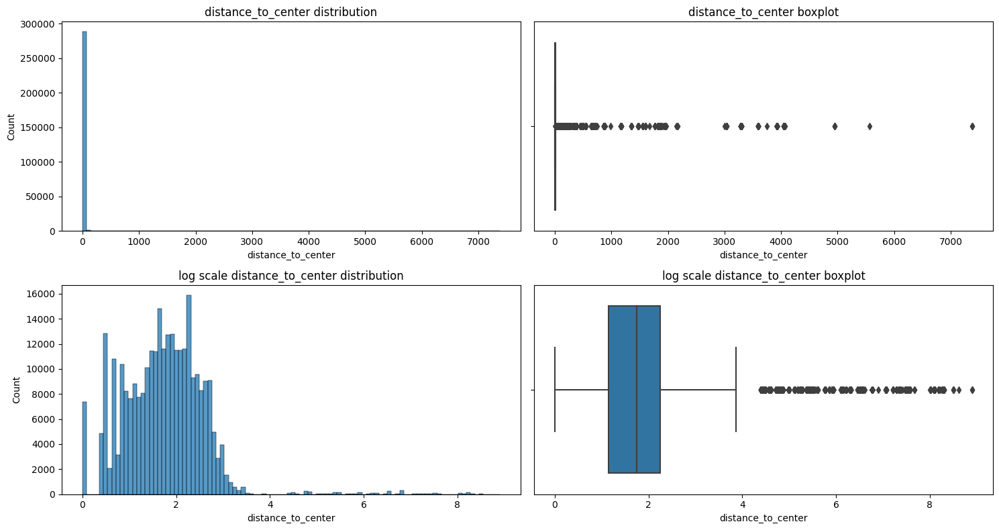

In [158]:
# look at the outliers
col = 'distance_to_center'
outliers = outlier_analysis(data, col, m=1, n=100)

log scale data has more normal distribution, will use it

In [159]:
# fillna with median values
med_distance_to_center = data.distance_to_center.median()
data['distance_to_center'].fillna(med_distance_to_center, inplace=True)

# add log column
data['distance_to_center_log'] = np.log(data['distance_to_center'] + 1)

# replace outliers in nonlog column
data.loc[outliers['outliers_z'].index, 'distance_to_center'] = med_distance_to_center

# replace outliers by median value
# both tukey and z score log outliers are the same
med_dist_to_center_log = data.distance_to_center_log.median()
data.loc[outliers['outliers_z_log'].index, 'distance_to_center_log'] = med_dist_to_center_log

# remove 'city_longitude', 'city_latitude' columns
data.drop(['city_longitude', 'city_latitude'], axis=1, inplace=True)

### Look at the columns from zipcode

#### State_zip and state

In [160]:
# look if there any difference between 2 columns
cond = (data.state != data.state_zip) & (~data.state_zip.isna())
display(data.loc[cond,['street', 'city', 'state', 'major_city', 'state_zip', 'zipcode', 'lat', 'lng']])
display(data.loc[cond].shape)

,street,city,state,major_city,state_zip,zipcode,lat,lng
20056,2308 E Ewarren St,Needmore,TN,Needmore,PA,17238,39.860,-78.150
36335,108 N Nbelvedere Blvd #29,Santa Ana,TN,Santa Ana,CA,92703,33.740,-117.890
37247,9543 W Mcnab #201,Tamarac,Fl,Fort Lauderdale,FL,33321,26.210,-80.270
49735,253 W Wnorwood Ave,Spring,TN,Spring,TX,77380,30.140,-95.470
55221,1613 W B St # 54,Other City Not In the State of Florida,FL,Mcallen,TX,78501,26.210,-98.230
57635,2318 E Ewarren St,Needmore,TN,Needmore,PA,17238,39.860,-78.150
63535,2319 E Ewarren,Needmore,TN,Needmore,PA,17238,39.860,-78.150
66350,2315 E Ewarren St,Needmore,TN,Needmore,PA,17238,39.860,-78.150
68913,108 N Nbelvedere Blvd #12,Santa Ana,TN,Santa Ana,CA,92703,33.740,-117.890
68925,2332 E Ewarren St,Needmore,TN,Needmore,PA,17238,39.860,-78.150


(22, 120)

There are 23 rows with difference in state, which means that there was a mistake in zipcode or in the address.<br>
For example '2309 E Ewarren St, TN' it's address in Memphis, but zipcode from 'needmore, PA' which corresponds to the city column also.<br>
Remove those rows.

In [161]:
# remove rows with difference in state and state_zip
data.drop(data[(data.state != data.state_zip) & (~data.state_zip.isna())].index, inplace=True)

In [162]:
# remove state_zip column
data.drop('state_zip', axis=1, inplace=True)

# look at the top spread states
top_state = data.state.value_counts(normalize=True)[:10]*100
top_state

FL   29.030
TX   19.731
NY    7.910
CA    7.176
NC    5.749
TN    4.498
WA    3.625
OH    2.972
IL    2.891
NV    2.647
Name: state, dtype: float64

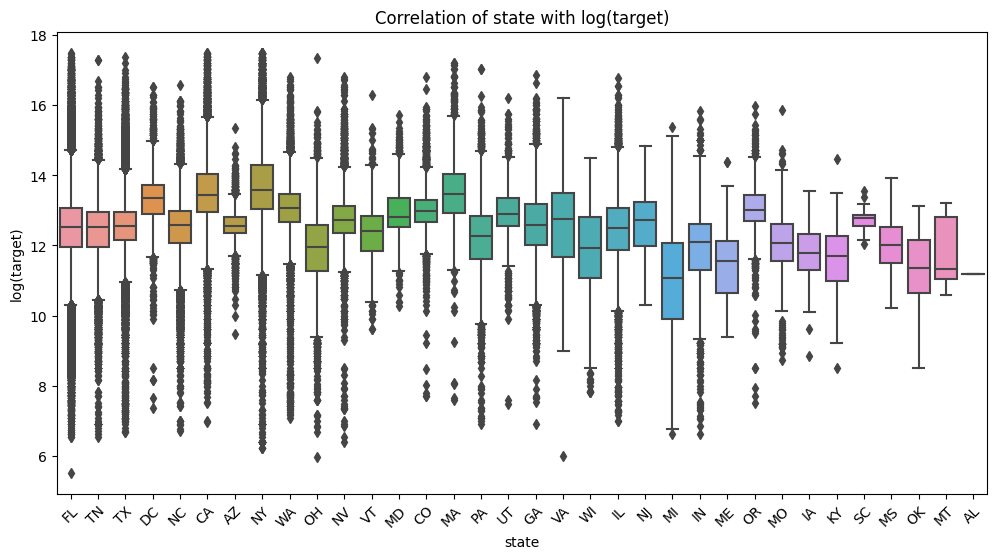

In [163]:
# look at the correlation with target
plot_correlation_boxplot(data, 'state', 'target')

In [164]:
# create columns with selected top 10 states
top = top_state.index.tolist()
for col in top:
    new_col = 'state_' + col
    data[new_col] = data.state.apply(lambda x: 1 if col in x else 0)

# create column which indicate if the state not in 50% of the data so not Fl or TX
top_2 = top_state[:2].index.tolist()
data['not_top_2_state'] = data.state.apply(lambda x: 1 if not any(st in x for st in top_2) else 0)

#### City and Major_city

In [165]:
# lowercase the columns
data.city = data.city.str.lower()
data.major_city = data.major_city.str.lower()

# look at the difference in columns
display(data.loc[(data.city != data.major_city) & (~data.major_city.isna()),[ 'city', 'major_city']].drop_duplicates().shape)
display(data.loc[(data.city != data.major_city) & (~data.major_city.isna()),['street', 'city', 'state', 'major_city', 'zipcode', 'lat', 'lng']].drop_duplicates()[:20])

(1104, 2)

,street,city,state,major_city,zipcode,lat,lng
0,552 Casanova Ct,poinciana,FL,kissimmee,34759,28.080,-81.440
15,2713 Oakmont Ct,weston,FL,fort lauderdale,33332,26.010,-80.460
18,15405 Riverside Dr #2,beechhurst,NY,whitestone,11357,40.790,-73.810
36,2649 NW 48th Ter #431,lauderdale lakes,FL,fort lauderdale,33313,26.150,-80.230
39,9715 Charles Dr,valley view,OH,cleveland,44125,41.410,-81.610
40,210 Fairlake Cir #12,lakeway,TX,austin,78734,30.380,-97.950
41,5400 SW 4th St,coral gables,FL,miami,33134,25.750,-80.270
51,342 Anchovie Ct,poinciana,FL,kissimmee,34759,28.080,-81.440
57,2800 58th Way N,st petersburg,FL,saint petersburg,33710,27.790,-82.730
63,1391 Camellia Cir,weston,FL,fort lauderdale,33326,26.110,-80.390


There are a lot of differences in city and major_city column, but mostly it's due to the fact that city column is not formatted.<br>
In general both columns indicate to the same city or area, sometimes city column indicate the certain area in the major city.<br>
Remove city column and leave major_city column as there is no need to format it.

In [166]:
# remove city column
data.drop('city', axis=1, inplace=True)

# look at the top spread cities
top_city = data.major_city.value_counts(normalize=True)[:10]*100
top_city

miami             4.972
houston           4.556
san antonio       3.784
fort lauderdale   2.594
new york          2.338
chicago           2.298
jacksonville      2.251
brooklyn          2.247
las vegas         1.931
dallas            1.832
Name: major_city, dtype: float64

In [167]:
# create columns with selected top 6 cities
top = top_city.index.tolist()[:6]
for col in top:
    new_col = 'city_' + col
    data[new_col] = data.major_city.apply(lambda x: 1 if col in x else 0)

# create column which indicate if the city is not in top 3 spread cities
top_3 = top_city[:3].index.tolist()
data['not_top_3_city'] = data.major_city.apply(lambda x: 1 if not any(city in x for city in top_3) else 0)

##### post_office_city

In [168]:
# look at the data
data.post_office_city.value_counts()

Miami, FL                   14458
Houston, TX                 13245
San Antonio, TX             11004
Fort Lauderdale, FL          7542
New York, NY                 6796
Chicago, IL                  6682
Brooklyn, NY                 6445
Jacksonville, FL             6041
Las Vegas, NV                5561
Dallas, TX                   5310
Atlanta, GA                  4740
Orlando, FL                  4713
Philadelphia, PA             4334
Tampa, FL                    4292
Charlotte, NC                4135
Fort Worth, TX               3905
Austin, TX                   3788
Kissimmee, FL                3694
Los Angeles, CA              3612
Cleveland, OH                3088
Saint Petersburg, FL         3068
Miami Beach, FL              2972
Seattle, WA                  2928
Ocala, FL                    2840
Denver, CO                   2774
Detroit, MI                  2763
Nashville, TN                2608
Palm Coast, FL               2489
Indianapolis, IN             2480
Lehigh Acres, 

The data in post_office_city is the same as state and major_city, except 1560 rows which less than 0.5% of the data, could remove the column

In [169]:
# remove the post_office_city column
data.drop('post_office_city', axis=1, inplace=True)

##### common_city_list

In [170]:
# look at the data
data.common_city_list.value_counts()

[Houston]                                                              12017
[San Antonio]                                                           8780
[Brooklyn]                                                              6533
[Jacksonville]                                                          6282
[Miami]                                                                 6031
[Chicago]                                                               5992
[New York]                                                              5837
[Las Vegas]                                                             5495
[Dallas]                                                                5137
[Charlotte]                                                             3986
[Philadelphia, Phila]                                                   3873
[Atlanta]                                                               3394
[Ocala]                                                                 2840

In [171]:
# the column has the same info as the major_city column, could be removed
data.drop('common_city_list', axis=1, inplace=True)

#### County

In [172]:
# look at the data
data.county.value_counts()

Miami-Dade County         20170
Harris County             14560
Bexar County              11029
Broward County            10828
Los Angeles County         7715
Orange County              7024
Clark County               6988
Cook County                6801
New York County            6798
Marion County              6646
Kings County               6533
Duval County               6440
Dallas County              6308
Charlotte County           5804
Lee County                 5106
Tarrant County             4903
Mecklenburg County         4813
Queens County              4671
Cuyahoga County            4648
Hillsborough County        4554
King County                4525
Philadelphia County        4334
Pinellas County            3905
Hamilton County            3704
Fulton County              3598
Davidson County            3519
Travis County              3403
Wayne County               3371
Montgomery County          2902
Maricopa County            2891
Osceola County             2815
El Paso 

In [173]:
# format the column
data['county'] = data.county.str.lower().replace('county', '', regex=True).str.strip()

# look at top 10
top_county = data.county.value_counts(normalize=True)[:15]*100
top_county

miami-dade    6.936
harris        5.007
bexar         3.793
broward       3.724
los angeles   2.653
orange        2.416
clark         2.403
cook          2.339
new york      2.338
marion        2.286
kings         2.247
duval         2.215
dallas        2.169
charlotte     1.996
lee           1.756
Name: county, dtype: float64

In [174]:
# create columns with selected top 11 counties
top = top_county.index.tolist()[:11]
for col in top:
    new_col = 'county_' + col
    data[new_col] = data.county.apply(lambda x: 1 if col in x else 0)

# create column which indicate if the county is not in top 4 spread counties
top_4 = top_county[:4].index.tolist()
data['not_top_4_county'] = data.county.apply(lambda x: 1 if not any(val in x for val in top_4) else 0)

# fillna county by mode
data['county'].fillna(data.county.mode()[0], inplace=True)

#### timezone

In [175]:
# look at the data
data.timezone.value_counts()

America/New_York                152762
America/Chicago                  76741
America/Los_Angeles              41679
America/Denver                    8751
America/Detroit                   4937
America/Indiana/Indianapolis      3026
America/Phoenix                   2891
Name: timezone, dtype: int64

There are only 7 unique values in timezone column, could be transformed into dummy columns.

In [176]:
# format the column
time_dict = {'America\/':'',\
            'Indiana\/':''
}
data['timezone'] = data.timezone.replace(time_dict, regex=True).str.strip().str.lower()

# add dummy columns
data = pd.get_dummies(data, prefix=['timezone'], columns=['timezone'])

#### radius_in_miles

In [177]:
# look at the data
data.radius_in_miles.info()

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: radius_in_miles
Non-Null Count   Dtype  
--------------   -----  
290355 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


There are some Nan's need to replace them

25 percentile: 2.0, 75 percentile: 5.0, IQR: 3.0,  Outlier borders: [-2.5, 9.5].


Number of Tukey outliers in radius_in_miles column - 21578

Outliers are detected in log scale
25 percentile: 1.0986122886681098, 75 percentile: 1.791759469228055, IQR: 0.6931471805599452,  Outlier borders: [0.05889151782819213, 2.8314802400679726].
Number of Tukey outliers in log radius_in_miles column - 3934

z score lower bound -6.48719808963135
z score upper bound 14.998518714383806
Number of z score outliers in radius_in_miles column - 5077

Outliers are detected in log scale
z score lower bound -0.12773229767668992
z score upper bound 3.1259946138672694
Number of z score outliers in log radius_in_miles column - 1116



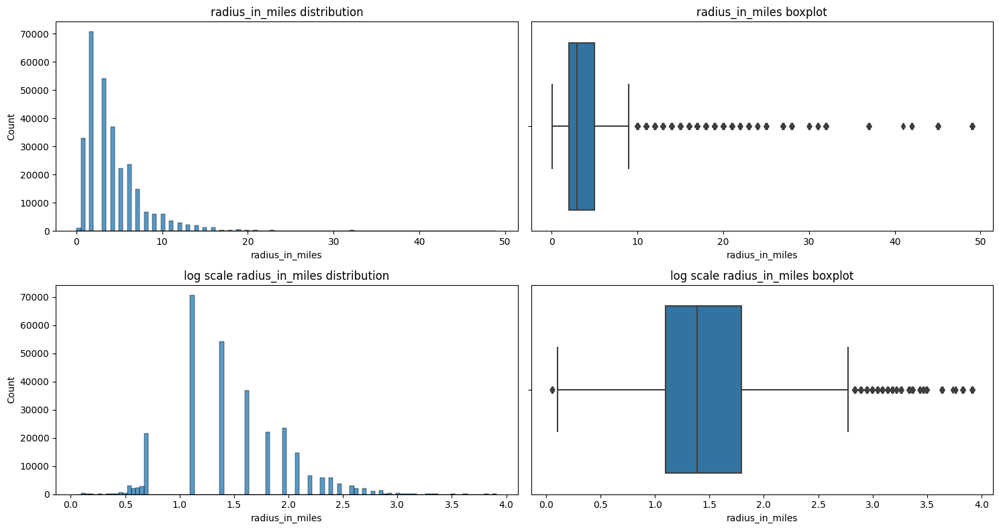

In [178]:
# look at the outliers
col = 'radius_in_miles'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scaling doesn't seem to help to have more normal distribution. But it has less outliers

In [179]:
# replace Na with median values
med_radius = data.radius_in_miles.median()
data.radius_in_miles.fillna(med_radius, inplace=True)

#### population

In [180]:
# look at the data
data.population.info()

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: population
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


There are some Nan's, need to replace them

25 percentile: 20628.0, 75 percentile: 43904.0, IQR: 23276.0,  Outlier borders: [-14286.0, 78818.0].
Number of Tukey outliers in population column - 7350

Outliers are detected in log scale
25 percentile: 9.934453131793008, 75 percentile: 10.689783487794095, IQR: 0.7553303560010871,  Outlier borders: [8.801457597791376, 11.822779021795725].
Number of Tukey outliers in log population column - 7981

z score lower bound -20909.367378146067
z score upper bound 88574.50569197745
Number of z score outliers in population column - 4147

Outliers are detected in log scale
z score lower bound 8.284541673317085
z score upper bound 12.228168415783225
Number of z score outliers in log population column - 3943



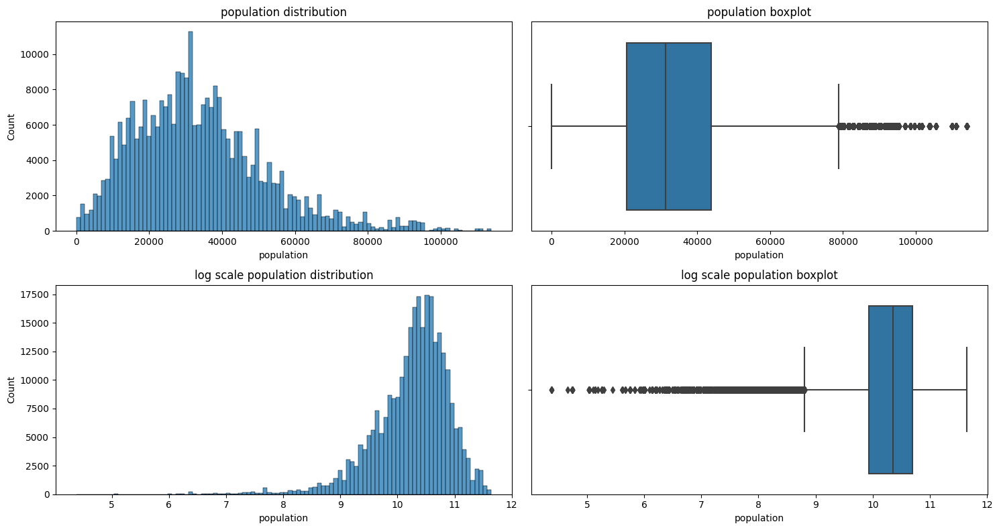

In [181]:
# look at the outliers
col = 'population'
outliers = outlier_analysis(data, col, m=1, n=100)

Seems that log scale population has more normal distribution with left tail

In [182]:
# look at the population outliers
outl = outliers['outliers_z_log']
display(outl.population.min())
display(outl.population.max())

79.0

3951.0

In [183]:
outl[outl.population == 79]

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix
66925,active,"low rise, detached",2037 Montgomery Rd,1.000,1094.000,5447,3.000,VT,1,95000,14,0,4716304,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.386,3.000,1.386,0,0.693,1988,1988,"floor furnace, stove - pellet, hot air, forced...","wall ac units,forced air",95832.000,87.000,"[9, 3, 3]","[3.9 mi, 4.9 mi, 4.3 mi]","[PK–8, 6–12, PK–5]","[Montgomery Center School, Richford Junior/Sen...",0,0,1094.000,1094.000,1094.000,1094.000,1094.000,6.999,6.999,6.998,0,0,87.000,0,0,95832.000,95832.000,95832.000,1,0,0,1,1,0,1,NaN,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,east berkshire,franklin,-72.711,-72.692,44.936,44.927,44.930,-72.700,0.682,79.000,802,259.000,0.310,0.000,38.000,33.000,152500.000,69063.000,0.490,0.399,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
78956,active,"low rise, detached",1657 Marvin Rd,1.000,1868.000,5447,3.000,VT,2,130000,14,0,4766253,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,2.000,0,1.099,0,0,1.386,3.000,1.386,0,0.693,1880,1988,space heater,NaN,377230.000,70.000,"[3, 3, 6]","[1.5 mi, 2.3 mi, 3.3 mi]","[PK–5, 6–12, PK–8]","[Richford Elementary School, Richford Junior/S...",0,0,1868.000,1868.000,1868.000,1868.000,1868.000,7.534,7.534,7.533,0,0,70.000,0,0,377230.000,377230.000,377230.000,1,0,0,1,1,0,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,east berkshire,franklin,-72.711,-72.692,44.936,44.927,44.930,-72.700,0.682,79.000,802,259.000,0.310,0.000,38.000,33.000,152500.000,69063.000,0.490,0.399,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
104947,under contract,"low rise, detached",322 Montgomery Rd,1.500,1728.000,5447,3.000,VT,1.5,115000,14,0,4734822,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.386,3.000,1.386,0,0.916,1900,1988,forced air,forced air,13939.000,67.000,"[3, 6, 3]","[4.0 mi, 4.1 mi, 4.7 mi]","[PK–5, PK–8, 6–12]","[Richford Elementary School, Berkshire Element...",0,0,1728.000,1728.000,1728.000,1728.000,1728.000,7.456,7.456,7.455,0,0,67.000,0,0,13939.000,13939.0

Population outliers seems to be real values, leave them untouched

In [184]:
# fillna with median value per major city
median_population = data.groupby('major_city')['population'].median()
data['population'] = data['population'].fillna(data['major_city'].map(median_population))

# rest Na replace with median values
data.population.fillna(data.population.median(), inplace=True)

# create log population column
data['population_log'] = np.log(data.population)

#### area_code_list

In [185]:
# look at the data
data.area_code_list.value_counts()

305,786                                12508
210                                    10280
904                                     7116
954                                     6703
941                                     6322
352                                     6104
321,407                                 5883
718                                     5639
702                                     5263
615                                     5163
713                                     4886
239                                     4561
850                                     4227
727                                     3702
281,713,832                             3636
512                                     3623
919                                     3602
813                                     3576
423                                     3512
704                                     3293
214,469,972                             2991
303,720                                 2941
386       

In [186]:
# replace empty rows with mode value
area_code_mode = data['area_code_list'].mode().iloc[0]
data.loc[data['area_code_list'].str.len() == 0, 'area_code_list'] = area_code_mode
data.area_code_list.fillna(area_code_mode, inplace=True)

#### population_density

In [187]:
# look at the data
data.population_density.info()

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: population_density
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


25 percentile: 1043.0, 75 percentile: 6235.0, IQR: 5192.0,  Outlier borders: [-6745.0, 14023.0].


Number of Tukey outliers in population_density column - 32318

Outliers are detected in log scale
25 percentile: 6.950814768442584, 75 percentile: 8.738094230177667, IQR: 1.7872794617350838,  Outlier borders: [4.269895575839958, 11.419013422780292].
Number of Tukey outliers in log population_density column - 6398

z score lower bound -39286.92400766315
z score upper bound 54235.83442284259
Number of z score outliers in population_density column - 7317

Outliers are detected in log scale
z score lower bound 3.4682148946505693
z score upper bound 12.298510927341862
Number of z score outliers in log population_density column - 1108



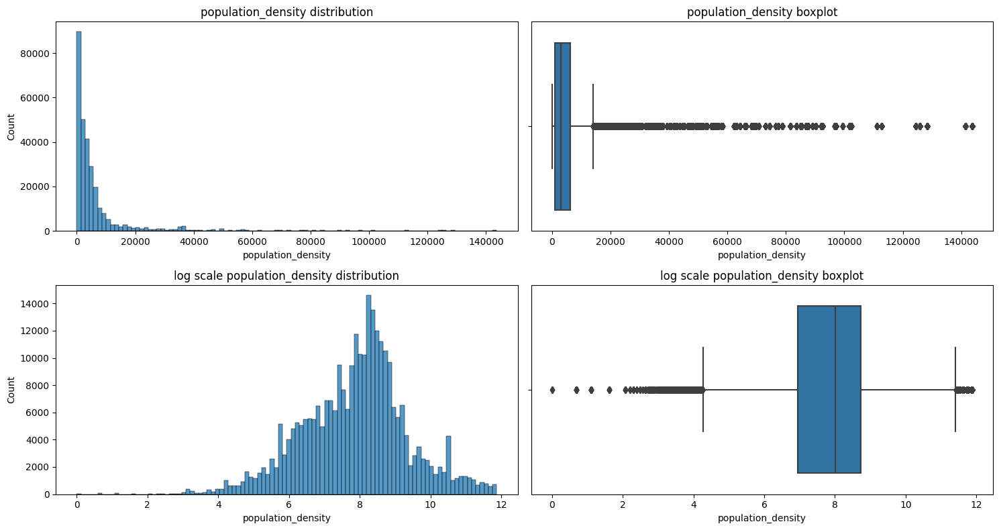

In [188]:
# look at the outliers
col = 'population_density'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scale population_density looks more normally distributed with left tail and has less outliers

In [189]:
# look at the outliers
display(outliers['outliers_z_log'][:5])
display(outliers['outliers_z_log'].population_density.min())
display(outliers['outliers_z_log'].population_density.max())

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log
438,active,unknown,33360 Serene Dr,2.000,NaN,33982,3.000,FL,NaN,169000,9,0,C7412825,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1.000,1,0.693,0,1,1.386,3.000,1.386,1,1.099,1985,1988,NaN,NaN,NaN,NaN,"[6, 5, 7]","[6.9 mi, 9.0 mi, 9.2 mi]","[Preschool to 5, 6 to 8, 9 to 12]","[East Elementary School, Punta Gorda Middle Sc...",0,1,1789.000,1789.000,-1.000,-1.000,1789.000,0.000,7.491,7.489,1,1,174.000,1,1,8316.000,8316.000,10000.000,0,0,0,0,-1,1,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,punta gorda,charlotte,-82.021,-81.562,27.035,26.770,26.910,-81.770,16.000,9176.000,"305,786",21.000,437.800,11.650,5177.000,3834.000,106500.000,44125.000,17.340,2.909,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,9.124
1041,active,land,Leighton Point Rd Lot 11,0.000,0.000,04666,0.000,ME,NaN,220000,11,0,1416755,1,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0.000,1,0.693,0,1,1.386,3.000,1.386,0,0.000,1945,1988,NaN,NaN,853776.000,NaN,"[NR, NR]","[2.1 mi, 4.2 mi]","[PK–8, PK–8]","[Pembroke Elementary School, Edmunds Consolida...",0,1,0.000,1789.000,-1.000,0.000,1789.000,0.693,0.693,7.489,1,1,174.000,1,0,853776.000,8316.000,17424.000,0,0,0,0,-1,0,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,pembroke,washington,-67.358,-67.082,45.109,44.878,44.950,-67.160,9.000,1172.000,207,19.000,63.000,10.660,787.000,506.000,109100.000,37426.000,0.000,0.000,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,7.066
1435,active,"low rise, detached",17101 Bullhorn Cir,3.000,2784.000,33982,4.000,FL,1,775000,14,0,219031553,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.609,4.000,1.609,0,1.386,2017,1988,central electric,central electric,9583.000,278.000,"[6, 5, 7, 7, NR, 10, NR]","[19.0 mi, 20.1 mi, 20.3 mi, 0.7 mi, 11.8 mi, 1...","[PK–5, 6–8, 9–12, K–6, 6–12, 9–12, PK–12]","[East Elementary School, Punta Gorda Middle Sc...",0,0,2784.000,2784.000,2784.000,2784.000,2784.000,7.932,7.932,7.932,0,0,278.000,0,0,9583.000,9583.000,9583.000,1,0,0,0,

0.0

31.0

According to the data population density = population / land area in sqmi.<br>
All outliers seems to be ok, except 0 population_density. Replace it using the formula above.

In [190]:
# replace the outliers where population == 0
cond = data.population_density == 0
data.loc[cond, 'population_density'] = round(data.loc[cond, 'population'] / data.loc[cond, 'land_area_in_sqmi'], 2)

# fillna using median value
population_density_med = data.population_density.median()
data.population_density.fillna(population_density_med, inplace=True)

# create log scale column
data['population_density_log'] = np.log(data.population_density)

#### land_area_in_sqmi

In [191]:
# look at the data
data.land_area_in_sqmi.info()

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: land_area_in_sqmi
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


25 percentile: 4.65, 75 percentile: 27.61, IQR: 22.96,  Outlier borders: [-29.79, 62.05].
Number of Tukey outliers in land_area_in_sqmi column - 27502

Outliers are detected in log scale
25 percentile: 1.7316555451583497, 75 percentile: 3.3537563070620187, IQR: 1.622100761903669,  Outlier borders: [-0.7014955976971537, 5.786907449917522].
Number of Tukey outliers in log land_area_in_sqmi column - 1742

z score lower bound -141.72202173515214
z score upper bound 193.99047058003666
Number of z score outliers in land_area_in_sqmi column - 3574

Outliers are detected in log scale
z score lower bound -0.9238469482838032
z score upper bound 6.020471921486223
Number of z score outliers in log land_area_in_sqmi column - 1028



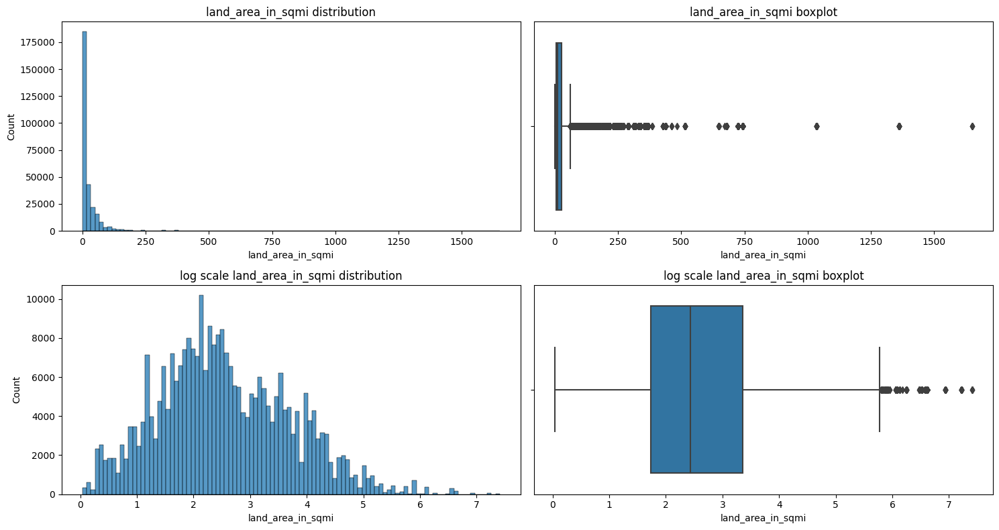

In [192]:
# look at the outliers
col = 'land_area_in_sqmi'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scale land_area_in_sqmi looks more normally distributed and has less outliers

In [193]:
# look at the outliers
display(outliers['outliers_z_log'].land_area_in_sqmi.min())
display(outliers['outliers_z_log'].land_area_in_sqmi.max())
display(outliers['outliers_z_log'][:5])

427.0

1650.53

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log,population_density_log
260,active,"low rise, detached",607 Alba Dr,2.000,1768.000,78045,3.000,TX,1 story,247850,15,0,20193697,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.386,3.000,1.386,0,1.099,2019,1988,central electric,central electric,5796.000,140.000,[],[],[],[],0,0,1768.000,1768.000,1768.000,1768.000,1768.000,7.479,7.479,7.478,0,0,140.000,0,0,5796.000,5796.000,5796.000,0,0,0,0,-1,0,1,NaN,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,laredo,webb,-100.212,-99.390,28.199,27.564,27.830,-99.690,19.000,54713.000,956,76.000,723.530,3.760,16209.000,15196.000,154400.000,63938.000,25.260,3.268,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,10.910,4.331
438,active,unknown,33360 Serene Dr,2.000,NaN,33982,3.000,FL,NaN,169000,9,0,C7412825,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1.000,1,0.693,0,1,1.386,3.000,1.386,1,1.099,1985,1988,NaN,NaN,NaN,NaN,"[6, 5, 7]","[6.9 mi, 9.0 mi, 9.2 mi]","[Preschool to 5, 6 to 8, 9 to 12]","[East Elementary School, Punta Gorda Middle Sc...",0,1,1789.000,1789.000,-1.000,-1.000,1789.000,0.000,7.491,7.489,1,1,174.000,1,1,8316.000,8316.000,10000.000,0,0,0,0,-1,1,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,punta gorda,charlotte,-82.021,-81.562,27.035,26.770,26.910,-81.770,16.000,9176.000,"305,786",21.000,437.800,11.650,5177.000,3834.000,106500.000,44125.000,17.340,2.909,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,9.124,3.045
589,active,land,4002 Quivira Dr,0.000,0.000,78045,0.000,TX,NaN,800000,11,0,20192774,1,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0.000,1,0.693,0,1,1.386,3.000,1.386,0,0.000,1985,1988,NaN,NaN,174240.000,NaN,"[7, 8, 4, 8, 9, 5, NR]","[1.4 mi, 3.3 mi, 5.4 mi, 3.1 mi, 5.4 mi, 7.3 m...","[PK–5, 6–8, 9–12, PK–5, 6–8, 9–12, PK–8]","[Julia Bird Jones Muller Elementary School, Ge...",0,1,0.000,1789.000,-1.000,0.000,1789.000,0.693,0.693,7.489,1,1,174.000,0,0,174240.000,174240.000,174240.000,0,0,0,0,-1,1,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,laredo,w

According to the google all those outliers are real values, so it's big area with the same zipcode with low population_density.

In [194]:
# fill na with median value
data.land_area_in_sqmi.fillna(data.land_area_in_sqmi.median(), inplace=True)

# create log scale column
data['land_area_in_sqmi_log'] = np.log(data.land_area_in_sqmi)

#### water_area_in_sqmi

In [195]:
# look at the data
display(data.water_area_in_sqmi.info())
display(data.water_area_in_sqmi.describe())

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: water_area_in_sqmi
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


None

count   289971.000
mean         1.170
std          3.662
min          0.000
25%          0.010
50%          0.150
75%          0.900
max        184.990
Name: water_area_in_sqmi, dtype: float64

25 percentile: 0.01, 75 percentile: 0.9, IQR: 0.89,  Outlier borders: [-1.325, 2.235].
Number of Tukey outliers in water_area_in_sqmi column - 39073

Outliers are detected in log scale
25 percentile: 0.009950330853168092, 75 percentile: 0.6418538861723947, IQR: 0.6319035553192266,  Outlier borders: [-0.9379050021256718, 1.5897092191512345].
Number of Tukey outliers in log water_area_in_sqmi column - 26010

z score lower bound -9.815506671748016
z score upper bound 12.1555161209688
Number of z score outliers in water_area_in_sqmi column - 4324

Outliers are detected in log scale
z score lower bound -1.4886011390342655
z score upper bound 2.397928051130155
Number of z score outliers in log water_area_in_sqmi column - 5251



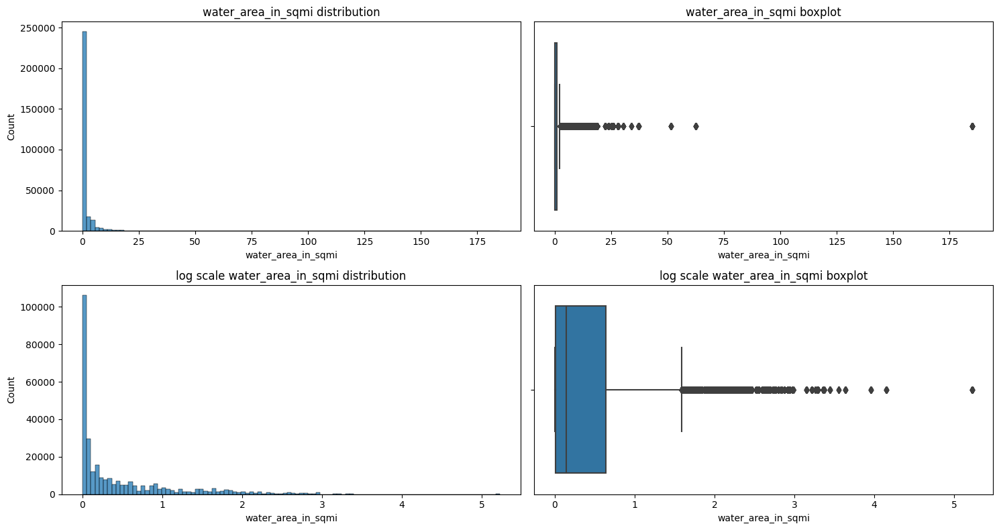

In [196]:
# look at the outliers
col = 'water_area_in_sqmi'
outliers = outlier_analysis(data, col, m=1, n=100)

Both scales have not normal distribution, non log data has less outliers

In [197]:
# look at the outliers
outl = outliers['outliers_z']
outl.loc[outl.water_area_in_sqmi > 20].groupby('zipcode')[['population', 'population_density', 'water_area_in_sqmi', 'land_area_in_sqmi', 'radius_in_miles']].median()

,population,population_density,water_area_in_sqmi,land_area_in_sqmi,radius_in_miles
zipcode,,,,,
30506,41667.000,415.000,23.940,100.340,12.000
32226,15761.000,184.000,25.910,85.500,9.000
77331,6824.000,45.000,25.040,153.110,11.000
77351,32517.000,48.000,36.970,671.390,20.000
77640,16875.000,438.000,33.900,38.540,18.000
78418,29854.000,687.000,37.140,43.440,17.000
78521,93818.000,1007.000,27.910,93.140,12.000
78566,16230.000,141.000,51.520,114.960,17.000
78578,12516.000,209.000,25.650,59.880,7.000


According to the google all places with zipcodes with outlier water_area_in_sqmi values have just a lot of water on the map, leave the outliers untouched.

In [198]:
# fill na with median
median_water_area = data['water_area_in_sqmi'].median()
data['water_area_in_sqmi'].fillna(median_water_area, inplace=True)

#### housing_units

In [199]:
# look at the data
display(data.housing_units.describe())
display(data.housing_units.info())


count   289971.000
mean     14909.555
std       7347.286
min         38.000
25%       9810.000
50%      14089.000
75%      19141.000
max      47617.000
Name: housing_units, dtype: float64

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: housing_units
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


None

25 percentile: 9810.0, 75 percentile: 19141.0, IQR: 9331.0,  Outlier borders: [-4186.5, 33137.5].
Number of Tukey outliers in housing_units column - 6951

Outliers are detected in log scale
25 percentile: 9.19125948416339, 75 percentile: 9.859640152755851, IQR: 0.6683806685924605,  Outlier borders: [8.1886884812747, 10.862211155644541].
Number of Tukey outliers in log housing_units column - 10422

z score lower bound -7132.302349874868
z score upper bound 36951.4131644046
Number of z score outliers in housing_units column - 2601

Outliers are detected in log scale
z score lower bound 7.651799845448634
z score upper bound 11.273449896624017
Number of z score outliers in log housing_units column - 4063



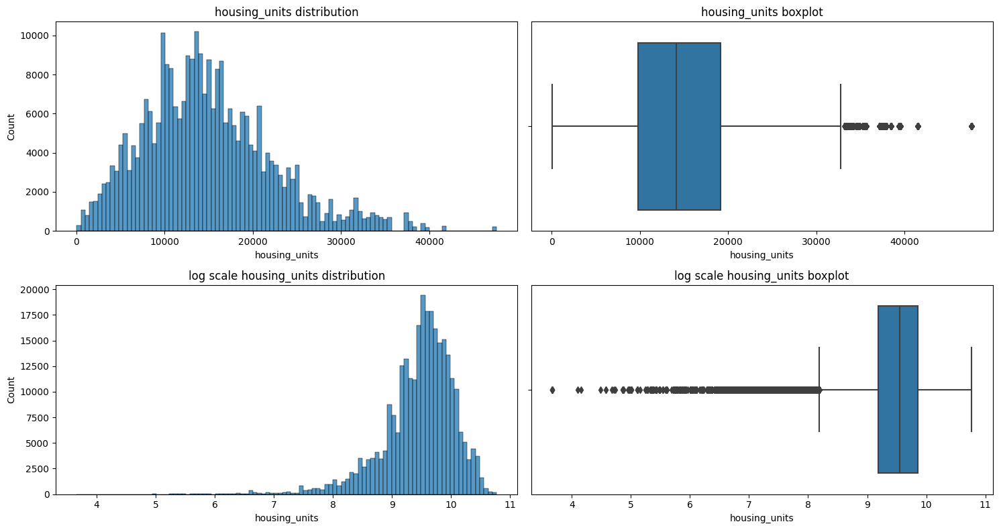

In [200]:
# look at the outliers
col = 'housing_units'
outliers = outlier_analysis(data, col, m=1, n=100)

Non log data has less number of outliers

In [201]:
# look deeper into outliers
display(outliers['outliers_z'].housing_units.min())
display(outliers['outliers_z'].housing_units.max())
display(outliers['outliers_z'][:5])
display(outliers['outliers_z'].groupby(['zipcode', 'major_city'])[['population', 'radius_in_miles', 'housing_units']].median())

37180.0

47617.0

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log,population_density_log,land_area_in_sqmi_log
1077,active,"low rise, multi family",2821 Avenue Z #2823,12.000,9600.000,11235,20.000,NY,3.0,4400000,14,0,434719,1,1,0,2,1,0,0,0,0,0,1,0,0,0,0,3.000,0,1.386,0,0,3.045,20.000,3.045,0,2.565,1935,1988,NaN,NaN,3998.000,458.000,"[5/10, 5/10]","[0.3mi, 0.16mi]","[6-8, PK-5]","[Jhs 14 Shell Bank, Ps 52 Sheepshead Bay]",sqft,0,9600.000,9600.000,9600.000,9600.000,9600.000,9.170,9.170,9.170,0,0,458.000,0,0,3998.000,3998.000,3998.000,0,0,0,0,-1,0,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,brooklyn,kings,-73.971,-73.926,40.595,40.574,40.580,-73.950,1.000,79132.000,718,35237.000,2.250,0.190,37619.000,33886.000,531000.000,41639.000,4.830,1.763,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,11.279,10.470,0.811
1126,active,"low rise, detached",3835 N Western Ave,3.000,2783.000,60618,4.000,IL,0,479900,14,0,10564571,2,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.609,4.000,1.609,0,1.386,1911,2013,forced air,"forced air,central",3210.000,172.000,"[8/10, 1/10]","[0.2 mi, 10.3 mi]","[K-8, 9-12]","[Bell Elementary School, Hope College Prep Hig...",sqft,0,2783.000,2783.000,2783.000,2783.000,2783.000,7.932,7.932,7.931,0,0,172.000,0,0,3210.000,3210.000,3210.000,1,0,0,0,2,0,0,NaN,1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,chicago,cook,-87.728,-87.678,41.963,41.932,41.950,-87.700,2.000,92084.000,"872,773",18195.000,5.060,0.000,39547.000,35407.000,336300.000,55577.000,6.350,1.995,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,11.430,9.809,1.621
2222,active,"condo, high rise",400 W Deming Pl #7L,2.000,750.000,60614,3.000,IL,9.0,209000,12,0,10485323,1,1,0,2,0,0,1,0,0,0,0,0,1,0,0,9.000,0,2.303,0,1,1.386,3.000,1.386,1,1.099,1926,1988,radiant,wall,27442.800,279.000,"[1/10, 9/10, 9/10]","[9.41mi, 0.79mi, 0.32mi]","[9-12, 9-12, PK-8]","[Hope College Prep High School, Lincoln Park H...",acre,0,750.000,750.000,750.000,750.000,750.000,6.623,6.623,6.620,0,0,279

,,population,radius_in_miles,housing_units
zipcode,major_city,,,
10023,new york,60998.000,0.739,39402.000
10025,new york,94600.000,0.966,47617.000
10467,bronx,97060.000,2.000,37432.000
11211,brooklyn,90117.000,2.000,37180.000
11226,brooklyn,101572.000,1.000,37745.000
11235,brooklyn,79132.000,1.000,37619.000
11385,ridgewood,98592.000,3.000,37251.000
60614,chicago,66617.000,2.000,37951.000
60618,chicago,92084.000,2.000,39547.000


All the outlier data is in big cities, so it's normal that there is a high density there

In [202]:
# fill missing values by median
med_housing_units = data.housing_units.median()
data.housing_units.fillna(med_housing_units, inplace=True)

#### occupied_housing_units

In [203]:
# look at the data
display(data.occupied_housing_units.describe())
display(data.occupied_housing_units.info())

count   289971.000
mean     13084.531
std       6661.271
min         33.000
25%       8485.000
50%      12384.000
75%      16938.000
max      44432.000
Name: occupied_housing_units, dtype: float64

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: occupied_housing_units
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


None

25 percentile: 8485.0, 75 percentile: 16938.0, IQR: 8453.0,  Outlier borders: [-4194.5, 29617.5].
Number of Tukey outliers in occupied_housing_units column - 7428

Outliers are detected in log scale
25 percentile: 9.04617302576227, 75 percentile: 9.737373934586381, IQR: 0.6912009088241113,  Outlier borders: [8.009371662526103, 10.774175297822548].
Number of Tukey outliers in log occupied_housing_units column - 9909

z score lower bound -6899.280997730342
z score upper bound 33068.342193505094
Number of z score outliers in occupied_housing_units column - 2727

Outliers are detected in log scale
z score lower bound 7.428227166948803
z score upper bound 11.213908291585055
Number of z score outliers in log occupied_housing_units column - 4190



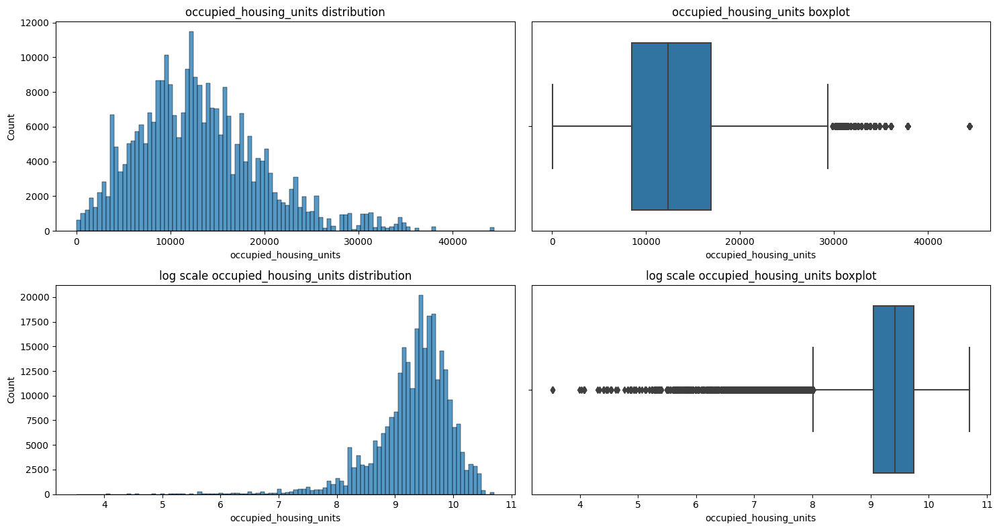

In [204]:
# look at the outliers
col = 'occupied_housing_units'
outliers = outlier_analysis(data, col, m=1, n=100)

Non log scaled data has less outliers

In [205]:
# look deeper into outliers
display(outliers['outliers_z'].occupied_housing_units.min())
display(outliers['outliers_z'].occupied_housing_units.max())
display(outliers['outliers_z'][:5])
display(outliers['outliers_z'].groupby(['zipcode', 'major_city'])[['population', 'housing_units', 'occupied_housing_units']].median())

33342.0

44432.0

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log,population_density_log,land_area_in_sqmi_log
1077,active,"low rise, multi family",2821 Avenue Z #2823,12.000,9600.000,11235,20.000,NY,3.0,4400000,14,0,434719,1,1,0,2,1,0,0,0,0,0,1,0,0,0,0,3.000,0,1.386,0,0,3.045,20.000,3.045,0,2.565,1935,1988,NaN,NaN,3998.000,458.000,"[5/10, 5/10]","[0.3mi, 0.16mi]","[6-8, PK-5]","[Jhs 14 Shell Bank, Ps 52 Sheepshead Bay]",sqft,0,9600.000,9600.000,9600.000,9600.000,9600.000,9.170,9.170,9.170,0,0,458.000,0,0,3998.000,3998.000,3998.000,0,0,0,0,-1,0,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,brooklyn,kings,-73.971,-73.926,40.595,40.574,40.580,-73.950,1.000,79132.000,718,35237.000,2.250,0.190,37619.000,33886.000,531000.000,41639.000,4.830,1.763,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,11.279,10.470,0.811
1126,active,"low rise, detached",3835 N Western Ave,3.000,2783.000,60618,4.000,IL,0,479900,14,0,10564571,2,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.609,4.000,1.609,0,1.386,1911,2013,forced air,"forced air,central",3210.000,172.000,"[8/10, 1/10]","[0.2 mi, 10.3 mi]","[K-8, 9-12]","[Bell Elementary School, Hope College Prep Hig...",sqft,0,2783.000,2783.000,2783.000,2783.000,2783.000,7.932,7.932,7.931,0,0,172.000,0,0,3210.000,3210.000,3210.000,1,0,0,0,2,0,0,NaN,1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,chicago,cook,-87.728,-87.678,41.963,41.932,41.950,-87.700,2.000,92084.000,"872,773",18195.000,5.060,0.000,39547.000,35407.000,336300.000,55577.000,6.350,1.995,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,11.430,9.809,1.621
2222,active,"condo, high rise",400 W Deming Pl #7L,2.000,750.000,60614,3.000,IL,9.0,209000,12,0,10485323,1,1,0,2,0,0,1,0,0,0,0,0,1,0,0,9.000,0,2.303,0,1,1.386,3.000,1.386,1,1.099,1926,1988,radiant,wall,27442.800,279.000,"[1/10, 9/10, 9/10]","[9.41mi, 0.79mi, 0.32mi]","[9-12, 9-12, PK-8]","[Hope College Prep High School, Lincoln Park H...",acre,0,750.000,750.000,750.000,750.000,750.000,6.623,6.623,6.620,0,0,279

,,population,housing_units,occupied_housing_units
zipcode,major_city,,,
10023,new york,60998.000,39402.000,34383.000
10025,new york,94600.000,47617.000,44432.000
10467,bronx,97060.000,37432.000,35524.000
11211,brooklyn,90117.000,37180.000,33489.000
11226,brooklyn,101572.000,37745.000,36101.000
11235,brooklyn,79132.000,37619.000,33886.000
11385,ridgewood,98592.000,37251.000,34843.000
60614,chicago,66617.000,37951.000,34850.000
60618,chicago,92084.000,39547.000,35407.000


The same situation as it was with 'housing_units'. All the outlier data is in big cities, so it's normal that there is a high density there

In [206]:
# fill missing values by median
med_oc_housing_units = data.occupied_housing_units.median()
data.occupied_housing_units.fillna(med_oc_housing_units, inplace=True)

#### median_home_value

In [207]:
# look at the data
display(data.median_home_value.describe())
display(data.median_home_value.info())

count    289971.000
mean     252578.675
std      190376.325
min       10200.000
25%      127800.000
50%      186400.000
75%      306000.000
max     1000001.000
Name: median_home_value, dtype: float64

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: median_home_value
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


None

25 percentile: 127800.0, 75 percentile: 306000.0, IQR: 178200.0,  Outlier borders: [-139500.0, 573300.0].
Number of Tukey outliers in median_home_value column - 21892

Outliers are detected in log scale
25 percentile: 11.758229645621093, 75 percentile: 12.631343648903034, IQR: 0.8731140032819411,  Outlier borders: [10.448558640698181, 13.941014653825945].
Number of Tukey outliers in log median_home_value column - 112

z score lower bound -318550.3002950731
z score upper bound 823707.6493127334
Number of z score outliers in median_home_value column - 8338

Outliers are detected in log scale
z score lower bound 10.289289148877828
z score upper bound 14.149661307545074
Number of z score outliers in log median_home_value column - 9



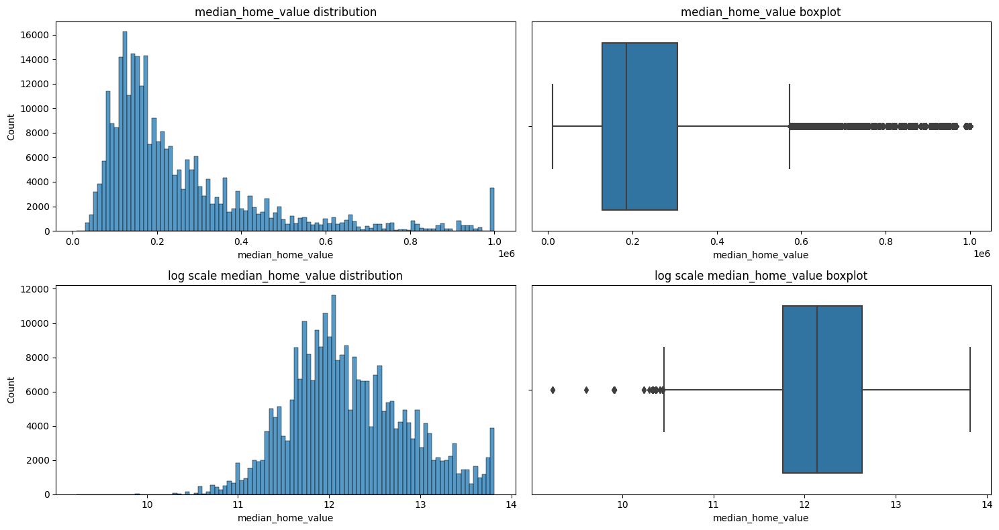

In [208]:
# look at the outliers
col = 'median_home_value'
outliers = outlier_analysis(data, col, m=1, n=100)

Log data has more normal distribution and less outliers

In [209]:
# look deeper into outliers
display(outliers['outliers_z_log'].median_home_value.min())
display(outliers['outliers_z_log'].median_home_value.max())
display(outliers['outliers_z_log'][:5])
display(outliers['outliers_z_log'].groupby(['zipcode', 'major_city'])[['population', 'median_home_value', 'housing_units', 'occupied_housing_units']].median())

10200.0

27900.0

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log,population_density_log,land_area_in_sqmi_log
24023,active,other,6821 150th St SW,2.000,NaN,98439,3.000,WA,NaN,179950,10,0,1538699,1,2,0,1,0,0,0,0,0,0,0,0,0,0,1,1.000,1,0.693,0,1,1.386,3.000,1.386,1,1.099,1985,1953,NaN,NaN,11761.200,NaN,"[1, 6, 1]","[1.2 mi, 0.5 mi, 2.5 mi]","[Preschool to 5, 6 to 8, 9 to 12]","[Tillicum Elementary School, Woodbrook Middle ...",acre,1,1789.000,1789.000,-1.000,-1.000,1789.000,0.000,7.491,7.489,1,1,174.000,0,0,11761.200,11761.200,11761.200,0,0,0,0,-1,1,0,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,lakewood,pierce,-122.557,-122.464,47.156,47.097,47.120,-122.500,2.000,4839.000,253,555.000,8.720,0.010,2024.000,1758.000,10200.000,33445.000,3.580,1.522,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,8.484,6.319,2.166
52803,active,land,7005 150th St SW,0.000,NaN,98439,0.000,WA,NaN,280000,10,0,1546863,1,2,0,1,0,0,0,1,0,0,0,0,0,0,0,0.000,1,0.693,0,1,1.386,3.000,1.386,0,0.000,1985,1988,NaN,NaN,104108.400,NaN,"[2/10, 1/10, 6/10]","[2.51mi, 1.14mi, 0.42mi]","[9-12, K-5, 6-8]","[Clover Park High School, Tillicum Elementary ...",acre,1,1789.000,1789.000,-1.000,-1.000,1789.000,0.000,7.491,7.489,1,1,174.000,0,0,104108.400,104108.400,104108.400,0,0,0,0,-1,1,1,NaN,-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,lakewood,pierce,-122.557,-122.464,47.156,47.097,47.120,-122.500,2.000,4839.000,253,555.000,8.720,0.010,2024.000,1758.000,10200.000,33445.000,3.580,1.522,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,8.484,6.319,2.166
58147,active,unknown,73-A Park Rd,2.000,NaN,78545,3.000,TX,NaN,670000,9,0,207330,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1.000,1,0.693,0,1,1.386,3.000,1.386,1,1.099,1985,1988,NaN,NaN,NaN,NaN,"[5, 4, 4, 3]","[1.0 mi, 1.3 mi, 1.7 mi, 1.9 mi]","[Preschool to 5, Preschool to 5, 6 to 8, 9 to 12]","[E High Gilbert Elementary School, Wright Elem...",0,1,1789.000,1789.000,-1.000,-1.000,1789.000,0.000,7.491,7.489,1,1,174.000,1,1,8316.000,8316.000,10000.000,0,0

,,population,median_home_value,housing_units,occupied_housing_units
zipcode,major_city,,,,
28666,icard,368.000,14800.000,195.000,157.000
44507,youngstown,5863.000,20100.000,3119.000,2219.000
44510,youngstown,2499.000,20000.000,1375.000,1058.000
78545,falcon heights,555.000,27900.000,270.000,187.000
98439,lakewood,4839.000,10200.000,2024.000,1758.000


Low median_home_value usually is in small cities with low population. Leave the outliers untouched

In [210]:
# fill missing values by median
med_home_value = data.median_home_value.median()
data.median_home_value.fillna(med_home_value, inplace=True)

# create log scale column
data['median_home_value_log'] = np.log(data.median_home_value)

#### median_household_income

In [211]:
# look at the data
display(data.median_household_income.describe())
display(data.median_household_income.info())

count   289971.000
mean     57391.085
std      23355.485
min       9106.000
25%      41543.000
50%      52236.000
75%      69114.000
max     230952.000
Name: median_household_income, dtype: float64

<class 'pandas.core.series.Series'>
Int64Index: 290787 entries, 0 to 290808
Series name: median_household_income
Non-Null Count   Dtype  
--------------   -----  
289971 non-null  float64
dtypes: float64(1)
memory usage: 4.4 MB


None

25 percentile: 41543.0, 75 percentile: 69114.0, IQR: 27571.0,  Outlier borders: [186.5, 110470.5].
Number of Tukey outliers in median_household_income column - 8405

Outliers are detected in log scale
25 percentile: 10.634508385524155, 75 percentile: 11.143527062898457, IQR: 0.5090186773743017,  Outlier borders: [9.870980369462703, 11.90705507895991].
Number of Tukey outliers in log median_household_income column - 2390

z score lower bound -12675.36878926804
z score upper bound 127457.53954427456
Number of z score outliers in median_household_income column - 3057

Outliers are detected in log scale
z score lower bound 9.702236835773371
z score upper bound 12.059038239057552
Number of z score outliers in log median_household_income column - 832



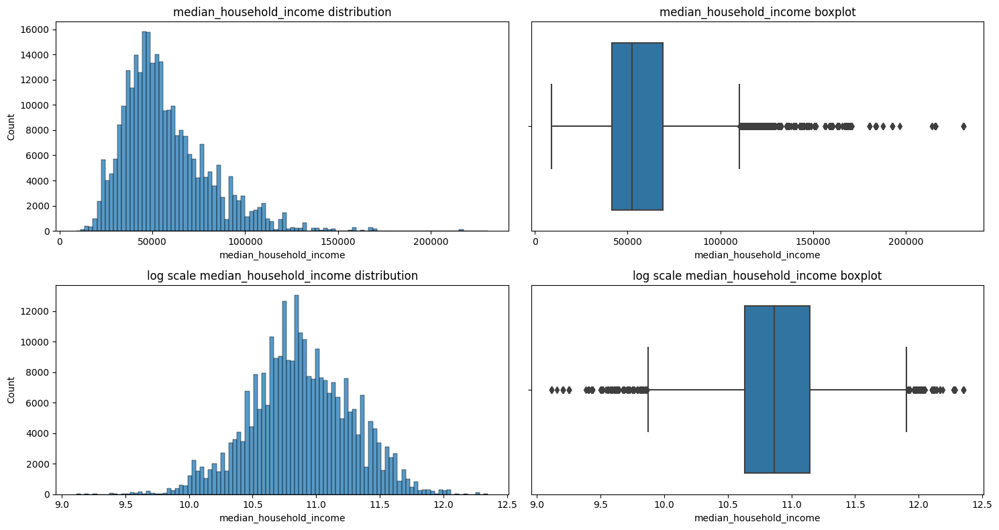

In [212]:
# look at the outliers
col = 'median_household_income'
outliers = outlier_analysis(data, col, m=1, n=100)

Log scale data has more normal distribution and less outliers

In [213]:
# look deeper into outliers
display(outliers['outliers_z_log'].median_household_income.min())
display(outliers['outliers_z_log'].median_household_income.max())
display(outliers['outliers_z_log'][:5])
display(outliers['outliers_z_log'].groupby(['zipcode', 'major_city'])[['population', 'median_home_value_log', 'housing_units', 'median_household_income']].median()[:20])

9106.0

230952.0

,status,propertyType,street,baths,sqft,zipcode,beds,state,stories,target,non_na_count,private_pool,mls_id,type_word_1,type_hc_1,rent,type_hc_2,prop_low rise,prop_detached,prop_condo,prop_land,prop_townhome,prop_unknown,prop_multi family,prop_coop,prop_high rise,prop_traditional,not_top_property,story,story_na,story_log,bed_bath_ind,beds_na,beds_log,bed_bath,bed_bath_log,baths_na,bath_log,year_built,remodeled,heating,cooling_fact,lotsize,price_sqft,school_rating,school_distance,school_grades,school_name,lotsize_metric,sqft_na_outl,sqft_med_na,sqft_med,sqft_value_na_out,sqft_value_na,sqft_cor,sqft_value_na_log,sqft_med_na_log,sqft_med_na_log_1,price_sqft_na,price_sqft_na_outl,price_sqft_na_out_med,lotsize_na_out,lotsize_na,lotsize_med_na,lotsize_med,lotsize_med_prop_1,parking_any,parking_attach,parking_det,parking_gar,parking_number,year_built_na,remodeled_na,fireplace_heating,cooling_indication,cool_central,cool_forced air,cool_central a/c,cool_central electric,cool_0,cool_has cooling,cool_ceiling fan,cool_wall,cool_refrigeration,heat_forced air,heat_other,heat_electric,heat_heat pump,heat_gas,heat_central,heat_central air,heat_central electric,heat_baseboard,heat_central gas,heating_indication,major_city,county,bounds_west,bounds_east,bounds_north,bounds_south,lat,lng,radius_in_miles,population,area_code_list,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income,distance_to_center,distance_to_center_log,state_FL,state_TX,state_NY,state_CA,state_NC,state_TN,state_WA,state_OH,state_IL,state_NV,not_top_2_state,city_miami,city_houston,city_san antonio,city_fort lauderdale,city_new york,city_chicago,not_top_3_city,county_miami-dade,county_harris,county_bexar,county_broward,county_los angeles,county_orange,county_clark,county_cook,county_new york,county_marion,county_kings,not_top_4_county,timezone_chicago,timezone_denver,timezone_detroit,timezone_indianapolis,timezone_los_angeles,timezone_new_york,timezone_phoenix,population_log,population_density_log,land_area_in_sqmi_log,median_home_value_log
352,active,"low rise, detached",9418 Easton Ave,1.500,1316.000,44104,4.000,OH,2.00,55000,14,0,4148962,3,1,0,2,1,1,0,0,0,0,0,0,0,0,0,2.000,0,1.099,0,0,1.609,4.000,1.609,0,0.916,1890,1988,forced air,forced air,4970.000,42.000,"[5, 3, NR, 6, 1, 1, NR, NR]","[3.7 mi, 0.4 mi, 1.3 mi, 7.2 mi, 0.8 mi, 1.3 m...","[3–12, 5–8, 9–12, K–5, PK–8, 9–11, 9–12, 9–12]","[Whitney Young School, Entrepreneurship Prepar...",0,0,1316.000,1316.000,1316.000,1316.000,1316.000,7.184,7.184,7.182,0,0,42.000,0,0,4970.000,4970.000,4970.000,0,0,0,0,-1,0,1,NaN,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,cleveland,cuyahoga,-81.660,-81.601,41.498,41.463,41.480,-81.630,2.000,22640.000,"216,440",4791.000,4.730,0.010,11643.000,9140.000,59800.000,14603.000,3.410,1.484,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,10.027,8.474,1.554,10.999
466,active,"low rise, detached",10532 Park Heights Rd,2.000,1143.000,44104,2.000,OH,1.0,20000,13,0,4151655,2,1,0,2,1,1,0,0,0,0,0,0,0,0,0,1.000,0,0.693,0,0,1.099,2.000,1.099,1,1.099,1948,1963,forced air,"0,forced air",6762.000,17.000,"[2/10, 1/10, 2/10, 6/10, 1/10, 2/10, 3/10, 2/1...","[4.87mi, 1.04mi, 5.54mi, 7.64mi, 0.52mi, 2.76m...","[7-12, 7-12, 9-12, K-5, PK-8, PK-8, PK-10, PK-...","[Glenville High School, John Adams High School...",sqft,0,1143.000,1143.000,1143.000,1143.000,1143.000,7.043,7.043,7.041,0,0,17.000,0,0,6762.000,6762.000,6762.000,1,0,1,1,1,0,0,NaN,1,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,cleveland,cuyahoga,-81.660,-81.601,41.498,41.463,41.480,-81.630,2.000,22640.000,"216,440",4791.000,4.730,0.010,11643.000,9140.000,59800.000,14603.000,3.410,1.484,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,10.027,8.474,1.554,10.999
698,active,"low rise, multi family",1036 Dayton St,2.000,2850.000,45214,3.000,OH,3,110000,13,0,1625515,2,1,0,2,1,0,0,0,0,0,1,0,0,0,0,3.000,0,1.386,0,0,1.386,3.000,1.386,1,1.099,186

,,population,median_home_value_log,housing_units,median_household_income
zipcode,major_city,,,,
10007,new york,6988.000,13.816,3143.000,216037.000
10282,new york,4783.000,13.816,2484.000,230952.000
1103,springfield,2479.000,11.450,1661.000,14133.000
12207,albany,1948.000,10.773,1122.000,11879.000
13202,syracuse,5438.000,11.114,2594.000,14537.000
19121,philadelphia,36572.000,11.369,16390.000,16105.000
19133,philadelphia,26063.000,10.834,10227.000,14185.000
20777,highland,3314.000,13.395,1111.000,180583.000
20854,potomac,49611.000,13.692,17262.000,192648.000


The outlier data looks ok, as income may vary depending the on area, leave outliers untouched

In [214]:
# fill missing values by median
med_household_income = data.median_household_income.median()
data.median_household_income.fillna(med_household_income, inplace=True)

# create log scale column
data['median_household_income_log'] = np.log(data.median_household_income)

#### School_rating

In [215]:
# look at the data
data.school_rating[:10]

0         [3, 3, 1, NR]
1             [4, 2, 2]
2       [6, 3, 6, 1, 5]
3    [4/10, 5/10, 7/10]
4         [10/10, 3/10]
5    [6/10, 9/10, 3/10]
6    [5/10, 2/10, 4/10]
7         [10/10, 6/10]
8    [2/10, 2/10, 4/10]
9    [7/10, 4/10, 8/10]
Name: school_rating, dtype: object

In [216]:
# create new columns with school rating
data['school_rating_min'] = data.school_rating.apply(lambda x: rating(x, frac=True, fn=min))
data['school_rating_mean'] = data.school_rating.apply(lambda x: round(rating(x, frac=True, fn=np.mean), 2))
data['school_rating_med'] = data.school_rating.apply(lambda x: round(rating(x, frac=True, fn=np.median), 2))
data['school_rating_max'] = data.school_rating.apply(lambda x: rating(x, frac=True, fn=max))

# look at the data
data[['school_rating', 'school_rating_mean', 'school_rating_med', 'school_rating_min', 'school_rating_max']][:20]

,school_rating,school_rating_mean,school_rating_med,school_rating_min,school_rating_max
0,"[3, 3, 1, NR]",2.330,3.000,1.000,3.000
1,"[4, 2, 2]",2.670,2.000,2.000,4.000
2,"[6, 3, 6, 1, 5]",4.200,5.000,1.000,6.000
3,"[4/10, 5/10, 7/10]",5.330,5.000,4.000,7.000
4,"[10/10, 3/10]",6.500,6.500,3.000,10.000
5,"[6/10, 9/10, 3/10]",6.000,6.000,3.000,9.000
6,"[5/10, 2/10, 4/10]",3.670,4.000,2.000,5.000
7,"[10/10, 6/10]",8.000,8.000,6.000,10.000
8,"[2/10, 2/10, 4/10]",2.670,2.000,2.000,4.000
9,"[7/10, 4/10, 8/10]",6.330,7.000,4.000,8.000


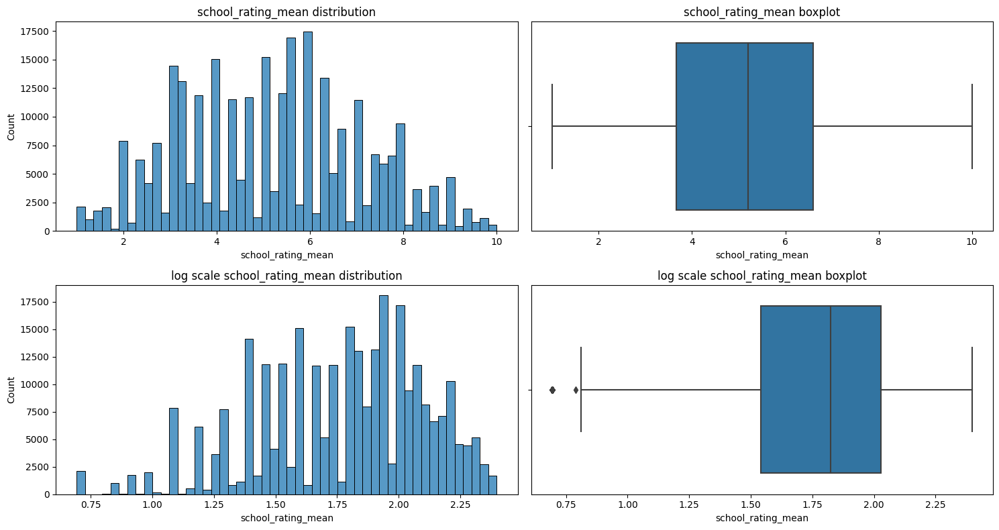

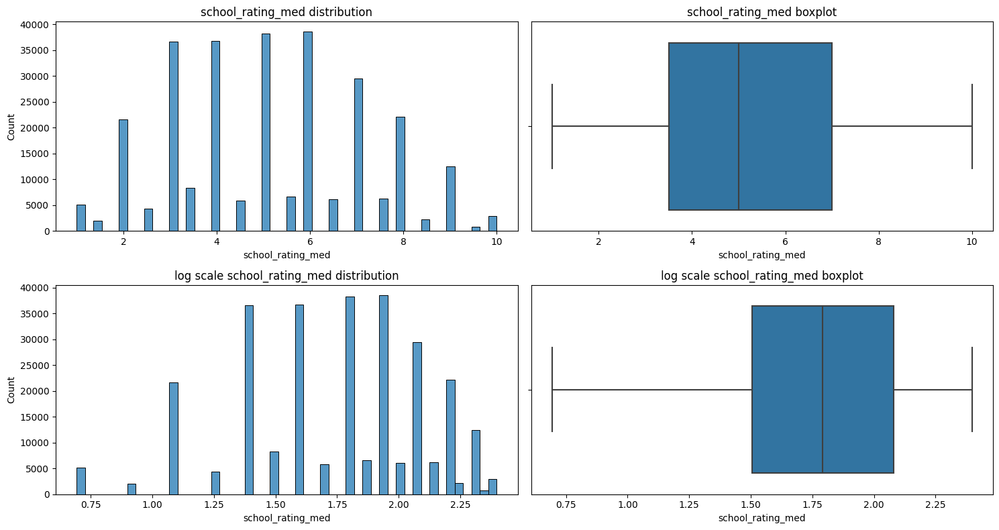

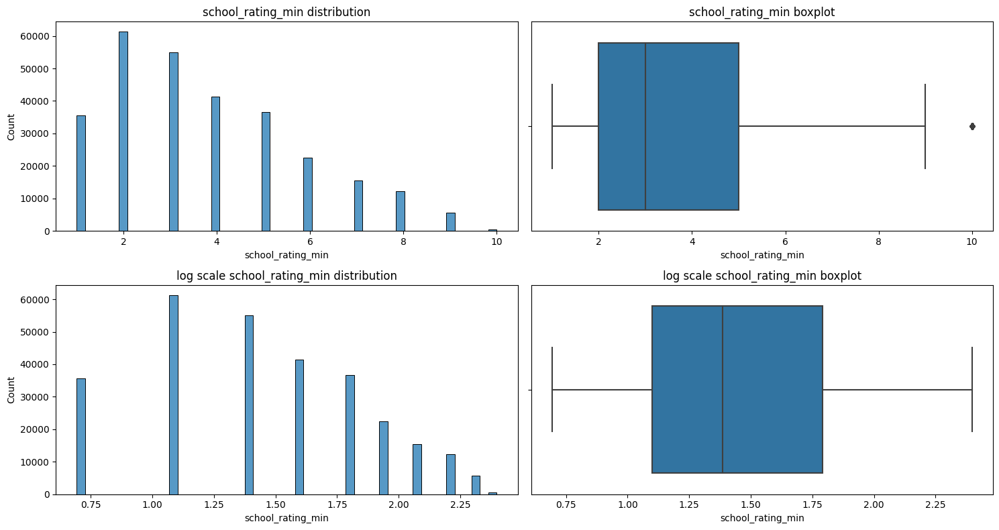

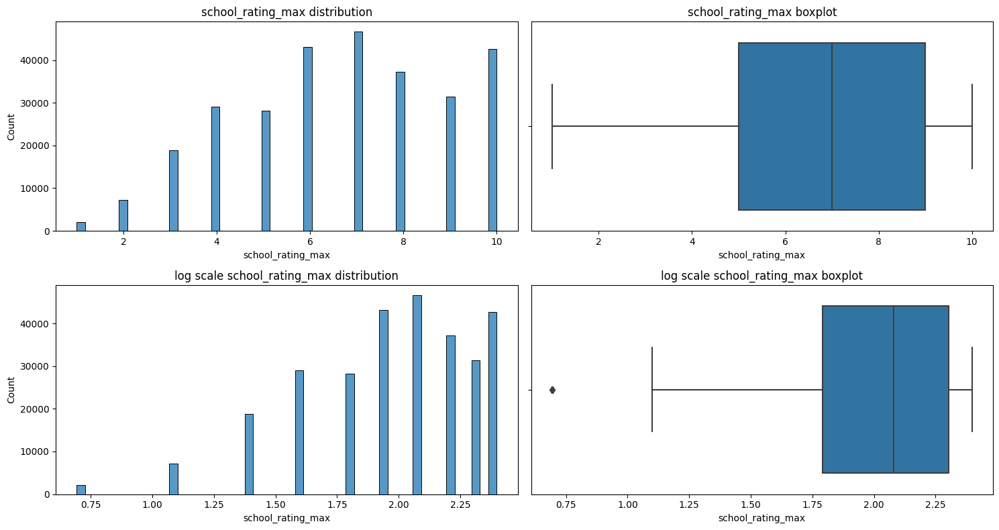

In [217]:
# look at the data
school_rat_col = ['school_rating_mean', 'school_rating_med', 'school_rating_min', 'school_rating_max']
for col in school_rat_col:
    # plot the data one more time
    distribution(data, col, n = 50, m = 1)

According to the plots, data have the same distribution on log and unlog values - use unlog values.

In [218]:
# look at the na in new columns
data[school_rat_col].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 290787 entries, 0 to 290808
Data columns (total 4 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   school_rating_mean  286391 non-null  float64
 1   school_rating_med   286391 non-null  float64
 2   school_rating_min   286391 non-null  float64
 3   school_rating_max   286391 non-null  float64
dtypes: float64(4)
memory usage: 11.1 MB


Looks like there is not so much na values in school_rating columns

In [219]:
# replace Na with median
for col in school_rat_col:
    med_val = data[col].median()
    data[col].fillna(med_val, inplace=True)

# drop school_rating column
data.drop('school_rating', axis=1, inplace=True)

#### School_distance

In [220]:
# look at the data
data['school_distance'][:10]

0            [0.8 mi, 8.3 mi, 4.2 mi, 2.0 mi]
1                    [0.7 mi, 0.4 mi, 2.2 mi]
2    [0.4 mi, 0.4 mi, 3.0 mi, 3.2 mi, 7.4 mi]
3                    [0.7 mi, 0.6 mi, 2.9 mi]
4                             [0.14mi, 0.9mi]
5                    [0.79mi, 0.66mi, 0.24mi]
6                        [0 mi, 3 mi, 2.9 mi]
7                           [31.1 mi, 1.5 mi]
8                    [0.64mi, 0.49mi, 0.86mi]
9                    [9.91mi, 0.48mi, 4.12mi]
Name: school_distance, dtype: object

In [221]:
# look at the unique values in column
# create an empty set to store unique values
unique_words = set()

# iterate over each row in the column
for row in data['school_distance']:
    # iterate over each measure in the row
    for measure in row:
        # find the data
        words = re.findall(r'\b\.?\w+\b', measure)
        # add the extracted words to the set
        unique_words.update(words)

# convert the set to a list
unique_words = list(unique_words)
unique_words

['.55mi',
 '14',
 '.5mi',
 'mi',
 '.65mi',
 '30',
 '48',
 '.8mi',
 '26',
 '.7mi',
 '112',
 '.49mi',
 '.5',
 '.33mi',
 '312',
 '.04mi',
 '.56mi',
 '.42mi',
 '.01mi',
 '29',
 '18',
 '.47mi',
 '.95mi',
 '.34mi',
 '11',
 '.24mi',
 '4',
 '24',
 '.79mi',
 '.2',
 '.4mi',
 '10',
 '25',
 '.57mi',
 '.82mi',
 '.81mi',
 '.98mi',
 '.45mi',
 '17',
 '5',
 '0',
 '.06mi',
 '8',
 '35',
 '15',
 '.64mi',
 '.03mi',
 '44',
 '34',
 '.02mi',
 '.94mi',
 '.2mi',
 '.1',
 '.18mi',
 '31',
 '.93mi',
 '.14mi',
 '.26mi',
 '.09mi',
 '13',
 '.3mi',
 '365',
 '12',
 '33',
 '.25mi',
 '.62mi',
 '40',
 '.66mi',
 '.6mi',
 '9',
 '1',
 '.51mi',
 '16',
 '.97mi',
 '.0mi',
 '.15mi',
 '41',
 '.74mi',
 '23',
 '.75mi',
 '121',
 '21',
 '.69mi',
 '7',
 '.67mi',
 '2',
 '.99mi',
 '.13mi',
 '.43mi',
 '.05mi',
 '37',
 '.91mi',
 '.19mi',
 '.61mi',
 '.08mi',
 '43',
 '.12mi',
 '39',
 '.0',
 '.29mi',
 '.86mi',
 '.21mi',
 '.6',
 '6',
 '54',
 '.85mi',
 '.41mi',
 '.37mi',
 '.83mi',
 '36',
 '.27mi',
 '46',
 '22',
 '.23mi',
 '19',
 '27',
 '.22mi',

Seems like all values are in mi, no need to convert anything

In [222]:
# add column with school distance metrics
data['school_distance_min'] = data.school_distance.apply(lambda x: distance(x, fn=min))
data['school_distance_mean'] = data.school_distance.apply(lambda x: round(distance(x, fn=np.mean), 2))
data['school_distance_max'] = data.school_distance.apply(lambda x: distance(x, fn=max))
data['school_distance_median'] = data.school_distance.apply(lambda x: round(distance(x, fn=np.median), 2))

25 percentile: 0.35, 75 percentile: 1.31, IQR: 0.9600000000000001,  Outlier borders: [-1.0900000000000003, 2.75].
Number of Tukey outliers in school_distance_min column - 24900

Outliers are detected in log scale
25 percentile: 0.30010459245033816, 75 percentile: 0.8372475245337022, IQR: 0.537142932083364,  Outlier borders: [-0.5056098056747079, 1.6429619226587482].
Number of Tukey outliers in log school_distance_min column - 11667

z score lower bound -7.805806981999677
z score upper bound 10.184813683404045
Number of z score outliers in school_distance_min column - 1579

Outliers are detected in log scale
z score lower bound -0.7594306614920425
z score upper bound 2.030952778142326
Number of z score outliers in log school_distance_min column - 4409



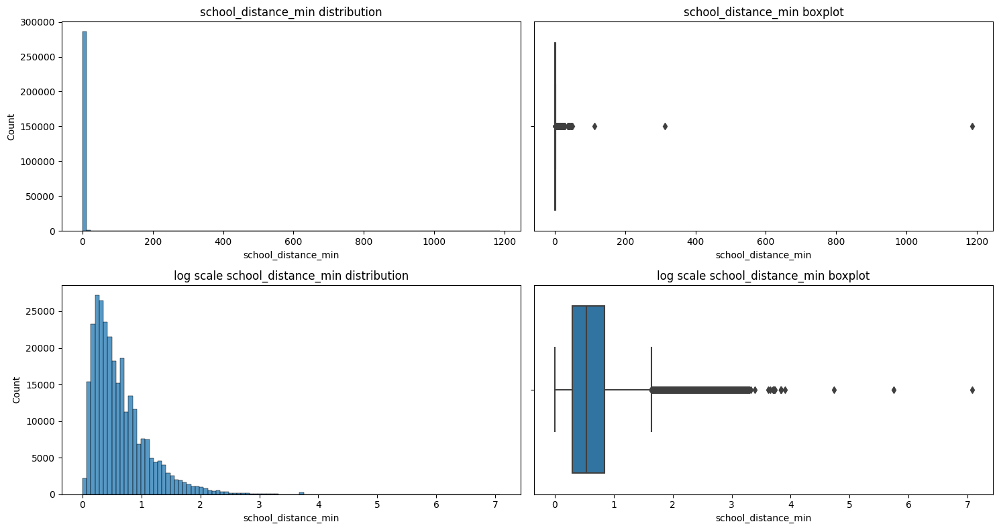

25 percentile: 1.05, 75 percentile: 3.31, IQR: 2.26,  Outlier borders: [-2.34, 6.699999999999999].
Number of Tukey outliers in school_distance_mean column - 27010

Outliers are detected in log scale
25 percentile: 0.7178397931503168, 75 percentile: 1.4609379041156565, IQR: 0.7430981109653397,  Outlier borders: [-0.3968073732976928, 2.5755850705636663].
Number of Tukey outliers in log school_distance_mean column - 6164

z score lower bound -8.737488125905568
z score upper bound 14.416807048665262
Number of z score outliers in school_distance_mean column - 2425

Outliers are detected in log scale
z score lower bound -0.6133614595680434
z score upper bound 2.89940009078947
Number of z score outliers in log school_distance_mean column - 813



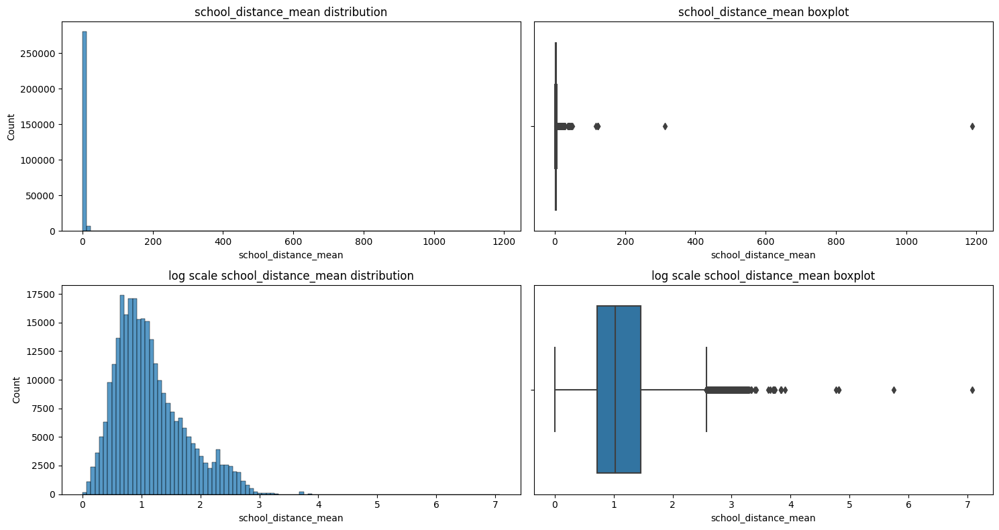

25 percentile: 1.6, 75 percentile: 5.4, IQR: 3.8000000000000003,  Outlier borders: [-4.1, 11.100000000000001].
Number of Tukey outliers in school_distance_max column - 29760

Outliers are detected in log scale
25 percentile: 0.9555114450274363, 75 percentile: 1.8562979903656263, IQR: 0.9007865453381899,  Outlier borders: [-0.3956683729798486, 3.207477808372911].
Number of Tukey outliers in log school_distance_max column - 7709

z score lower bound -14.426319102316633
z score upper bound 24.354229545918948
Number of z score outliers in school_distance_max column - 6989

Outliers are detected in log scale
z score lower bound -0.6840344208971179
z score upper bound 3.6404240682625284
Number of z score outliers in log school_distance_max column - 248



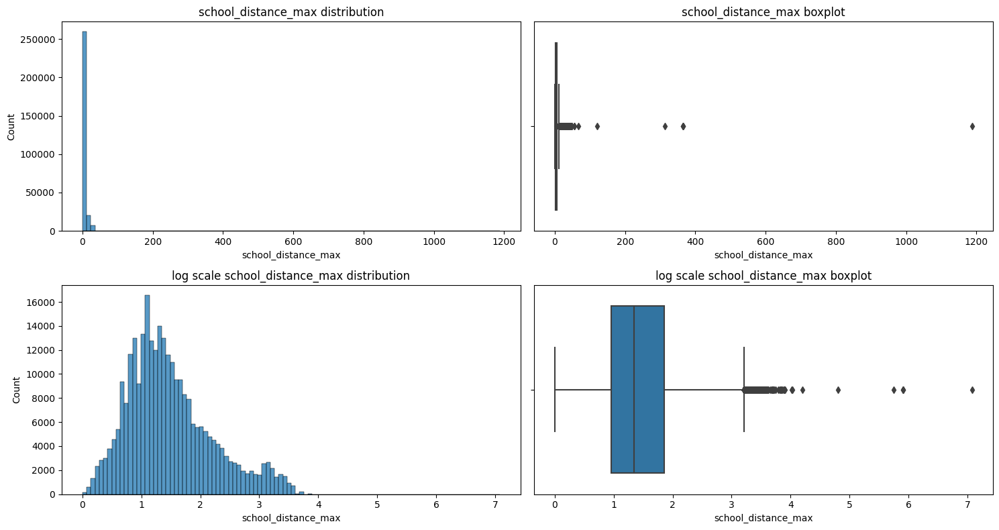

25 percentile: 0.9, 75 percentile: 2.84, IQR: 1.94,  Outlier borders: [-2.0100000000000002, 5.75].
Number of Tukey outliers in school_distance_median column - 23514

Outliers are detected in log scale
25 percentile: 0.6418538861723947, 75 percentile: 1.3454723665996355, IQR: 0.7036184804272408,  Outlier borders: [-0.41357383446846663, 2.4009000872404966].
Number of Tukey outliers in log school_distance_median column - 8098

z score lower bound -8.434464771229356
z score upper bound 13.304896252504436
Number of z score outliers in school_distance_median column - 3332

Outliers are detected in log scale
z score lower bound -0.6268880259865708
z score upper bound 2.71849940433721
Number of z score outliers in log school_distance_median column - 2907



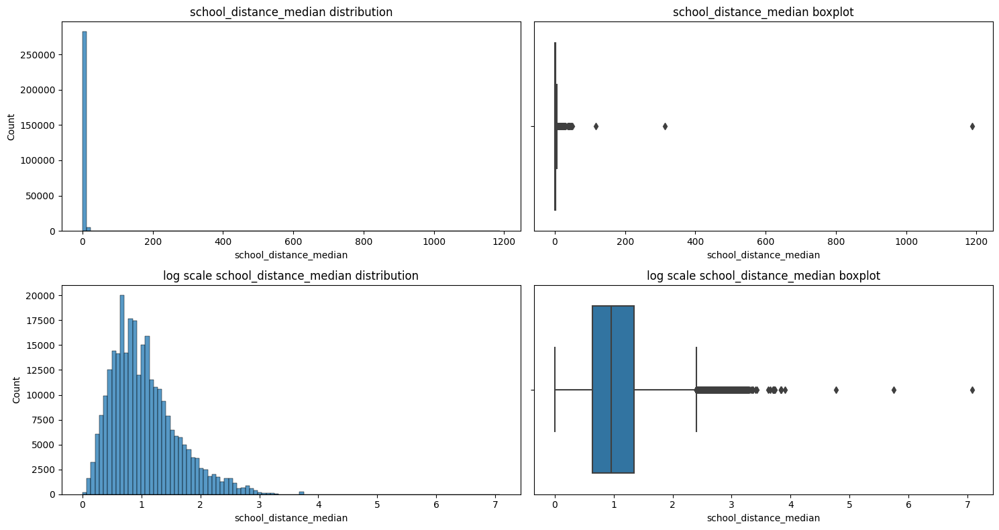

In [223]:
# look at the data distribution
dist_col = ['school_distance_min', 'school_distance_mean', 'school_distance_max', 'school_distance_median']
for col in dist_col:
    # look at the outliers
    outliers = outlier_analysis(data, col, m=1, n=100)

All the data have better distribution in log scale, all the data have right tail

In [224]:
# look at the median outliers
cols = dist_col + ['school_distance', 'distance_to_center', 'propertyType', 'sqft', 'lotsize', 'street', 'state', 'major_city']
data.loc[data.school_distance_median > 44, cols]

,school_distance_min,school_distance_mean,school_distance_max,school_distance_median,school_distance,distance_to_center,propertyType,sqft,lotsize,street,state,major_city
38242,112.370,116.820,121.260,116.820,"[121.26mi, 112.37mi]",6.990,land,NaN,190357.200,11123 Green Heron Ct,NC,durham
73511,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.690,land,NaN,NaN,4 Loma Linda Rd,TX,dell city
84614,312.400,312.570,312.700,312.600,"[312.7 mi, 312.4 mi, 312.6 mi]",314.160,"low rise, detached",6000.000,6403320.000,73 Park Rd,TX,falcon heights
90665,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.690,land,NaN,220413.600,8 Loma Linda Rd,TX,dell city
118050,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.690,detached,900.000,226076.400,10 Loma Linda Rd,TX,dell city
137847,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.690,land,NaN,223462.800,6 Loma Linda Rd,TX,dell city
142635,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.690,land,NaN,220413.600,7 Loma Linda Rd,TX,dell city
189044,1187.140,1187.510,1187.880,1187.510,"[1187.88mi, 1187.14mi]",2.160,"low rise, detached",4173.000,9589.000,5600 Pine Tree Dr,FL,miami beach
238620,48.740,48.740,48.740,48.740,"[48.74mi, 48.74mi, 48.74mi]",30.980,land,NaN,178160.400,9607 Kimberly,TX,el paso


In [225]:
# look at the median & min per city school_distance_median
median_per_city_min = data.groupby('major_city')['school_distance_median'].agg([np.median, min])
median_per_city_min.sort_values(ascending=False, by='median')[:10]

,median,min
major_city,,
falcon heights,157.050,1.500
dell city,45.130,45.130
iron station,27.700,27.700
midkiff,24.780,24.780
fort hancock,23.100,23.100
rye,20.550,20.500
middleburg,18.500,18.500
mount hamilton,18.340,2.830
chimney rock,17.350,11.250


Seems like there are some cities, which have high school_distance_median it could be if the city doesn't have school so the nearest school is in another city

In [226]:
# replace school_distance_median outliers > 30 by median per city for all cities except Falcon Heights
median_per_city = data.groupby('major_city')['school_distance_median'].median()
cond = (data['school_distance_median'] > 30) & (data['major_city'] != 'falcon heights')
data.loc[cond, 'school_distance_median'] = data.loc[cond, 'major_city'].map(median_per_city)

# Falcon Heights outlier will be replaced with min per city as median also is to high
cond = (data['school_distance_median'] > 30) & (data['major_city'] == 'falcon heights')
data.loc[cond, 'school_distance_median'] = data.loc[(data['major_city'] == 'falcon heights'), 'school_distance_median'].min()

Look at the mean distance outliers

In [227]:
cols = dist_col + ['school_distance', 'distance_to_center_log', 'distance_to_center', 'street', 'state', 'major_city']
data.loc[(data['school_distance_mean'] > 30),  cols][:10]

,school_distance_min,school_distance_mean,school_distance_max,school_distance_median,school_distance,distance_to_center_log,distance_to_center,street,state,major_city
38242,112.370,116.820,121.260,2.500,"[121.26mi, 112.37mi]",2.078,6.990,11123 Green Heron Ct,NC,durham
61155,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,2821 Maria Casas,TX,el paso
65633,36.300,36.300,36.300,1.480,"[36.3 mi, 36.3 mi, 36.3 mi]",3.465,30.980,14717 Tierra Haven Ave,TX,el paso
69678,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,12345 Desert Dove Ave,TX,el paso
69681,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14524 Dominic Azcarate Dr,TX,el paso
71646,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14704 Tierra Escape Ave,TX,el paso
73008,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14936 Tierra Haven Ave,TX,el paso
73511,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.525,0.690,4 Loma Linda Rd,TX,dell city
75264,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,2844 Tierra Oasis,TX,el paso
75988,39.690,39.690,39.690,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14928 Tierra Haven Ave,TX,el paso


In [228]:
# look at the median & min per city school_distance_mean
median_per_city_mean = data.groupby('major_city')['school_distance_mean'].agg([np.median, min])
median_per_city_mean.sort_values(ascending=False, by='median')[:10]

,median,min
major_city,,
falcon heights,157.025,1.480
dell city,45.130,45.130
iron station,27.240,27.240
midkiff,24.660,24.660
fort hancock,23.100,23.100
rye,19.500,18.400
elmo,18.900,18.900
mount hamilton,18.350,2.790
chimney rock,15.850,10.470


In [229]:
# replace school_distance_mean outliers > 30 by median value per city for all cities except Falcon Heights
median_mean_per_city = data.groupby('major_city')['school_distance_mean'].median()
cond = (data['school_distance_mean'] > 30) & (data['major_city'] != 'falcon heights')
data.loc[cond, 'school_distance_mean'] = data.loc[cond, 'major_city'].map(median_mean_per_city)

# Falcon Heights outlier will be replaced with mean per city as median also is to high
cond = (data['school_distance_mean'] > 30) & (data['major_city'] == 'falcon heights')
data.loc[cond, 'school_distance_mean'] = data.loc[(data['major_city'] == 'falcon heights'), 'school_distance_mean'].min()

Look at the max distance outliers

In [230]:
cols = dist_col + ['school_distance', 'distance_to_center_log', 'school_grades', 'distance_to_center', 'street', 'state', 'major_city']
data.loc[(data['school_distance_max'] > 30), cols][:10]

,school_distance_min,school_distance_mean,school_distance_max,school_distance_median,school_distance,distance_to_center_log,school_grades,distance_to_center,street,state,major_city
7,1.500,16.300,31.100,16.300,"[31.1 mi, 1.5 mi]",0.806,"[PK-8, 9-12]",1.240,3750 NE 170th St APT 407,FL,north miami beach
303,0.400,13.320,33.900,2.000,"[1.9 mi, 33.9 mi, 28.4 mi, 0.4 mi, 2.0 mi]",2.645,"[Preschool to 5, Preschool to 8, K to 9, 6 to ...",13.090,21241 NE 3rd Ct,FL,miami
344,1.200,15.800,30.400,15.800,"[30.4 mi, 1.2 mi]",2.645,"[PK-8, 9-12]",13.090,20120 NE 2nd Ave APT W19,FL,miami
449,0.900,13.780,35.000,2.300,"[0.9 mi, 35.0 mi, 29.7 mi, 1.0 mi, 2.3 mi]",2.671,"[Preschool to 8, Preschool to 8, K to 9, 6 to ...",13.450,20301 W Country Club Dr #1428,FL,miami
471,0.300,13.300,30.300,5.900,"[0.3 mi, 30.3 mi, 25.2 mi, 4.8 mi, 5.9 mi]",1.978,"[Preschool to 8, Preschool to 8, K to 9, 6 to ...",6.230,Undisclosed Address,FL,miami beach
616,0.600,12.520,32.800,1.300,"[0.7 mi, 32.8 mi, 27.2 mi, 1.3 mi, 0.6 mi]",2.547,"[Preschool to 5, Preschool to 8, K to 9, 6 to ...",11.770,972 NW 204th St,FL,miami
753,0.930,14.290,35.110,3.300,"[0.93mi, 2.21mi, 35.11mi, 29.89mi, 3.3mi]",0.806,"[PK-8, 6-8, PK-8, K-9, 9-12]",1.240,125 Ocean Blvd,FL,north miami beach
759,1.350,13.680,34.070,2.620,"[1.55mi, 1.35mi, 34.07mi, 2.62mi, 28.8mi]",2.671,"[PK-8, 6-8, PK-8, 9-12, K-9]",13.450,3131 NE 188th St #2702,FL,miami
876,1.700,16.500,31.300,16.500,"[31.3 mi, 1.7 mi]",0.806,"[PK-8, 9-12]",1.240,17125 N Bay Rd APT 3310,FL,north miami beach
880,0.770,12.930,33.410,1.330,"[0.77mi, 1.29mi, 1.33mi, 33.41mi, 27.83mi]",2.547,"[6-8, 9-12, PK-5, PK-8, K-9]",11.770,475 NW 210th St #205,FL,miami


In [231]:
# look at the median & min per city school_distance_max
median_per_city_max = data.groupby('major_city')['school_distance_max'].agg([np.median, min])
median_per_city_max.sort_values(ascending=False, by='median')[:10]

,median,min
major_city,,
falcon heights,157.300,1.900
dell city,45.130,45.130
elmo,44.600,44.600
north miami beach,33.300,1.400
miami gardens,30.260,27.500
opa locka,28.000,25.500
iron station,27.870,27.870
miami beach,26.600,0.800
midkiff,26.470,26.470


In [232]:
# replace school_distance_max outliers > 30 by median value per city for all cities except Falcon Heights
median_max_per_city = data.groupby('major_city')['school_distance_max'].median()
cond = (data['school_distance_max'] > 30) & (data['major_city'] != 'falcon heights')
data.loc[cond, 'school_distance_max'] = data.loc[cond, 'major_city'].map(median_max_per_city)

# Falcon Heights outlier will be replaced with min per city as median also is to high
cond = (data['school_distance_max'] > 30) & (data['major_city'] == 'falcon heights')
data.loc[cond, 'school_distance_max'] = data.loc[(data['major_city'] == 'falcon heights'), 'school_distance_max'].min()

Look at the min distance outliers

In [233]:
cols = dist_col + ['school_distance', 'distance_to_center_log', 'distance_to_center', 'street', 'state', 'major_city']
data.loc[(data['school_distance_min'] > 30), cols][:10]

,school_distance_min,school_distance_mean,school_distance_max,school_distance_median,school_distance,distance_to_center_log,distance_to_center,street,state,major_city
38242,112.370,2.480,3.780,2.500,"[121.26mi, 112.37mi]",2.078,6.990,11123 Green Heron Ct,NC,durham
61155,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,2821 Maria Casas,TX,el paso
65633,36.300,1.470,1.990,1.480,"[36.3 mi, 36.3 mi, 36.3 mi]",3.465,30.980,14717 Tierra Haven Ave,TX,el paso
69678,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,12345 Desert Dove Ave,TX,el paso
69681,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14524 Dominic Azcarate Dr,TX,el paso
71646,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14704 Tierra Escape Ave,TX,el paso
73008,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14936 Tierra Haven Ave,TX,el paso
73511,45.130,45.130,45.130,45.130,"[45.13mi, 45.13mi, 45.13mi]",0.525,0.690,4 Loma Linda Rd,TX,dell city
75264,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,2844 Tierra Oasis,TX,el paso
75988,39.690,1.470,1.990,1.480,"[39.69mi, 39.69mi, 39.69mi]",3.465,30.980,14928 Tierra Haven Ave,TX,el paso


In [234]:
# look at the median & min per city school_distance_min
median_per_city_min = data.groupby('major_city')['school_distance_min'].agg([np.median, min])
median_per_city_min.sort_values(ascending=False, by='median')[:10]

,median,min
major_city,,
falcon heights,156.700,1.000
dell city,45.130,45.130
iron station,26.160,26.160
fort hancock,23.100,23.100
midkiff,22.590,22.590
mount hamilton,17.930,2.320
rye,17.300,14.000
rockwell,13.700,13.100
la pine,13.400,13.400


In [235]:
# replace school_distance_min outliers > 30 by median value per city for all cities except Falcon Heights
median_min_per_city = data.groupby('major_city')['school_distance_min'].median()
cond = (data['school_distance_min'] > 30) & (data['major_city'] != 'falcon heights')
data.loc[cond, 'school_distance_min'] = data.loc[cond, 'major_city'].map(median_min_per_city)

# Falcon Heights outlier will be replaced with min per city as median also is to high
cond = (data['school_distance_min'] > 30) & (data['major_city'] == 'falcon heights')
data.loc[cond, 'school_distance_min'] = data.loc[(data['major_city'] == 'falcon heights'), 'school_distance_min'].min()

Replace Nan's in school_distance column by median

In [236]:
data.school_distance_min.fillna(data.school_distance_min.median(), inplace=True)
data.school_distance_max.fillna(data.school_distance_max.median(), inplace=True)
data.school_distance_mean.fillna(data.school_distance_mean.median(), inplace=True)
data.school_distance_median.fillna(data.school_distance_median.median(), inplace=True)

In [237]:
for col in dist_col:
    data[col+'_log'] = np.log(data[col]+1)

#### School_name

In [238]:
data['school_number_name'] = data.school_name.apply(lambda x: len(x) if x else 0)
data['school_number_name'].describe()

count   290787.000
mean         4.318
std          4.515
min          0.000
25%          3.000
50%          3.000
75%          5.000
max         65.000
Name: school_number_name, dtype: float64

25 percentile: 3.0, 75 percentile: 5.0, IQR: 2.0,  Outlier borders: [0.0, 8.0].
Number of Tukey outliers in school_number_name column - 9229

Outliers are detected in log scale
25 percentile: 1.3862943611198906, 75 percentile: 1.791759469228055, IQR: 0.4054651081081644,  Outlier borders: [0.778096698957644, 2.3999571313903014].
Number of Tukey outliers in log school_number_name column - 19744

z score lower bound -9.227348371874204
z score upper bound 17.86409623199175
Number of z score outliers in school_number_name column - 4844

Outliers are detected in log scale
z score lower bound 0.13277414885691186
z score upper bound 2.9316536476195605
Number of z score outliers in log school_number_name column - 8527



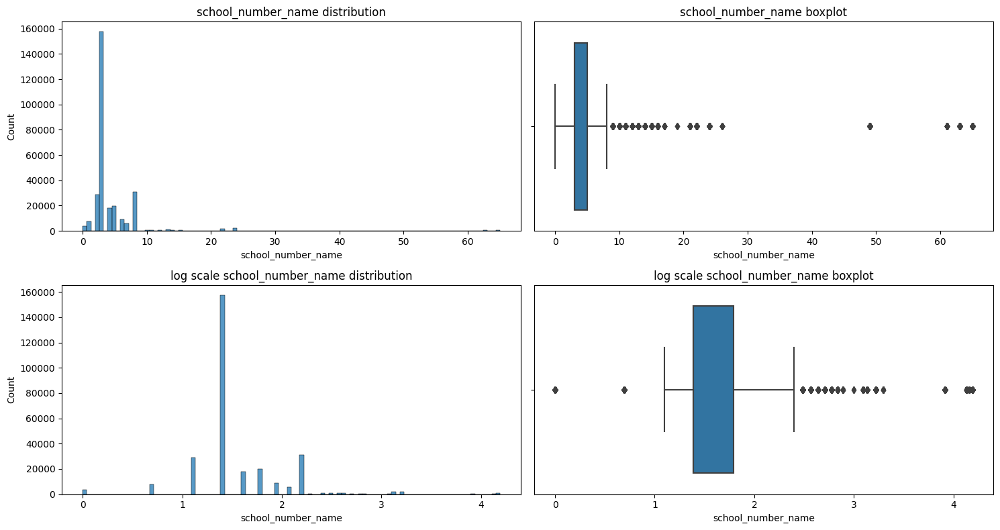

In [239]:
# look at the outliers
col = 'school_number_name'
outliers = outlier_analysis(data, col, m=1, n=100)

In [240]:
# save the data
data.to_csv('./feature_data_new.csv', index=False)

# read the data
# data = pd.read_csv('./feature_data_new.csv')